# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

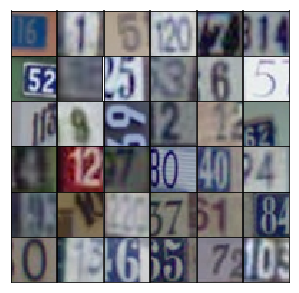

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        
        # First convolutional layer.
        # 4x4x512
        x1 = tf.reshape(x1, [-1, 4, 4, 512])
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha*x1, x1)
        
        # Second convolutional layer.
        # 8x8x256
        x2 = tf.layers.conv2d_transpose(x1, 256, [5,5], [2,2], 'same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha*x2, x2)
        
        # Third convolutional layer.
        # 16x16x128
        x3 = tf.layers.conv2d_transpose(x2, 128, [5,5], [2,2], 'same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha*x3, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, [5,5], [2,2], 'same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        c1 = tf.layers.conv2d(x, 64, 5, 2, 'same')
        c1 = tf.maximum(alpha*c1, c1)
       
        # Input layer is 16x16x64
        c2 = tf.layers.conv2d(c1, 128, 5, 2, 'same')
        c2 = tf.layers.batch_normalization(c2, training=True)
        c2 = tf.maximum(alpha*c2, c2)
        
        # Input layer is 8x8x128
        c3 = tf.layers.conv2d(c2, 256, 5, 2, 'same')
        c3 = tf.layers.batch_normalization(c3, training=True)
        c3 = tf.maximum(alpha*c3, c3)
        
        # Input layer is 4x4x256
        c3_flat = tf.reshape(c3, [-1, 4*4*256])
#         dense_layer = tf.layers.dense(c3_flat, 1024)
#         dense_layer = tf.layers.batch_normalization(dense_layer, training=True)
#         dense_layer = tf.maximum(alpha*dense_layer, dense_layer)
        
        logits = tf.layers.dense(c3_flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.9186... Generator Loss: 0.4009
Epoch 1/25... Discriminator Loss: 0.3172... Generator Loss: 2.3590
Epoch 1/25... Discriminator Loss: 0.2012... Generator Loss: 2.1460
Epoch 1/25... Discriminator Loss: 0.1570... Generator Loss: 2.7736
Epoch 1/25... Discriminator Loss: 0.1372... Generator Loss: 2.7862
Epoch 1/25... Discriminator Loss: 0.0820... Generator Loss: 3.3221
Epoch 1/25... Discriminator Loss: 0.0906... Generator Loss: 3.4381
Epoch 1/25... Discriminator Loss: 0.1503... Generator Loss: 2.7813
Epoch 1/25... Discriminator Loss: 0.1235... Generator Loss: 2.8277
Epoch 1/25... Discriminator Loss: 0.2365... Generator Loss: 2.1639


/home/hasush/pythonEnvs/tensorflow/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


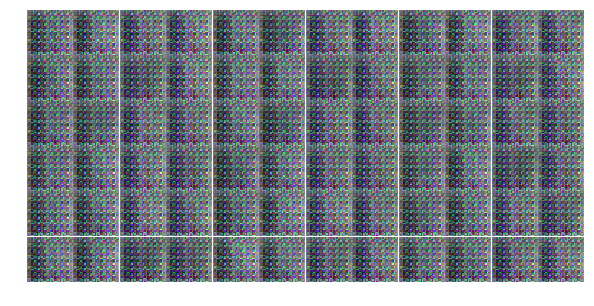

Epoch 1/25... Discriminator Loss: 0.2645... Generator Loss: 3.7365
Epoch 1/25... Discriminator Loss: 0.6121... Generator Loss: 1.4599
Epoch 1/25... Discriminator Loss: 0.6248... Generator Loss: 2.2393
Epoch 1/25... Discriminator Loss: 0.4234... Generator Loss: 2.9110
Epoch 1/25... Discriminator Loss: 0.5289... Generator Loss: 1.9734
Epoch 1/25... Discriminator Loss: 0.5558... Generator Loss: 2.5192
Epoch 1/25... Discriminator Loss: 0.5405... Generator Loss: 1.4280
Epoch 1/25... Discriminator Loss: 0.4650... Generator Loss: 1.6996
Epoch 1/25... Discriminator Loss: 0.6363... Generator Loss: 1.7104
Epoch 1/25... Discriminator Loss: 0.2739... Generator Loss: 2.6061


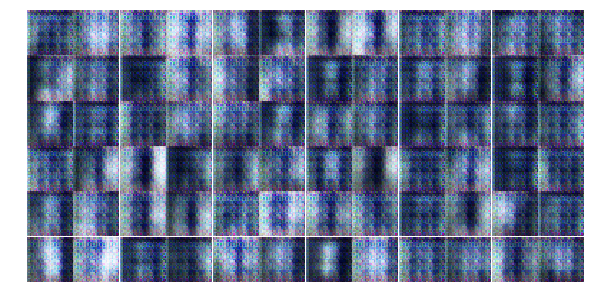

Epoch 1/25... Discriminator Loss: 0.3336... Generator Loss: 1.8109
Epoch 1/25... Discriminator Loss: 0.2957... Generator Loss: 1.7008
Epoch 1/25... Discriminator Loss: 0.5403... Generator Loss: 1.7069
Epoch 1/25... Discriminator Loss: 1.5656... Generator Loss: 5.9391
Epoch 1/25... Discriminator Loss: 0.3635... Generator Loss: 3.2289
Epoch 1/25... Discriminator Loss: 0.8569... Generator Loss: 2.1749
Epoch 1/25... Discriminator Loss: 0.2235... Generator Loss: 2.1948
Epoch 1/25... Discriminator Loss: 0.1773... Generator Loss: 3.0777
Epoch 1/25... Discriminator Loss: 1.1661... Generator Loss: 3.8495
Epoch 1/25... Discriminator Loss: 0.3777... Generator Loss: 3.3298


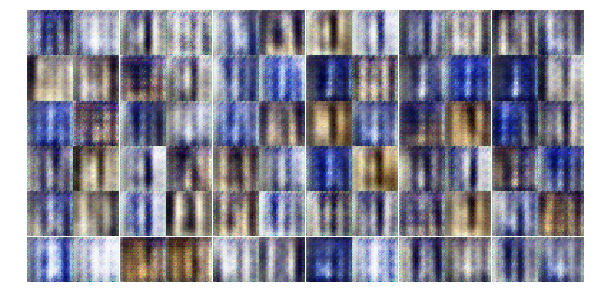

Epoch 1/25... Discriminator Loss: 0.4817... Generator Loss: 1.5900
Epoch 1/25... Discriminator Loss: 0.3145... Generator Loss: 1.6497
Epoch 1/25... Discriminator Loss: 0.5394... Generator Loss: 1.2031
Epoch 1/25... Discriminator Loss: 0.5288... Generator Loss: 1.2874
Epoch 1/25... Discriminator Loss: 0.8249... Generator Loss: 0.8646
Epoch 1/25... Discriminator Loss: 0.6945... Generator Loss: 1.4147
Epoch 1/25... Discriminator Loss: 0.3953... Generator Loss: 1.6347
Epoch 1/25... Discriminator Loss: 0.2150... Generator Loss: 2.9341
Epoch 1/25... Discriminator Loss: 0.3885... Generator Loss: 1.4554
Epoch 1/25... Discriminator Loss: 0.3297... Generator Loss: 2.5819


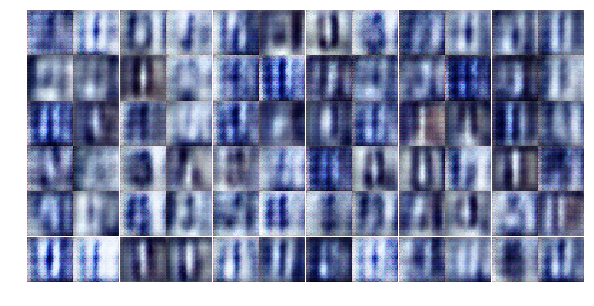

Epoch 1/25... Discriminator Loss: 0.4116... Generator Loss: 1.9730
Epoch 1/25... Discriminator Loss: 0.8406... Generator Loss: 0.7870
Epoch 1/25... Discriminator Loss: 0.8760... Generator Loss: 1.2257
Epoch 1/25... Discriminator Loss: 0.8129... Generator Loss: 2.2834
Epoch 1/25... Discriminator Loss: 0.8542... Generator Loss: 1.0371
Epoch 1/25... Discriminator Loss: 0.6094... Generator Loss: 1.8486
Epoch 1/25... Discriminator Loss: 0.4311... Generator Loss: 2.0927
Epoch 1/25... Discriminator Loss: 1.1037... Generator Loss: 0.8174
Epoch 1/25... Discriminator Loss: 0.9270... Generator Loss: 1.5044
Epoch 1/25... Discriminator Loss: 0.8745... Generator Loss: 1.2486


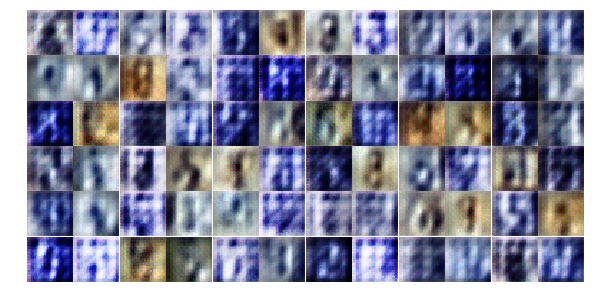

Epoch 1/25... Discriminator Loss: 0.6504... Generator Loss: 1.3162
Epoch 1/25... Discriminator Loss: 0.7107... Generator Loss: 1.6109
Epoch 1/25... Discriminator Loss: 0.5834... Generator Loss: 1.6693
Epoch 1/25... Discriminator Loss: 0.6649... Generator Loss: 1.2282
Epoch 1/25... Discriminator Loss: 0.7370... Generator Loss: 1.3685
Epoch 1/25... Discriminator Loss: 0.8297... Generator Loss: 1.1150
Epoch 1/25... Discriminator Loss: 0.5712... Generator Loss: 1.6655
Epoch 2/25... Discriminator Loss: 0.7047... Generator Loss: 1.8322
Epoch 2/25... Discriminator Loss: 0.6235... Generator Loss: 1.9027
Epoch 2/25... Discriminator Loss: 0.9835... Generator Loss: 0.7540


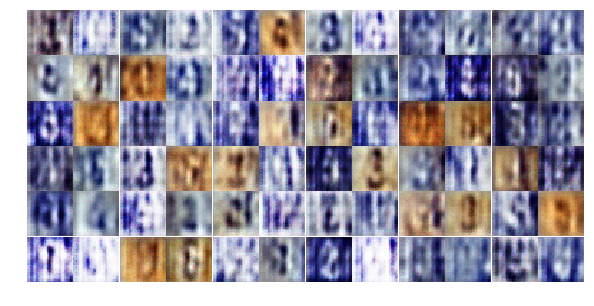

Epoch 2/25... Discriminator Loss: 0.9113... Generator Loss: 1.3600
Epoch 2/25... Discriminator Loss: 0.4831... Generator Loss: 1.5613
Epoch 2/25... Discriminator Loss: 1.1794... Generator Loss: 0.7373
Epoch 2/25... Discriminator Loss: 1.0473... Generator Loss: 1.2751
Epoch 2/25... Discriminator Loss: 1.2998... Generator Loss: 0.8498
Epoch 2/25... Discriminator Loss: 1.0367... Generator Loss: 1.3074
Epoch 2/25... Discriminator Loss: 0.7568... Generator Loss: 1.2654
Epoch 2/25... Discriminator Loss: 0.6287... Generator Loss: 1.2846
Epoch 2/25... Discriminator Loss: 0.9673... Generator Loss: 0.8792
Epoch 2/25... Discriminator Loss: 0.9040... Generator Loss: 0.9472


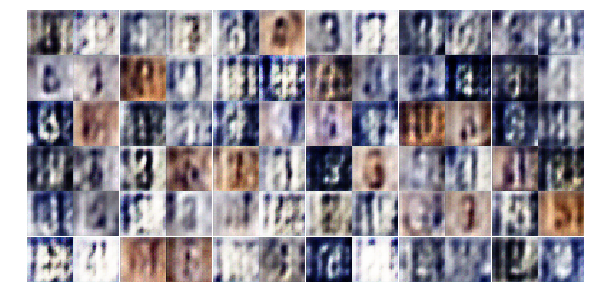

Epoch 2/25... Discriminator Loss: 0.8952... Generator Loss: 1.0941
Epoch 2/25... Discriminator Loss: 0.5764... Generator Loss: 1.5554
Epoch 2/25... Discriminator Loss: 1.0622... Generator Loss: 0.7692
Epoch 2/25... Discriminator Loss: 1.0076... Generator Loss: 1.0402
Epoch 2/25... Discriminator Loss: 0.6499... Generator Loss: 1.5608
Epoch 2/25... Discriminator Loss: 0.8950... Generator Loss: 1.2731
Epoch 2/25... Discriminator Loss: 1.3984... Generator Loss: 0.8032
Epoch 2/25... Discriminator Loss: 0.8389... Generator Loss: 1.2000
Epoch 2/25... Discriminator Loss: 1.3086... Generator Loss: 0.6436
Epoch 2/25... Discriminator Loss: 1.2442... Generator Loss: 0.7972


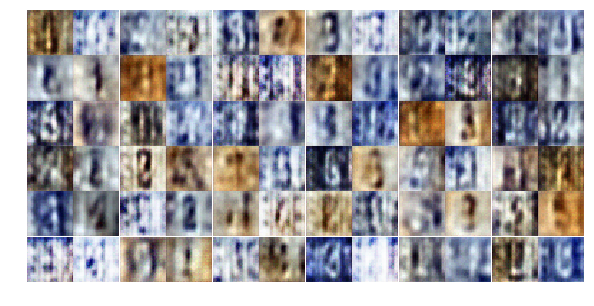

Epoch 2/25... Discriminator Loss: 1.0493... Generator Loss: 0.7019
Epoch 2/25... Discriminator Loss: 0.7369... Generator Loss: 1.6448
Epoch 2/25... Discriminator Loss: 0.8260... Generator Loss: 1.1944
Epoch 2/25... Discriminator Loss: 0.9899... Generator Loss: 0.8479
Epoch 2/25... Discriminator Loss: 0.8622... Generator Loss: 1.3756
Epoch 2/25... Discriminator Loss: 0.6747... Generator Loss: 1.5816
Epoch 2/25... Discriminator Loss: 1.0718... Generator Loss: 0.8288
Epoch 2/25... Discriminator Loss: 1.2787... Generator Loss: 0.6101
Epoch 2/25... Discriminator Loss: 1.0737... Generator Loss: 1.0198
Epoch 2/25... Discriminator Loss: 0.8328... Generator Loss: 1.3128


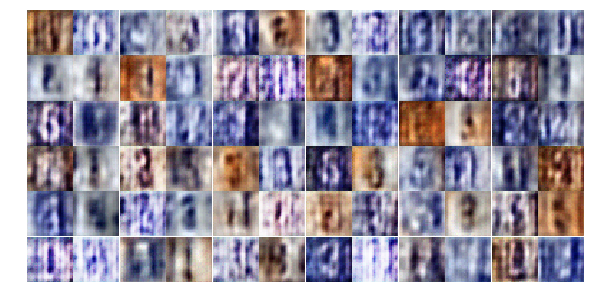

Epoch 2/25... Discriminator Loss: 1.1093... Generator Loss: 0.9476
Epoch 2/25... Discriminator Loss: 1.2946... Generator Loss: 1.0486
Epoch 2/25... Discriminator Loss: 1.2496... Generator Loss: 0.6712
Epoch 2/25... Discriminator Loss: 1.3018... Generator Loss: 0.6339
Epoch 2/25... Discriminator Loss: 0.9802... Generator Loss: 1.2279
Epoch 2/25... Discriminator Loss: 1.1567... Generator Loss: 0.9993
Epoch 2/25... Discriminator Loss: 1.0420... Generator Loss: 0.8737
Epoch 2/25... Discriminator Loss: 0.7246... Generator Loss: 1.3571
Epoch 2/25... Discriminator Loss: 1.2880... Generator Loss: 0.6551
Epoch 2/25... Discriminator Loss: 1.1527... Generator Loss: 1.3064


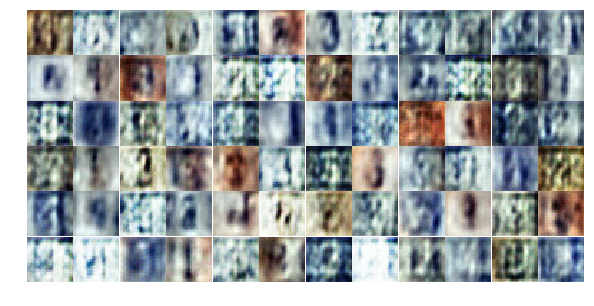

Epoch 2/25... Discriminator Loss: 1.0437... Generator Loss: 1.3859
Epoch 2/25... Discriminator Loss: 1.0339... Generator Loss: 1.2937
Epoch 2/25... Discriminator Loss: 1.1877... Generator Loss: 0.7143
Epoch 2/25... Discriminator Loss: 1.1355... Generator Loss: 0.9378
Epoch 2/25... Discriminator Loss: 1.1545... Generator Loss: 1.0108
Epoch 2/25... Discriminator Loss: 1.1703... Generator Loss: 0.6484
Epoch 2/25... Discriminator Loss: 0.6885... Generator Loss: 1.3545
Epoch 2/25... Discriminator Loss: 0.7832... Generator Loss: 1.3189
Epoch 2/25... Discriminator Loss: 0.8557... Generator Loss: 0.8870
Epoch 2/25... Discriminator Loss: 0.6341... Generator Loss: 1.6050


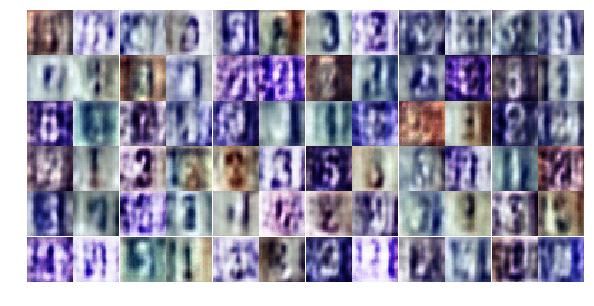

Epoch 2/25... Discriminator Loss: 0.9357... Generator Loss: 1.1987
Epoch 2/25... Discriminator Loss: 1.1564... Generator Loss: 0.6264
Epoch 2/25... Discriminator Loss: 1.4294... Generator Loss: 0.4044
Epoch 2/25... Discriminator Loss: 0.8885... Generator Loss: 1.1196
Epoch 3/25... Discriminator Loss: 0.8522... Generator Loss: 1.6252
Epoch 3/25... Discriminator Loss: 0.7682... Generator Loss: 1.4724
Epoch 3/25... Discriminator Loss: 0.7612... Generator Loss: 1.4554
Epoch 3/25... Discriminator Loss: 1.0794... Generator Loss: 0.8242
Epoch 3/25... Discriminator Loss: 0.8273... Generator Loss: 2.2709
Epoch 3/25... Discriminator Loss: 0.7381... Generator Loss: 1.3836


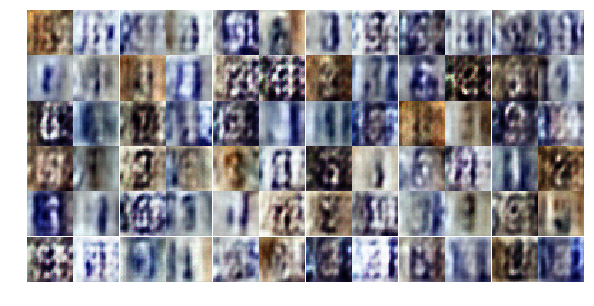

Epoch 3/25... Discriminator Loss: 0.7635... Generator Loss: 1.8280
Epoch 3/25... Discriminator Loss: 0.7629... Generator Loss: 1.3649
Epoch 3/25... Discriminator Loss: 0.6559... Generator Loss: 1.5466
Epoch 3/25... Discriminator Loss: 0.6640... Generator Loss: 1.8097
Epoch 3/25... Discriminator Loss: 0.7974... Generator Loss: 0.9298
Epoch 3/25... Discriminator Loss: 0.6194... Generator Loss: 1.3740
Epoch 3/25... Discriminator Loss: 0.5848... Generator Loss: 1.4857
Epoch 3/25... Discriminator Loss: 0.5423... Generator Loss: 1.7183
Epoch 3/25... Discriminator Loss: 0.6155... Generator Loss: 1.2989
Epoch 3/25... Discriminator Loss: 1.1209... Generator Loss: 0.7702


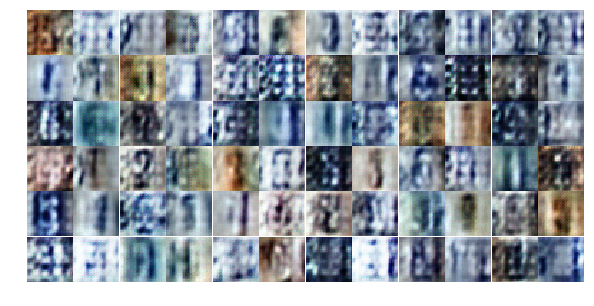

Epoch 3/25... Discriminator Loss: 0.4717... Generator Loss: 1.6125
Epoch 3/25... Discriminator Loss: 0.6989... Generator Loss: 1.4001
Epoch 3/25... Discriminator Loss: 0.7837... Generator Loss: 1.5728
Epoch 3/25... Discriminator Loss: 0.9849... Generator Loss: 1.6336
Epoch 3/25... Discriminator Loss: 0.7935... Generator Loss: 1.0654
Epoch 3/25... Discriminator Loss: 0.3743... Generator Loss: 1.7576
Epoch 3/25... Discriminator Loss: 1.1124... Generator Loss: 0.5398
Epoch 3/25... Discriminator Loss: 0.5598... Generator Loss: 1.5069
Epoch 3/25... Discriminator Loss: 0.5340... Generator Loss: 1.6611
Epoch 3/25... Discriminator Loss: 0.9506... Generator Loss: 0.7873


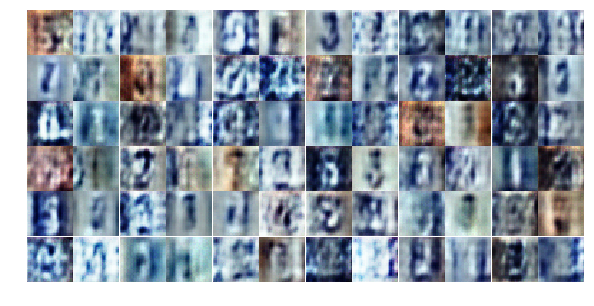

Epoch 3/25... Discriminator Loss: 0.7456... Generator Loss: 1.5652
Epoch 3/25... Discriminator Loss: 0.5898... Generator Loss: 1.8073
Epoch 3/25... Discriminator Loss: 0.7450... Generator Loss: 2.5951
Epoch 3/25... Discriminator Loss: 0.7412... Generator Loss: 1.0564
Epoch 3/25... Discriminator Loss: 0.5891... Generator Loss: 2.4080
Epoch 3/25... Discriminator Loss: 0.9699... Generator Loss: 0.7123
Epoch 3/25... Discriminator Loss: 0.5927... Generator Loss: 1.5611
Epoch 3/25... Discriminator Loss: 0.8138... Generator Loss: 1.0418
Epoch 3/25... Discriminator Loss: 0.4311... Generator Loss: 2.1131
Epoch 3/25... Discriminator Loss: 0.7005... Generator Loss: 0.9975


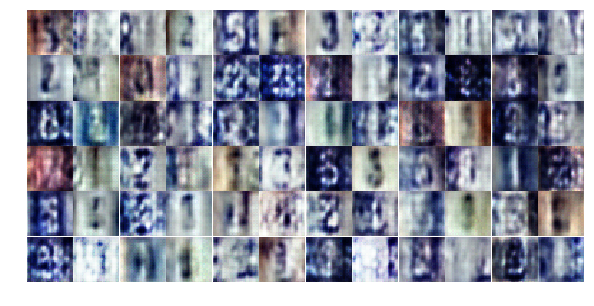

Epoch 3/25... Discriminator Loss: 0.7549... Generator Loss: 2.1578
Epoch 3/25... Discriminator Loss: 0.6504... Generator Loss: 1.2077
Epoch 3/25... Discriminator Loss: 0.4682... Generator Loss: 1.9583
Epoch 3/25... Discriminator Loss: 0.7543... Generator Loss: 2.2314
Epoch 3/25... Discriminator Loss: 0.3587... Generator Loss: 2.4343
Epoch 3/25... Discriminator Loss: 0.6898... Generator Loss: 2.8438
Epoch 3/25... Discriminator Loss: 0.6517... Generator Loss: 3.5225
Epoch 3/25... Discriminator Loss: 0.8202... Generator Loss: 0.8829
Epoch 3/25... Discriminator Loss: 0.7517... Generator Loss: 1.0730
Epoch 3/25... Discriminator Loss: 0.5960... Generator Loss: 2.1896


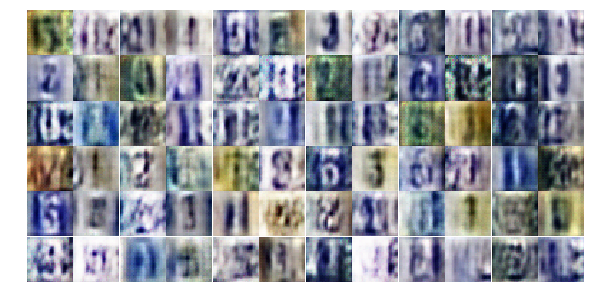

Epoch 3/25... Discriminator Loss: 0.6468... Generator Loss: 1.3765
Epoch 3/25... Discriminator Loss: 0.6837... Generator Loss: 1.3289
Epoch 3/25... Discriminator Loss: 0.8342... Generator Loss: 0.8201
Epoch 3/25... Discriminator Loss: 0.7057... Generator Loss: 1.7250
Epoch 3/25... Discriminator Loss: 0.9748... Generator Loss: 2.3416
Epoch 3/25... Discriminator Loss: 0.5589... Generator Loss: 1.7345
Epoch 3/25... Discriminator Loss: 0.4045... Generator Loss: 1.9449
Epoch 3/25... Discriminator Loss: 0.4618... Generator Loss: 1.7335
Epoch 3/25... Discriminator Loss: 0.4254... Generator Loss: 1.7416
Epoch 3/25... Discriminator Loss: 0.7054... Generator Loss: 0.9428


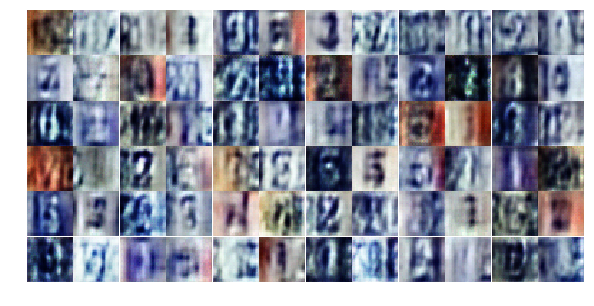

Epoch 3/25... Discriminator Loss: 1.0647... Generator Loss: 0.6011
Epoch 4/25... Discriminator Loss: 1.0231... Generator Loss: 0.6598
Epoch 4/25... Discriminator Loss: 0.7158... Generator Loss: 1.3510
Epoch 4/25... Discriminator Loss: 0.9481... Generator Loss: 0.7275
Epoch 4/25... Discriminator Loss: 0.7384... Generator Loss: 2.5191
Epoch 4/25... Discriminator Loss: 0.4424... Generator Loss: 1.9544
Epoch 4/25... Discriminator Loss: 0.5642... Generator Loss: 1.5445
Epoch 4/25... Discriminator Loss: 0.7006... Generator Loss: 0.9839
Epoch 4/25... Discriminator Loss: 0.4081... Generator Loss: 1.5102
Epoch 4/25... Discriminator Loss: 0.5584... Generator Loss: 1.6744


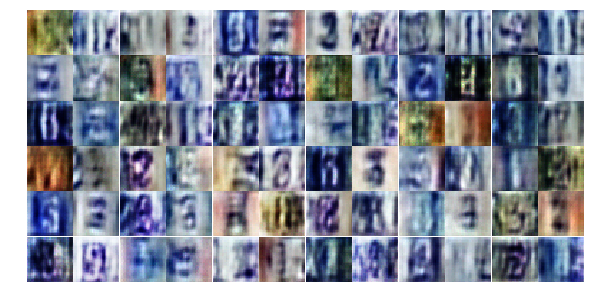

Epoch 4/25... Discriminator Loss: 0.4580... Generator Loss: 2.5749
Epoch 4/25... Discriminator Loss: 0.8133... Generator Loss: 1.0166
Epoch 4/25... Discriminator Loss: 0.8883... Generator Loss: 1.0727
Epoch 4/25... Discriminator Loss: 0.7699... Generator Loss: 2.8908
Epoch 4/25... Discriminator Loss: 0.8204... Generator Loss: 1.2055
Epoch 4/25... Discriminator Loss: 1.1351... Generator Loss: 0.6666
Epoch 4/25... Discriminator Loss: 0.5793... Generator Loss: 1.6986
Epoch 4/25... Discriminator Loss: 0.5637... Generator Loss: 1.3746
Epoch 4/25... Discriminator Loss: 0.8110... Generator Loss: 0.8619
Epoch 4/25... Discriminator Loss: 0.5366... Generator Loss: 2.5109


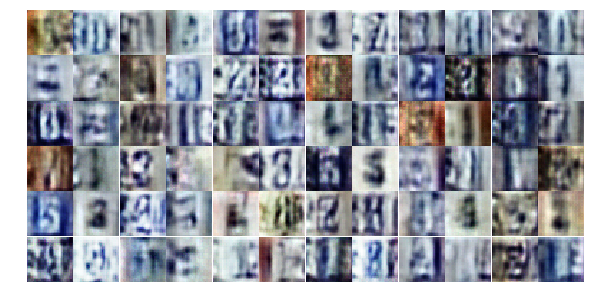

Epoch 4/25... Discriminator Loss: 0.4657... Generator Loss: 1.6055
Epoch 4/25... Discriminator Loss: 0.4870... Generator Loss: 1.3019
Epoch 4/25... Discriminator Loss: 1.5619... Generator Loss: 0.3295
Epoch 4/25... Discriminator Loss: 0.7698... Generator Loss: 1.0865
Epoch 4/25... Discriminator Loss: 0.6317... Generator Loss: 1.1722
Epoch 4/25... Discriminator Loss: 0.7082... Generator Loss: 2.5542
Epoch 4/25... Discriminator Loss: 0.3288... Generator Loss: 1.6834
Epoch 4/25... Discriminator Loss: 0.5997... Generator Loss: 2.4783
Epoch 4/25... Discriminator Loss: 0.3750... Generator Loss: 2.3609
Epoch 4/25... Discriminator Loss: 0.6269... Generator Loss: 3.7383


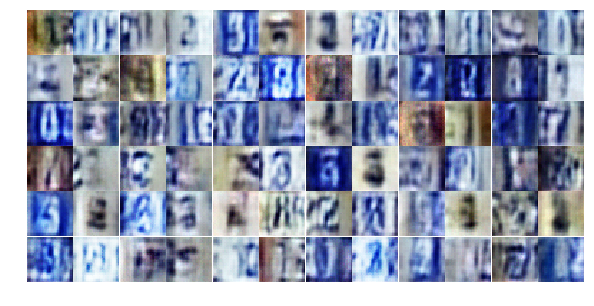

Epoch 4/25... Discriminator Loss: 0.6363... Generator Loss: 1.1679
Epoch 4/25... Discriminator Loss: 0.4071... Generator Loss: 1.7911
Epoch 4/25... Discriminator Loss: 0.3473... Generator Loss: 1.9173
Epoch 4/25... Discriminator Loss: 0.4303... Generator Loss: 1.7532
Epoch 4/25... Discriminator Loss: 0.3346... Generator Loss: 2.2512
Epoch 4/25... Discriminator Loss: 0.5731... Generator Loss: 3.2537
Epoch 4/25... Discriminator Loss: 0.3386... Generator Loss: 2.1151
Epoch 4/25... Discriminator Loss: 0.6706... Generator Loss: 1.1155
Epoch 4/25... Discriminator Loss: 0.6344... Generator Loss: 1.8386
Epoch 4/25... Discriminator Loss: 0.7667... Generator Loss: 0.9730


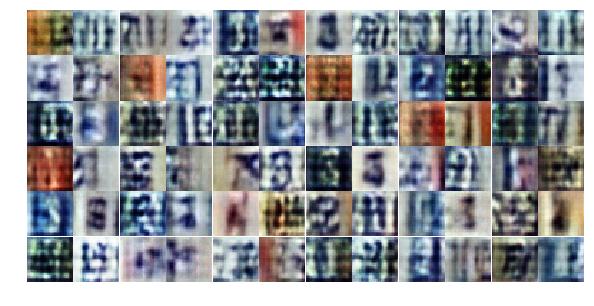

Epoch 4/25... Discriminator Loss: 0.4674... Generator Loss: 1.3757
Epoch 4/25... Discriminator Loss: 0.5972... Generator Loss: 1.3235
Epoch 4/25... Discriminator Loss: 0.5496... Generator Loss: 1.3726
Epoch 4/25... Discriminator Loss: 0.7208... Generator Loss: 1.0581
Epoch 4/25... Discriminator Loss: 0.3203... Generator Loss: 2.4229
Epoch 4/25... Discriminator Loss: 0.9512... Generator Loss: 0.7740
Epoch 4/25... Discriminator Loss: 0.4364... Generator Loss: 1.6172
Epoch 4/25... Discriminator Loss: 0.7159... Generator Loss: 0.9992
Epoch 4/25... Discriminator Loss: 0.4199... Generator Loss: 1.4595
Epoch 4/25... Discriminator Loss: 0.3834... Generator Loss: 1.5621


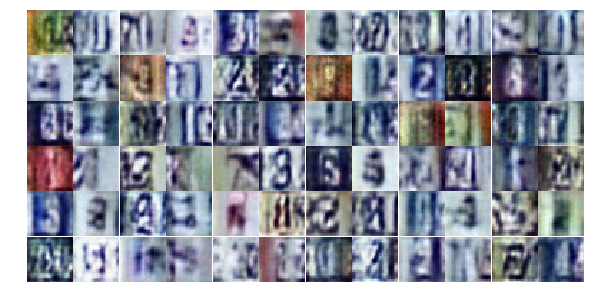

Epoch 4/25... Discriminator Loss: 0.4668... Generator Loss: 1.4770
Epoch 4/25... Discriminator Loss: 0.4954... Generator Loss: 2.5772
Epoch 4/25... Discriminator Loss: 1.2474... Generator Loss: 0.6182
Epoch 4/25... Discriminator Loss: 0.7265... Generator Loss: 2.1640
Epoch 4/25... Discriminator Loss: 0.4656... Generator Loss: 1.6742
Epoch 4/25... Discriminator Loss: 0.6396... Generator Loss: 1.1824
Epoch 4/25... Discriminator Loss: 0.3659... Generator Loss: 1.8047
Epoch 4/25... Discriminator Loss: 0.5745... Generator Loss: 1.1620
Epoch 4/25... Discriminator Loss: 0.3530... Generator Loss: 1.8907
Epoch 5/25... Discriminator Loss: 1.0236... Generator Loss: 0.6397


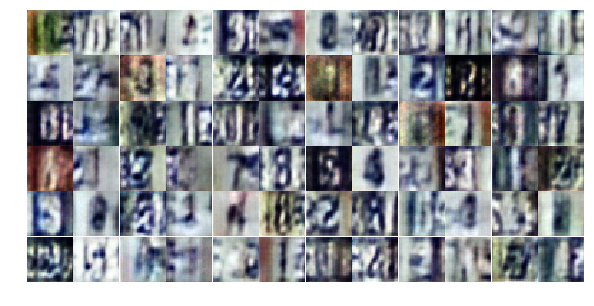

Epoch 5/25... Discriminator Loss: 0.5442... Generator Loss: 1.3380
Epoch 5/25... Discriminator Loss: 0.5176... Generator Loss: 1.6820
Epoch 5/25... Discriminator Loss: 0.5773... Generator Loss: 1.2275
Epoch 5/25... Discriminator Loss: 0.6691... Generator Loss: 0.9322
Epoch 5/25... Discriminator Loss: 0.3683... Generator Loss: 2.0155
Epoch 5/25... Discriminator Loss: 0.8593... Generator Loss: 0.7496
Epoch 5/25... Discriminator Loss: 0.6214... Generator Loss: 1.0489
Epoch 5/25... Discriminator Loss: 0.5351... Generator Loss: 1.1372
Epoch 5/25... Discriminator Loss: 0.7318... Generator Loss: 0.8573
Epoch 5/25... Discriminator Loss: 0.8841... Generator Loss: 0.8368


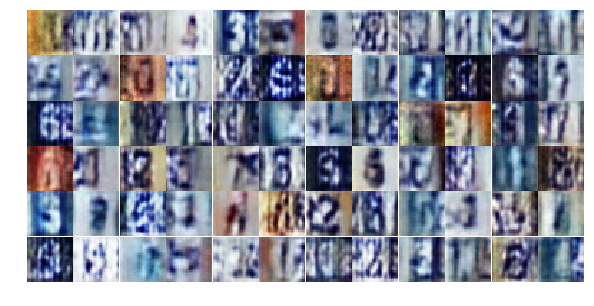

Epoch 5/25... Discriminator Loss: 1.5061... Generator Loss: 3.6755
Epoch 5/25... Discriminator Loss: 0.4663... Generator Loss: 1.7823
Epoch 5/25... Discriminator Loss: 0.3389... Generator Loss: 1.9099
Epoch 5/25... Discriminator Loss: 0.7111... Generator Loss: 1.1126
Epoch 5/25... Discriminator Loss: 0.8868... Generator Loss: 0.6766
Epoch 5/25... Discriminator Loss: 0.4166... Generator Loss: 1.9608
Epoch 5/25... Discriminator Loss: 0.6519... Generator Loss: 1.0969
Epoch 5/25... Discriminator Loss: 0.9595... Generator Loss: 1.4653
Epoch 5/25... Discriminator Loss: 0.9570... Generator Loss: 0.6558
Epoch 5/25... Discriminator Loss: 0.6007... Generator Loss: 1.1871


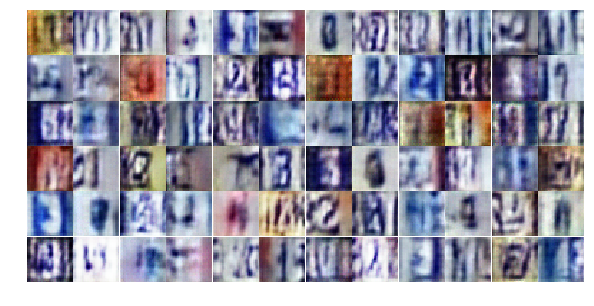

Epoch 5/25... Discriminator Loss: 0.6940... Generator Loss: 1.0200
Epoch 5/25... Discriminator Loss: 1.6664... Generator Loss: 0.3453
Epoch 5/25... Discriminator Loss: 1.0418... Generator Loss: 0.6024
Epoch 5/25... Discriminator Loss: 0.5470... Generator Loss: 1.2701
Epoch 5/25... Discriminator Loss: 1.0463... Generator Loss: 0.6029
Epoch 5/25... Discriminator Loss: 0.6851... Generator Loss: 0.9935
Epoch 5/25... Discriminator Loss: 1.2491... Generator Loss: 0.5670
Epoch 5/25... Discriminator Loss: 1.6635... Generator Loss: 0.3338
Epoch 5/25... Discriminator Loss: 0.5375... Generator Loss: 1.4818
Epoch 5/25... Discriminator Loss: 0.6257... Generator Loss: 1.0780


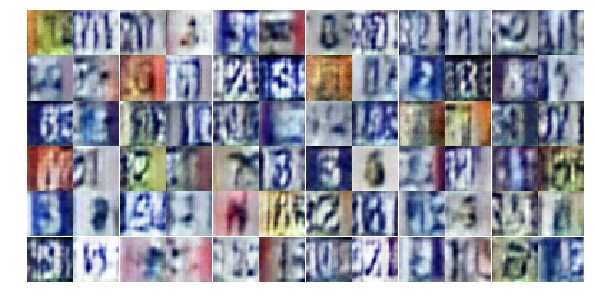

Epoch 5/25... Discriminator Loss: 0.4247... Generator Loss: 1.8467
Epoch 5/25... Discriminator Loss: 0.3329... Generator Loss: 1.6626
Epoch 5/25... Discriminator Loss: 0.4689... Generator Loss: 1.5876
Epoch 5/25... Discriminator Loss: 0.3844... Generator Loss: 1.8191
Epoch 5/25... Discriminator Loss: 1.0122... Generator Loss: 0.6969
Epoch 5/25... Discriminator Loss: 0.5709... Generator Loss: 1.4411
Epoch 5/25... Discriminator Loss: 0.5598... Generator Loss: 2.3734
Epoch 5/25... Discriminator Loss: 0.9011... Generator Loss: 0.7164
Epoch 5/25... Discriminator Loss: 1.4405... Generator Loss: 0.3931
Epoch 5/25... Discriminator Loss: 0.6191... Generator Loss: 1.3203


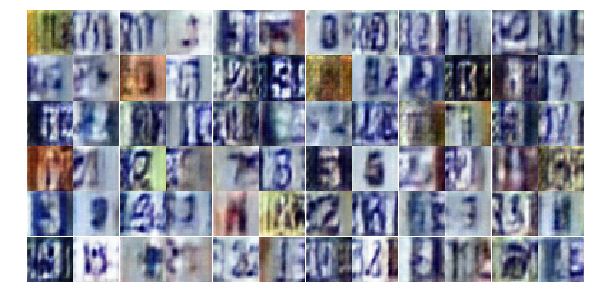

Epoch 5/25... Discriminator Loss: 0.2653... Generator Loss: 2.1137
Epoch 5/25... Discriminator Loss: 0.5136... Generator Loss: 1.1537
Epoch 5/25... Discriminator Loss: 1.1947... Generator Loss: 0.4668
Epoch 5/25... Discriminator Loss: 0.5279... Generator Loss: 2.1183
Epoch 5/25... Discriminator Loss: 0.9182... Generator Loss: 2.8415
Epoch 5/25... Discriminator Loss: 1.8435... Generator Loss: 2.9802
Epoch 5/25... Discriminator Loss: 0.6951... Generator Loss: 1.2532
Epoch 5/25... Discriminator Loss: 0.5175... Generator Loss: 1.5138
Epoch 5/25... Discriminator Loss: 0.6799... Generator Loss: 1.1340
Epoch 5/25... Discriminator Loss: 0.3889... Generator Loss: 1.5732


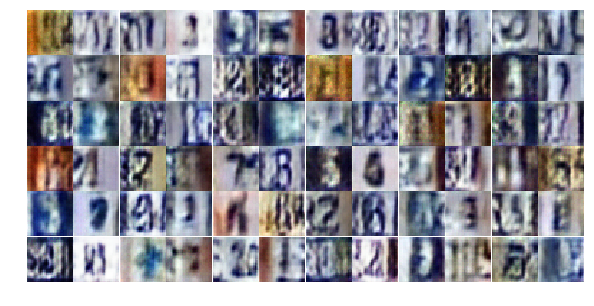

Epoch 5/25... Discriminator Loss: 0.8506... Generator Loss: 0.7312
Epoch 5/25... Discriminator Loss: 0.5364... Generator Loss: 1.3038
Epoch 5/25... Discriminator Loss: 0.6429... Generator Loss: 2.5372
Epoch 5/25... Discriminator Loss: 0.9284... Generator Loss: 0.6826
Epoch 5/25... Discriminator Loss: 0.6351... Generator Loss: 1.2349
Epoch 5/25... Discriminator Loss: 1.2592... Generator Loss: 0.4438
Epoch 6/25... Discriminator Loss: 0.6866... Generator Loss: 1.8258
Epoch 6/25... Discriminator Loss: 0.4212... Generator Loss: 1.5823
Epoch 6/25... Discriminator Loss: 0.4494... Generator Loss: 1.5885
Epoch 6/25... Discriminator Loss: 0.5172... Generator Loss: 1.3962


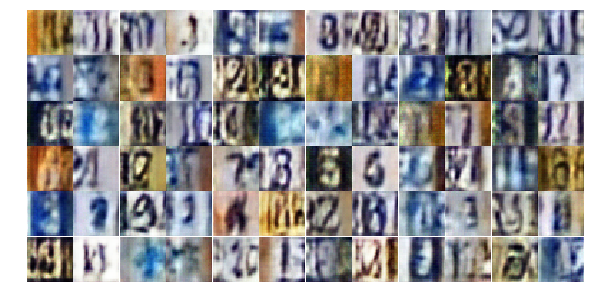

Epoch 6/25... Discriminator Loss: 0.3835... Generator Loss: 1.6767
Epoch 6/25... Discriminator Loss: 1.2954... Generator Loss: 3.5657
Epoch 6/25... Discriminator Loss: 0.6924... Generator Loss: 1.0821
Epoch 6/25... Discriminator Loss: 0.8080... Generator Loss: 1.1131
Epoch 6/25... Discriminator Loss: 0.9035... Generator Loss: 0.6954
Epoch 6/25... Discriminator Loss: 0.3729... Generator Loss: 1.5448
Epoch 6/25... Discriminator Loss: 0.4850... Generator Loss: 2.0649
Epoch 6/25... Discriminator Loss: 0.7568... Generator Loss: 1.3920
Epoch 6/25... Discriminator Loss: 0.6845... Generator Loss: 0.9229
Epoch 6/25... Discriminator Loss: 0.5065... Generator Loss: 2.1398


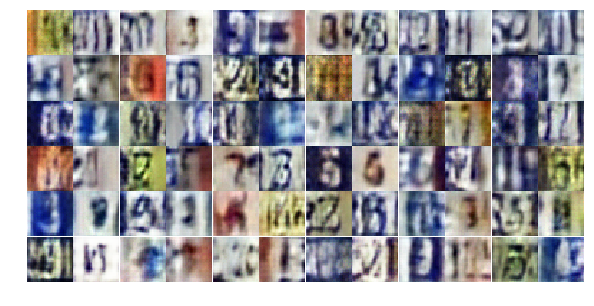

Epoch 6/25... Discriminator Loss: 1.3978... Generator Loss: 0.4046
Epoch 6/25... Discriminator Loss: 0.8983... Generator Loss: 0.8747
Epoch 6/25... Discriminator Loss: 1.1454... Generator Loss: 0.5188
Epoch 6/25... Discriminator Loss: 0.6123... Generator Loss: 1.0432
Epoch 6/25... Discriminator Loss: 0.3739... Generator Loss: 2.4326
Epoch 6/25... Discriminator Loss: 0.4504... Generator Loss: 1.7969
Epoch 6/25... Discriminator Loss: 0.4463... Generator Loss: 1.4936
Epoch 6/25... Discriminator Loss: 0.7792... Generator Loss: 0.8902
Epoch 6/25... Discriminator Loss: 0.4168... Generator Loss: 1.6387
Epoch 6/25... Discriminator Loss: 0.5611... Generator Loss: 1.3691


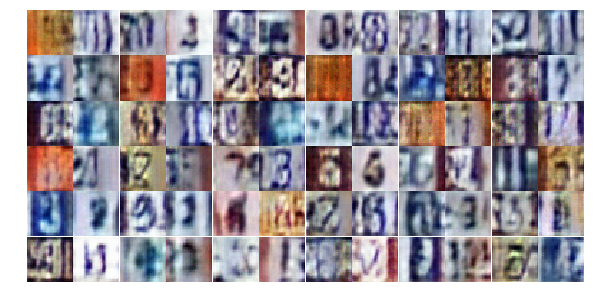

Epoch 6/25... Discriminator Loss: 0.7080... Generator Loss: 0.9368
Epoch 6/25... Discriminator Loss: 0.4003... Generator Loss: 1.5483
Epoch 6/25... Discriminator Loss: 1.1358... Generator Loss: 0.5615
Epoch 6/25... Discriminator Loss: 1.4810... Generator Loss: 0.3610
Epoch 6/25... Discriminator Loss: 0.7921... Generator Loss: 3.8493
Epoch 6/25... Discriminator Loss: 1.1333... Generator Loss: 0.5824
Epoch 6/25... Discriminator Loss: 0.5858... Generator Loss: 1.4611
Epoch 6/25... Discriminator Loss: 0.4372... Generator Loss: 1.3476
Epoch 6/25... Discriminator Loss: 0.5208... Generator Loss: 1.3844
Epoch 6/25... Discriminator Loss: 0.3907... Generator Loss: 1.8011


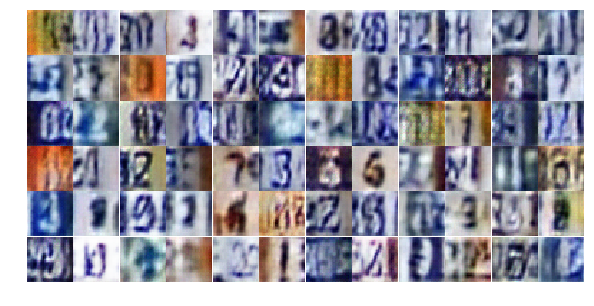

Epoch 6/25... Discriminator Loss: 0.6364... Generator Loss: 1.2497
Epoch 6/25... Discriminator Loss: 0.7117... Generator Loss: 1.0343
Epoch 6/25... Discriminator Loss: 0.8906... Generator Loss: 0.7821
Epoch 6/25... Discriminator Loss: 0.6585... Generator Loss: 1.0420
Epoch 6/25... Discriminator Loss: 0.5379... Generator Loss: 1.1955
Epoch 6/25... Discriminator Loss: 1.4038... Generator Loss: 0.4213
Epoch 6/25... Discriminator Loss: 1.1747... Generator Loss: 0.5801
Epoch 6/25... Discriminator Loss: 0.4389... Generator Loss: 1.7169
Epoch 6/25... Discriminator Loss: 0.9135... Generator Loss: 0.7095
Epoch 6/25... Discriminator Loss: 0.5603... Generator Loss: 1.1626


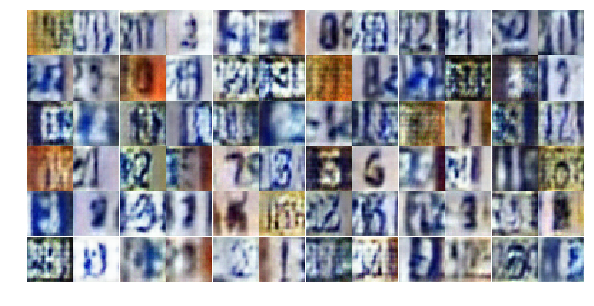

Epoch 6/25... Discriminator Loss: 0.6113... Generator Loss: 1.8466
Epoch 6/25... Discriminator Loss: 0.6896... Generator Loss: 1.1774
Epoch 6/25... Discriminator Loss: 1.0169... Generator Loss: 0.6957
Epoch 6/25... Discriminator Loss: 1.0245... Generator Loss: 2.1766
Epoch 6/25... Discriminator Loss: 0.5775... Generator Loss: 1.5981
Epoch 6/25... Discriminator Loss: 0.5562... Generator Loss: 1.2350
Epoch 6/25... Discriminator Loss: 0.9472... Generator Loss: 0.7153
Epoch 6/25... Discriminator Loss: 0.6504... Generator Loss: 1.4641
Epoch 6/25... Discriminator Loss: 0.6876... Generator Loss: 1.0233
Epoch 6/25... Discriminator Loss: 1.6473... Generator Loss: 0.3023


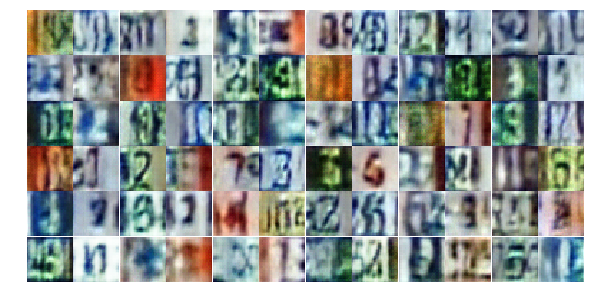

Epoch 6/25... Discriminator Loss: 0.4481... Generator Loss: 1.5344
Epoch 6/25... Discriminator Loss: 0.6776... Generator Loss: 1.1282
Epoch 6/25... Discriminator Loss: 0.5834... Generator Loss: 1.9786
Epoch 7/25... Discriminator Loss: 0.4775... Generator Loss: 1.6502
Epoch 7/25... Discriminator Loss: 0.6750... Generator Loss: 1.0823
Epoch 7/25... Discriminator Loss: 0.7223... Generator Loss: 0.9471
Epoch 7/25... Discriminator Loss: 0.7661... Generator Loss: 0.9498
Epoch 7/25... Discriminator Loss: 0.5344... Generator Loss: 1.3845
Epoch 7/25... Discriminator Loss: 0.5910... Generator Loss: 1.2316
Epoch 7/25... Discriminator Loss: 0.4851... Generator Loss: 1.5674


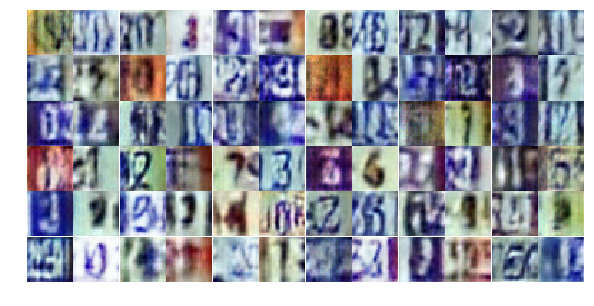

Epoch 7/25... Discriminator Loss: 0.6526... Generator Loss: 1.1895
Epoch 7/25... Discriminator Loss: 0.6805... Generator Loss: 0.9869
Epoch 7/25... Discriminator Loss: 0.8308... Generator Loss: 0.8070
Epoch 7/25... Discriminator Loss: 0.7387... Generator Loss: 0.9740
Epoch 7/25... Discriminator Loss: 0.6752... Generator Loss: 1.3236
Epoch 7/25... Discriminator Loss: 1.0298... Generator Loss: 0.6157
Epoch 7/25... Discriminator Loss: 1.2934... Generator Loss: 3.1306
Epoch 7/25... Discriminator Loss: 0.7290... Generator Loss: 1.3808
Epoch 7/25... Discriminator Loss: 0.7003... Generator Loss: 1.0386
Epoch 7/25... Discriminator Loss: 0.4042... Generator Loss: 1.6229


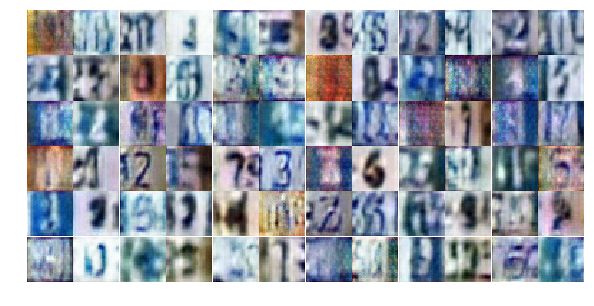

Epoch 7/25... Discriminator Loss: 0.6293... Generator Loss: 2.1141
Epoch 7/25... Discriminator Loss: 0.5090... Generator Loss: 1.4318
Epoch 7/25... Discriminator Loss: 0.7662... Generator Loss: 0.8508
Epoch 7/25... Discriminator Loss: 0.5859... Generator Loss: 1.2247
Epoch 7/25... Discriminator Loss: 0.5537... Generator Loss: 1.1886
Epoch 7/25... Discriminator Loss: 0.6512... Generator Loss: 0.9894
Epoch 7/25... Discriminator Loss: 0.5663... Generator Loss: 1.2027
Epoch 7/25... Discriminator Loss: 0.6272... Generator Loss: 1.1398
Epoch 7/25... Discriminator Loss: 0.2441... Generator Loss: 2.3740
Epoch 7/25... Discriminator Loss: 0.7601... Generator Loss: 4.0995


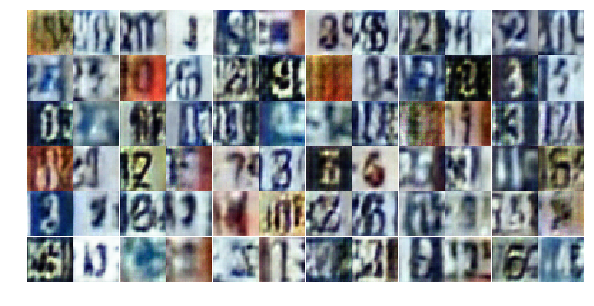

Epoch 7/25... Discriminator Loss: 0.8890... Generator Loss: 0.8159
Epoch 7/25... Discriminator Loss: 0.6041... Generator Loss: 1.2437
Epoch 7/25... Discriminator Loss: 0.4785... Generator Loss: 1.4220
Epoch 7/25... Discriminator Loss: 0.6041... Generator Loss: 1.2029
Epoch 7/25... Discriminator Loss: 0.6468... Generator Loss: 1.1243
Epoch 7/25... Discriminator Loss: 0.7023... Generator Loss: 1.0108
Epoch 7/25... Discriminator Loss: 0.8418... Generator Loss: 0.8677
Epoch 7/25... Discriminator Loss: 1.5169... Generator Loss: 0.3526
Epoch 7/25... Discriminator Loss: 2.1048... Generator Loss: 0.1901
Epoch 7/25... Discriminator Loss: 0.5941... Generator Loss: 1.6831


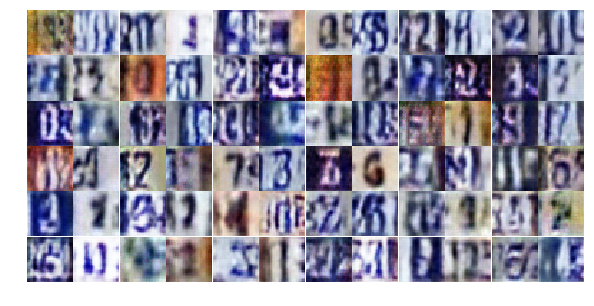

Epoch 7/25... Discriminator Loss: 0.9500... Generator Loss: 0.7464
Epoch 7/25... Discriminator Loss: 0.5451... Generator Loss: 1.2236
Epoch 7/25... Discriminator Loss: 0.4809... Generator Loss: 1.4277
Epoch 7/25... Discriminator Loss: 0.4929... Generator Loss: 1.3984
Epoch 7/25... Discriminator Loss: 0.5091... Generator Loss: 1.4414
Epoch 7/25... Discriminator Loss: 0.4596... Generator Loss: 1.7805
Epoch 7/25... Discriminator Loss: 0.6853... Generator Loss: 0.9693
Epoch 7/25... Discriminator Loss: 1.6031... Generator Loss: 1.0477
Epoch 7/25... Discriminator Loss: 0.8662... Generator Loss: 3.8813
Epoch 7/25... Discriminator Loss: 0.7836... Generator Loss: 0.9093


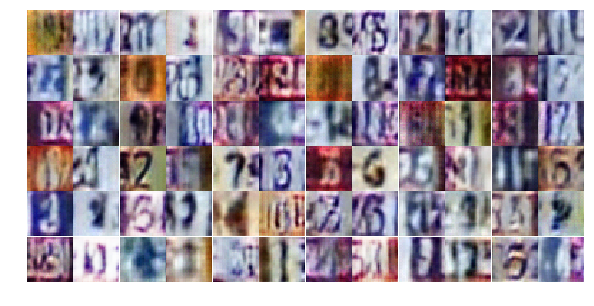

Epoch 7/25... Discriminator Loss: 0.4588... Generator Loss: 2.6461
Epoch 7/25... Discriminator Loss: 0.6485... Generator Loss: 1.1475
Epoch 7/25... Discriminator Loss: 0.6847... Generator Loss: 1.3201
Epoch 7/25... Discriminator Loss: 1.2917... Generator Loss: 0.4489
Epoch 7/25... Discriminator Loss: 0.5647... Generator Loss: 1.1132
Epoch 7/25... Discriminator Loss: 0.4178... Generator Loss: 2.2495
Epoch 7/25... Discriminator Loss: 1.5556... Generator Loss: 0.3603
Epoch 7/25... Discriminator Loss: 0.7911... Generator Loss: 1.2575
Epoch 7/25... Discriminator Loss: 0.7991... Generator Loss: 0.9547
Epoch 7/25... Discriminator Loss: 0.4500... Generator Loss: 1.3393


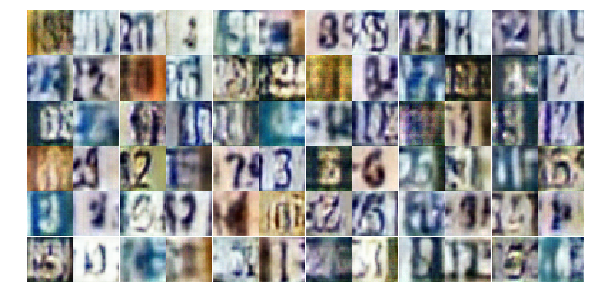

Epoch 7/25... Discriminator Loss: 0.5407... Generator Loss: 1.9310
Epoch 8/25... Discriminator Loss: 0.5284... Generator Loss: 1.4937
Epoch 8/25... Discriminator Loss: 0.9343... Generator Loss: 0.6930
Epoch 8/25... Discriminator Loss: 0.6787... Generator Loss: 1.0367
Epoch 8/25... Discriminator Loss: 0.5931... Generator Loss: 2.4616
Epoch 8/25... Discriminator Loss: 1.0040... Generator Loss: 0.6014
Epoch 8/25... Discriminator Loss: 1.0331... Generator Loss: 0.7098
Epoch 8/25... Discriminator Loss: 0.4499... Generator Loss: 1.8872
Epoch 8/25... Discriminator Loss: 0.8838... Generator Loss: 0.7661
Epoch 8/25... Discriminator Loss: 0.5463... Generator Loss: 1.2543


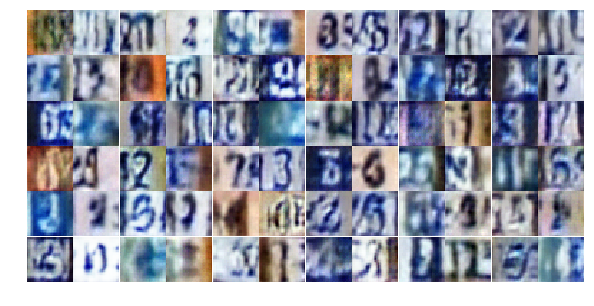

Epoch 8/25... Discriminator Loss: 0.4002... Generator Loss: 1.8021
Epoch 8/25... Discriminator Loss: 0.4562... Generator Loss: 1.4319
Epoch 8/25... Discriminator Loss: 0.7682... Generator Loss: 0.9416
Epoch 8/25... Discriminator Loss: 0.3978... Generator Loss: 1.6966
Epoch 8/25... Discriminator Loss: 0.7354... Generator Loss: 0.8893
Epoch 8/25... Discriminator Loss: 0.9530... Generator Loss: 3.1941
Epoch 8/25... Discriminator Loss: 0.5514... Generator Loss: 1.3616
Epoch 8/25... Discriminator Loss: 0.5462... Generator Loss: 1.2090
Epoch 8/25... Discriminator Loss: 0.7857... Generator Loss: 1.9038
Epoch 8/25... Discriminator Loss: 1.0649... Generator Loss: 0.6818


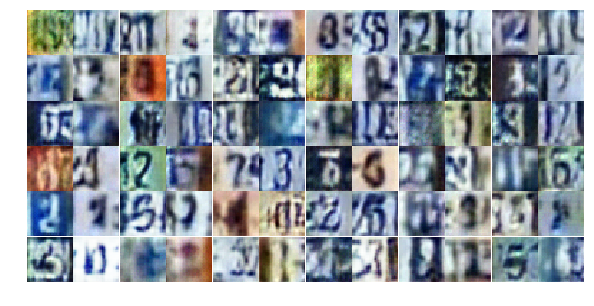

Epoch 8/25... Discriminator Loss: 0.4763... Generator Loss: 1.5893
Epoch 8/25... Discriminator Loss: 0.6761... Generator Loss: 0.9252
Epoch 8/25... Discriminator Loss: 0.9244... Generator Loss: 0.6810
Epoch 8/25... Discriminator Loss: 0.6570... Generator Loss: 1.0849
Epoch 8/25... Discriminator Loss: 0.3877... Generator Loss: 1.6754
Epoch 8/25... Discriminator Loss: 0.6136... Generator Loss: 1.1706
Epoch 8/25... Discriminator Loss: 0.4458... Generator Loss: 1.6254
Epoch 8/25... Discriminator Loss: 0.4898... Generator Loss: 1.2317
Epoch 8/25... Discriminator Loss: 0.8686... Generator Loss: 2.3225
Epoch 8/25... Discriminator Loss: 0.9036... Generator Loss: 0.8254


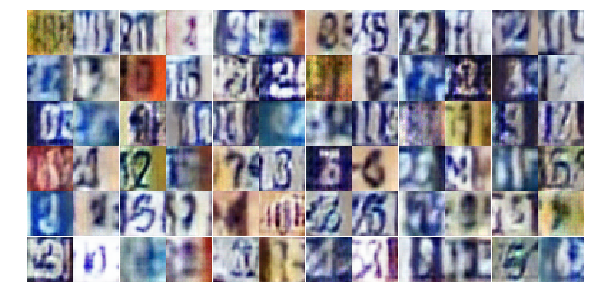

Epoch 8/25... Discriminator Loss: 0.7008... Generator Loss: 1.5274
Epoch 8/25... Discriminator Loss: 1.0333... Generator Loss: 0.5615
Epoch 8/25... Discriminator Loss: 0.6421... Generator Loss: 1.3526
Epoch 8/25... Discriminator Loss: 0.5640... Generator Loss: 1.3133
Epoch 8/25... Discriminator Loss: 0.5884... Generator Loss: 1.1262
Epoch 8/25... Discriminator Loss: 0.7563... Generator Loss: 0.8486
Epoch 8/25... Discriminator Loss: 0.8819... Generator Loss: 0.8718
Epoch 8/25... Discriminator Loss: 0.5399... Generator Loss: 1.5495
Epoch 8/25... Discriminator Loss: 0.5662... Generator Loss: 1.1638
Epoch 8/25... Discriminator Loss: 0.5287... Generator Loss: 1.2155


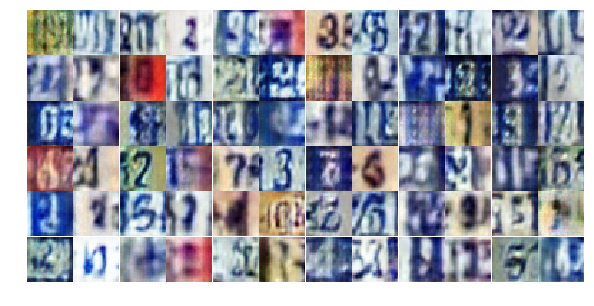

Epoch 8/25... Discriminator Loss: 0.4097... Generator Loss: 1.5631
Epoch 8/25... Discriminator Loss: 0.6628... Generator Loss: 1.0356
Epoch 8/25... Discriminator Loss: 0.5315... Generator Loss: 1.3025
Epoch 8/25... Discriminator Loss: 0.7160... Generator Loss: 0.9619
Epoch 8/25... Discriminator Loss: 0.9020... Generator Loss: 1.9905
Epoch 8/25... Discriminator Loss: 0.7883... Generator Loss: 0.7803
Epoch 8/25... Discriminator Loss: 0.8052... Generator Loss: 0.7840
Epoch 8/25... Discriminator Loss: 0.4947... Generator Loss: 1.6857
Epoch 8/25... Discriminator Loss: 0.4877... Generator Loss: 1.6292
Epoch 8/25... Discriminator Loss: 0.8374... Generator Loss: 2.2924


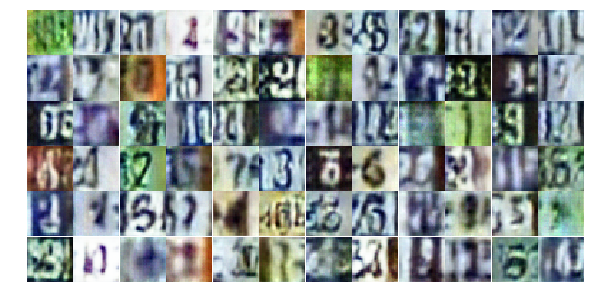

Epoch 8/25... Discriminator Loss: 0.4563... Generator Loss: 2.3202
Epoch 8/25... Discriminator Loss: 0.4478... Generator Loss: 1.9069
Epoch 8/25... Discriminator Loss: 0.3728... Generator Loss: 1.9418
Epoch 8/25... Discriminator Loss: 0.9222... Generator Loss: 0.7134
Epoch 8/25... Discriminator Loss: 0.3258... Generator Loss: 2.5578
Epoch 8/25... Discriminator Loss: 0.8905... Generator Loss: 0.8519
Epoch 8/25... Discriminator Loss: 0.5031... Generator Loss: 1.2172
Epoch 8/25... Discriminator Loss: 0.4220... Generator Loss: 2.0147
Epoch 9/25... Discriminator Loss: 1.0755... Generator Loss: 0.7721
Epoch 9/25... Discriminator Loss: 1.2297... Generator Loss: 0.5085


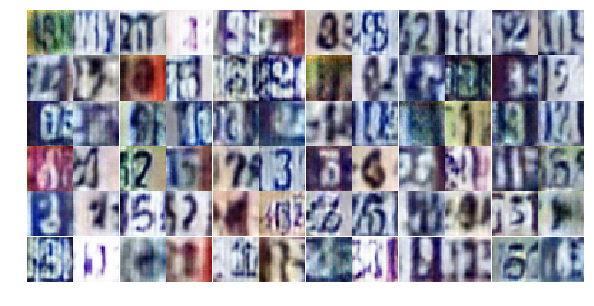

Epoch 9/25... Discriminator Loss: 1.1520... Generator Loss: 0.5339
Epoch 9/25... Discriminator Loss: 0.6699... Generator Loss: 1.0292
Epoch 9/25... Discriminator Loss: 0.8734... Generator Loss: 0.7634
Epoch 9/25... Discriminator Loss: 0.3462... Generator Loss: 2.0880
Epoch 9/25... Discriminator Loss: 1.3557... Generator Loss: 0.4924
Epoch 9/25... Discriminator Loss: 0.7418... Generator Loss: 1.7061
Epoch 9/25... Discriminator Loss: 0.6080... Generator Loss: 1.1603
Epoch 9/25... Discriminator Loss: 0.6595... Generator Loss: 0.9873
Epoch 9/25... Discriminator Loss: 0.7375... Generator Loss: 0.9064
Epoch 9/25... Discriminator Loss: 0.4861... Generator Loss: 1.3255


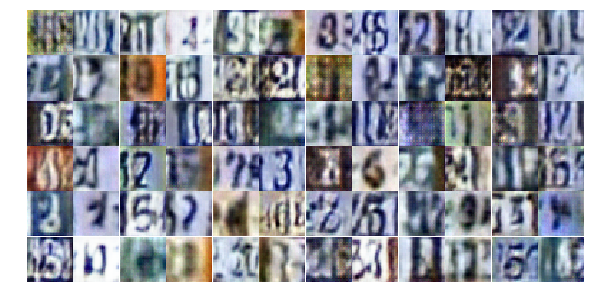

Epoch 9/25... Discriminator Loss: 0.9242... Generator Loss: 0.6820
Epoch 9/25... Discriminator Loss: 1.4881... Generator Loss: 0.3263
Epoch 9/25... Discriminator Loss: 0.6308... Generator Loss: 1.1747
Epoch 9/25... Discriminator Loss: 1.6400... Generator Loss: 0.3118
Epoch 9/25... Discriminator Loss: 0.4677... Generator Loss: 1.5209
Epoch 9/25... Discriminator Loss: 0.7475... Generator Loss: 1.0650
Epoch 9/25... Discriminator Loss: 1.5818... Generator Loss: 0.2918
Epoch 9/25... Discriminator Loss: 0.5992... Generator Loss: 1.0546
Epoch 9/25... Discriminator Loss: 0.9955... Generator Loss: 0.6639
Epoch 9/25... Discriminator Loss: 0.8338... Generator Loss: 0.8235


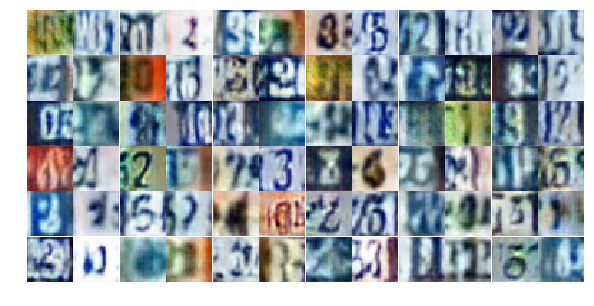

Epoch 9/25... Discriminator Loss: 0.9260... Generator Loss: 0.8640
Epoch 9/25... Discriminator Loss: 0.6419... Generator Loss: 1.0701
Epoch 9/25... Discriminator Loss: 0.6150... Generator Loss: 1.2091
Epoch 9/25... Discriminator Loss: 0.4820... Generator Loss: 1.4121
Epoch 9/25... Discriminator Loss: 0.4270... Generator Loss: 1.4737
Epoch 9/25... Discriminator Loss: 0.4801... Generator Loss: 1.3177
Epoch 9/25... Discriminator Loss: 1.1440... Generator Loss: 0.5288
Epoch 9/25... Discriminator Loss: 0.4103... Generator Loss: 1.7966
Epoch 9/25... Discriminator Loss: 0.4942... Generator Loss: 1.4729
Epoch 9/25... Discriminator Loss: 0.5634... Generator Loss: 1.1140


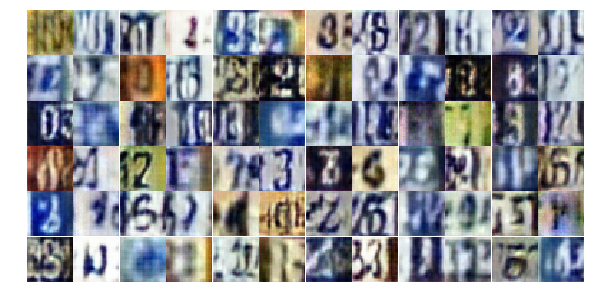

Epoch 9/25... Discriminator Loss: 0.4001... Generator Loss: 1.4114
Epoch 9/25... Discriminator Loss: 0.6509... Generator Loss: 0.9792
Epoch 9/25... Discriminator Loss: 1.0570... Generator Loss: 0.5797
Epoch 9/25... Discriminator Loss: 1.1501... Generator Loss: 0.5281
Epoch 9/25... Discriminator Loss: 0.8099... Generator Loss: 0.9172
Epoch 9/25... Discriminator Loss: 0.9659... Generator Loss: 2.7153
Epoch 9/25... Discriminator Loss: 0.5873... Generator Loss: 2.2134
Epoch 9/25... Discriminator Loss: 0.4713... Generator Loss: 1.3478
Epoch 9/25... Discriminator Loss: 1.3813... Generator Loss: 0.4295
Epoch 9/25... Discriminator Loss: 0.6903... Generator Loss: 0.9723


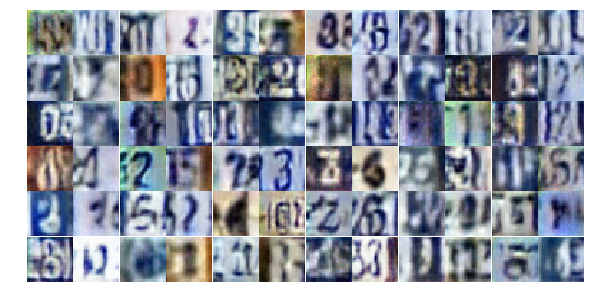

Epoch 9/25... Discriminator Loss: 0.4309... Generator Loss: 1.7764
Epoch 9/25... Discriminator Loss: 0.5888... Generator Loss: 1.1166
Epoch 9/25... Discriminator Loss: 0.4737... Generator Loss: 1.5859
Epoch 9/25... Discriminator Loss: 0.5793... Generator Loss: 1.1608
Epoch 9/25... Discriminator Loss: 0.3642... Generator Loss: 1.9179
Epoch 9/25... Discriminator Loss: 0.8507... Generator Loss: 0.7827
Epoch 9/25... Discriminator Loss: 0.6801... Generator Loss: 1.3117
Epoch 9/25... Discriminator Loss: 0.8782... Generator Loss: 0.7151
Epoch 9/25... Discriminator Loss: 0.4960... Generator Loss: 1.4118
Epoch 9/25... Discriminator Loss: 0.5357... Generator Loss: 1.6140


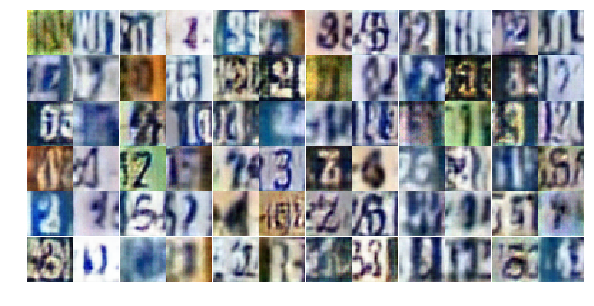

Epoch 9/25... Discriminator Loss: 1.8965... Generator Loss: 0.3148
Epoch 9/25... Discriminator Loss: 1.1377... Generator Loss: 2.5579
Epoch 9/25... Discriminator Loss: 0.7335... Generator Loss: 1.0348
Epoch 9/25... Discriminator Loss: 1.3102... Generator Loss: 0.4362
Epoch 9/25... Discriminator Loss: 0.6473... Generator Loss: 1.2877
Epoch 10/25... Discriminator Loss: 0.8886... Generator Loss: 0.7346
Epoch 10/25... Discriminator Loss: 0.5896... Generator Loss: 1.1382
Epoch 10/25... Discriminator Loss: 0.7739... Generator Loss: 0.8947
Epoch 10/25... Discriminator Loss: 0.8346... Generator Loss: 0.8490
Epoch 10/25... Discriminator Loss: 1.0187... Generator Loss: 0.6139


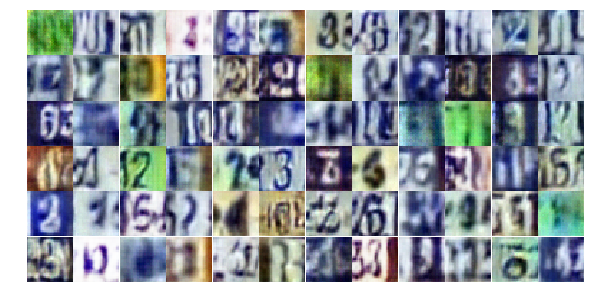

Epoch 10/25... Discriminator Loss: 0.5154... Generator Loss: 1.2694
Epoch 10/25... Discriminator Loss: 0.6130... Generator Loss: 1.0947
Epoch 10/25... Discriminator Loss: 0.5915... Generator Loss: 1.1465
Epoch 10/25... Discriminator Loss: 0.4316... Generator Loss: 1.7767
Epoch 10/25... Discriminator Loss: 0.4447... Generator Loss: 1.7821
Epoch 10/25... Discriminator Loss: 0.6572... Generator Loss: 1.0087
Epoch 10/25... Discriminator Loss: 0.3263... Generator Loss: 1.7857
Epoch 10/25... Discriminator Loss: 1.3588... Generator Loss: 0.4080
Epoch 10/25... Discriminator Loss: 1.8056... Generator Loss: 2.8559
Epoch 10/25... Discriminator Loss: 0.5581... Generator Loss: 1.4213


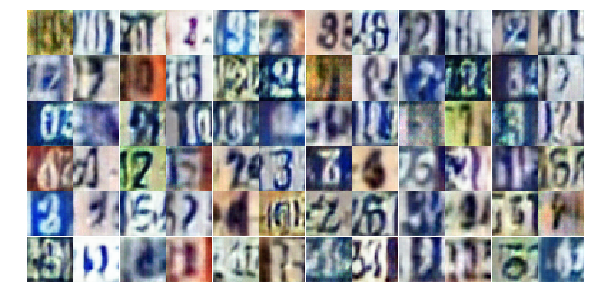

Epoch 10/25... Discriminator Loss: 0.4861... Generator Loss: 1.5636
Epoch 10/25... Discriminator Loss: 0.6862... Generator Loss: 1.5010
Epoch 10/25... Discriminator Loss: 0.5860... Generator Loss: 1.1459
Epoch 10/25... Discriminator Loss: 1.4880... Generator Loss: 0.3522
Epoch 10/25... Discriminator Loss: 0.5335... Generator Loss: 2.0014
Epoch 10/25... Discriminator Loss: 0.4266... Generator Loss: 1.5365
Epoch 10/25... Discriminator Loss: 0.6778... Generator Loss: 1.0194
Epoch 10/25... Discriminator Loss: 0.5176... Generator Loss: 1.1993
Epoch 10/25... Discriminator Loss: 0.5775... Generator Loss: 1.1467
Epoch 10/25... Discriminator Loss: 0.4578... Generator Loss: 2.7883


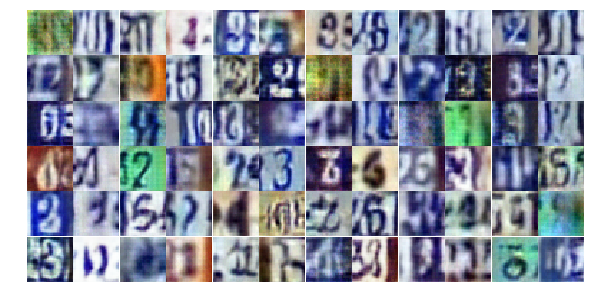

Epoch 10/25... Discriminator Loss: 1.6660... Generator Loss: 0.2830
Epoch 10/25... Discriminator Loss: 1.0630... Generator Loss: 0.6417
Epoch 10/25... Discriminator Loss: 0.3746... Generator Loss: 1.8590
Epoch 10/25... Discriminator Loss: 0.5559... Generator Loss: 1.7158
Epoch 10/25... Discriminator Loss: 1.4862... Generator Loss: 0.3291
Epoch 10/25... Discriminator Loss: 0.5079... Generator Loss: 1.5239
Epoch 10/25... Discriminator Loss: 0.4078... Generator Loss: 1.4701
Epoch 10/25... Discriminator Loss: 0.6377... Generator Loss: 1.1261
Epoch 10/25... Discriminator Loss: 0.4867... Generator Loss: 1.3220
Epoch 10/25... Discriminator Loss: 0.6352... Generator Loss: 2.5778


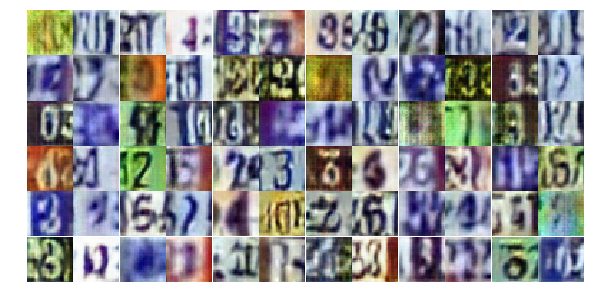

Epoch 10/25... Discriminator Loss: 0.6733... Generator Loss: 2.2532
Epoch 10/25... Discriminator Loss: 1.2964... Generator Loss: 0.5902
Epoch 10/25... Discriminator Loss: 0.8498... Generator Loss: 1.8891
Epoch 10/25... Discriminator Loss: 1.1101... Generator Loss: 2.7709
Epoch 10/25... Discriminator Loss: 0.8866... Generator Loss: 0.6748
Epoch 10/25... Discriminator Loss: 1.1525... Generator Loss: 0.6022
Epoch 10/25... Discriminator Loss: 0.6680... Generator Loss: 0.9810
Epoch 10/25... Discriminator Loss: 0.9031... Generator Loss: 0.7728
Epoch 10/25... Discriminator Loss: 0.5418... Generator Loss: 1.2178
Epoch 10/25... Discriminator Loss: 0.5570... Generator Loss: 1.8703


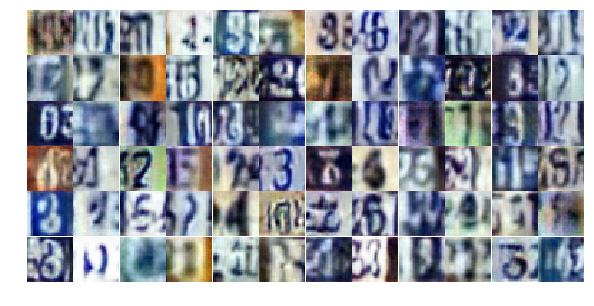

Epoch 10/25... Discriminator Loss: 0.9398... Generator Loss: 0.7498
Epoch 10/25... Discriminator Loss: 0.7903... Generator Loss: 0.8671
Epoch 10/25... Discriminator Loss: 0.7218... Generator Loss: 1.0185
Epoch 10/25... Discriminator Loss: 0.6104... Generator Loss: 1.1187
Epoch 10/25... Discriminator Loss: 0.4539... Generator Loss: 1.5485
Epoch 10/25... Discriminator Loss: 0.6554... Generator Loss: 1.0492
Epoch 10/25... Discriminator Loss: 0.6205... Generator Loss: 1.0899
Epoch 10/25... Discriminator Loss: 0.4145... Generator Loss: 1.5259
Epoch 10/25... Discriminator Loss: 0.6459... Generator Loss: 2.3008
Epoch 10/25... Discriminator Loss: 0.6285... Generator Loss: 1.3378


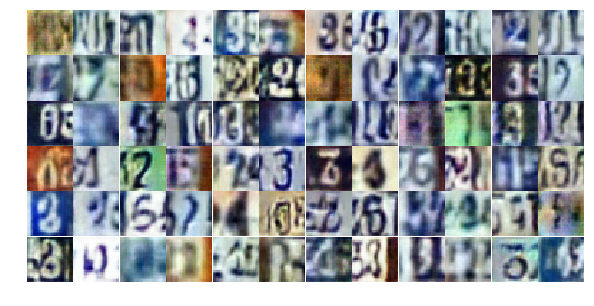

Epoch 10/25... Discriminator Loss: 0.6970... Generator Loss: 2.2935
Epoch 10/25... Discriminator Loss: 0.5746... Generator Loss: 1.0923
Epoch 10/25... Discriminator Loss: 0.9146... Generator Loss: 0.7618
Epoch 11/25... Discriminator Loss: 1.3086... Generator Loss: 0.4646
Epoch 11/25... Discriminator Loss: 0.4921... Generator Loss: 1.7110
Epoch 11/25... Discriminator Loss: 0.9881... Generator Loss: 0.6105
Epoch 11/25... Discriminator Loss: 0.5410... Generator Loss: 1.2829
Epoch 11/25... Discriminator Loss: 0.5037... Generator Loss: 1.8273
Epoch 11/25... Discriminator Loss: 1.5985... Generator Loss: 0.3168
Epoch 11/25... Discriminator Loss: 0.8911... Generator Loss: 0.8833


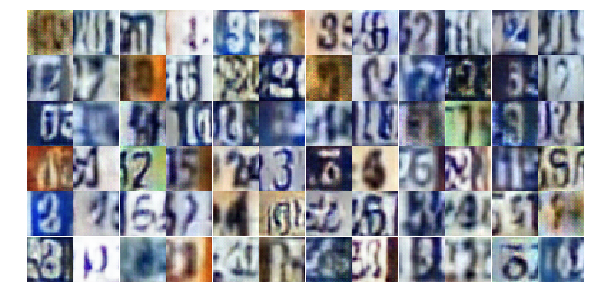

Epoch 11/25... Discriminator Loss: 0.9094... Generator Loss: 0.9125
Epoch 11/25... Discriminator Loss: 0.6344... Generator Loss: 1.3807
Epoch 11/25... Discriminator Loss: 0.5648... Generator Loss: 1.1999
Epoch 11/25... Discriminator Loss: 0.7629... Generator Loss: 0.8437
Epoch 11/25... Discriminator Loss: 0.9436... Generator Loss: 2.2280
Epoch 11/25... Discriminator Loss: 0.3129... Generator Loss: 2.3943
Epoch 11/25... Discriminator Loss: 0.6686... Generator Loss: 1.1029
Epoch 11/25... Discriminator Loss: 0.2939... Generator Loss: 2.2520
Epoch 11/25... Discriminator Loss: 0.9182... Generator Loss: 0.7004
Epoch 11/25... Discriminator Loss: 1.1426... Generator Loss: 0.5710


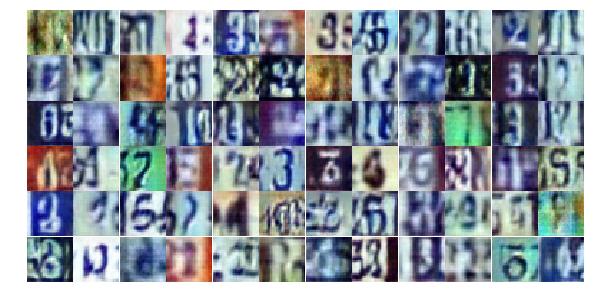

Epoch 11/25... Discriminator Loss: 0.6019... Generator Loss: 1.1470
Epoch 11/25... Discriminator Loss: 0.3987... Generator Loss: 1.8690
Epoch 11/25... Discriminator Loss: 0.6691... Generator Loss: 0.9596
Epoch 11/25... Discriminator Loss: 0.6439... Generator Loss: 1.0103
Epoch 11/25... Discriminator Loss: 0.4112... Generator Loss: 1.5012
Epoch 11/25... Discriminator Loss: 0.4150... Generator Loss: 1.7619
Epoch 11/25... Discriminator Loss: 0.4614... Generator Loss: 1.5333
Epoch 11/25... Discriminator Loss: 1.1569... Generator Loss: 0.4890
Epoch 11/25... Discriminator Loss: 0.3604... Generator Loss: 1.8245
Epoch 11/25... Discriminator Loss: 0.6544... Generator Loss: 1.0939


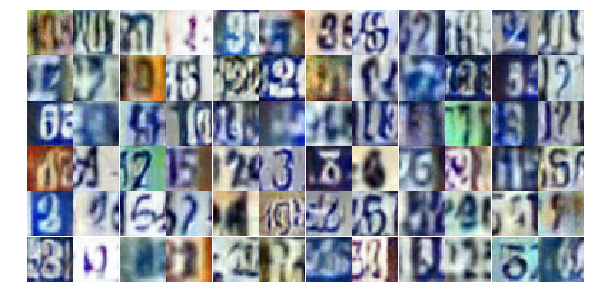

Epoch 11/25... Discriminator Loss: 1.1823... Generator Loss: 0.4931
Epoch 11/25... Discriminator Loss: 0.6110... Generator Loss: 1.3865
Epoch 11/25... Discriminator Loss: 0.9898... Generator Loss: 0.6788
Epoch 11/25... Discriminator Loss: 0.5118... Generator Loss: 1.2091
Epoch 11/25... Discriminator Loss: 0.7444... Generator Loss: 0.8722
Epoch 11/25... Discriminator Loss: 1.2065... Generator Loss: 0.4895
Epoch 11/25... Discriminator Loss: 1.3844... Generator Loss: 0.4335
Epoch 11/25... Discriminator Loss: 1.1943... Generator Loss: 0.4957
Epoch 11/25... Discriminator Loss: 0.4793... Generator Loss: 1.3373
Epoch 11/25... Discriminator Loss: 1.0269... Generator Loss: 0.5692


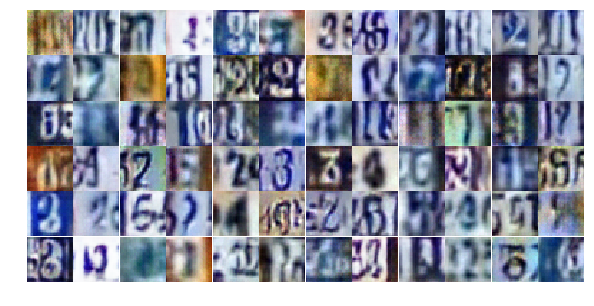

Epoch 11/25... Discriminator Loss: 0.5366... Generator Loss: 1.4088
Epoch 11/25... Discriminator Loss: 0.4662... Generator Loss: 1.4603
Epoch 11/25... Discriminator Loss: 0.5249... Generator Loss: 1.3734
Epoch 11/25... Discriminator Loss: 0.7881... Generator Loss: 0.7937
Epoch 11/25... Discriminator Loss: 0.7280... Generator Loss: 0.9591
Epoch 11/25... Discriminator Loss: 0.6483... Generator Loss: 0.9729
Epoch 11/25... Discriminator Loss: 0.3191... Generator Loss: 2.0516
Epoch 11/25... Discriminator Loss: 0.5940... Generator Loss: 1.4316
Epoch 11/25... Discriminator Loss: 1.8576... Generator Loss: 0.2284
Epoch 11/25... Discriminator Loss: 0.5150... Generator Loss: 1.2617


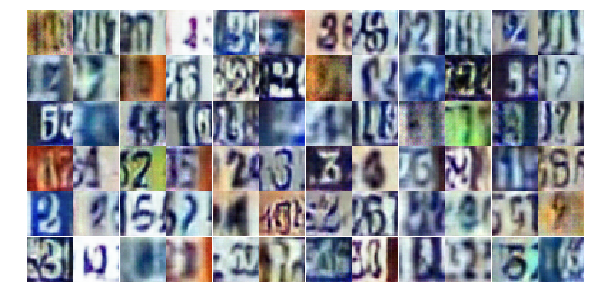

Epoch 11/25... Discriminator Loss: 0.6441... Generator Loss: 1.2331
Epoch 11/25... Discriminator Loss: 0.3560... Generator Loss: 1.8852
Epoch 11/25... Discriminator Loss: 0.5020... Generator Loss: 1.8699
Epoch 11/25... Discriminator Loss: 0.7609... Generator Loss: 0.8454
Epoch 11/25... Discriminator Loss: 1.2947... Generator Loss: 0.4460
Epoch 11/25... Discriminator Loss: 0.4447... Generator Loss: 1.4518
Epoch 11/25... Discriminator Loss: 1.0598... Generator Loss: 0.5929
Epoch 11/25... Discriminator Loss: 0.4709... Generator Loss: 1.8629
Epoch 11/25... Discriminator Loss: 0.8957... Generator Loss: 0.7162
Epoch 11/25... Discriminator Loss: 0.8369... Generator Loss: 0.8395


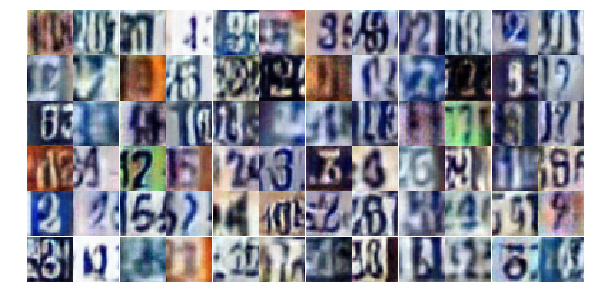

Epoch 12/25... Discriminator Loss: 0.8190... Generator Loss: 1.0470
Epoch 12/25... Discriminator Loss: 0.6257... Generator Loss: 1.5274
Epoch 12/25... Discriminator Loss: 0.6990... Generator Loss: 1.0281
Epoch 12/25... Discriminator Loss: 0.4197... Generator Loss: 1.8569
Epoch 12/25... Discriminator Loss: 0.4423... Generator Loss: 1.4455
Epoch 12/25... Discriminator Loss: 1.0062... Generator Loss: 0.6163
Epoch 12/25... Discriminator Loss: 1.2017... Generator Loss: 3.0502
Epoch 12/25... Discriminator Loss: 1.1250... Generator Loss: 0.6988
Epoch 12/25... Discriminator Loss: 0.8091... Generator Loss: 1.0009
Epoch 12/25... Discriminator Loss: 1.1496... Generator Loss: 0.5255


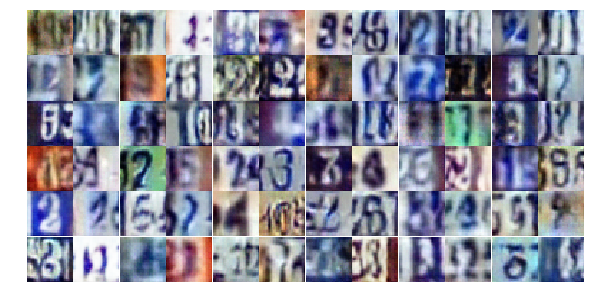

Epoch 12/25... Discriminator Loss: 0.5728... Generator Loss: 1.1556
Epoch 12/25... Discriminator Loss: 0.7799... Generator Loss: 0.9811
Epoch 12/25... Discriminator Loss: 0.5180... Generator Loss: 1.2850
Epoch 12/25... Discriminator Loss: 0.5833... Generator Loss: 1.3279
Epoch 12/25... Discriminator Loss: 0.5504... Generator Loss: 1.6853
Epoch 12/25... Discriminator Loss: 0.9024... Generator Loss: 0.7144
Epoch 12/25... Discriminator Loss: 1.6038... Generator Loss: 0.2828
Epoch 12/25... Discriminator Loss: 0.5189... Generator Loss: 1.3612
Epoch 12/25... Discriminator Loss: 0.5388... Generator Loss: 1.2645
Epoch 12/25... Discriminator Loss: 0.8228... Generator Loss: 0.8277


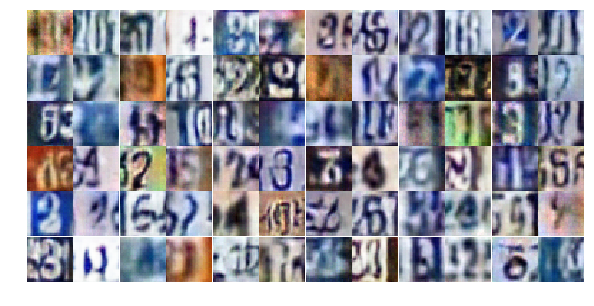

Epoch 12/25... Discriminator Loss: 0.3035... Generator Loss: 2.1749
Epoch 12/25... Discriminator Loss: 0.3735... Generator Loss: 2.3418
Epoch 12/25... Discriminator Loss: 0.6857... Generator Loss: 1.0198
Epoch 12/25... Discriminator Loss: 0.5716... Generator Loss: 1.3438
Epoch 12/25... Discriminator Loss: 0.2947... Generator Loss: 1.9333
Epoch 12/25... Discriminator Loss: 0.4949... Generator Loss: 1.3578
Epoch 12/25... Discriminator Loss: 0.5223... Generator Loss: 1.2553
Epoch 12/25... Discriminator Loss: 0.3494... Generator Loss: 1.8439
Epoch 12/25... Discriminator Loss: 0.5045... Generator Loss: 1.8559
Epoch 12/25... Discriminator Loss: 0.5335... Generator Loss: 1.3972


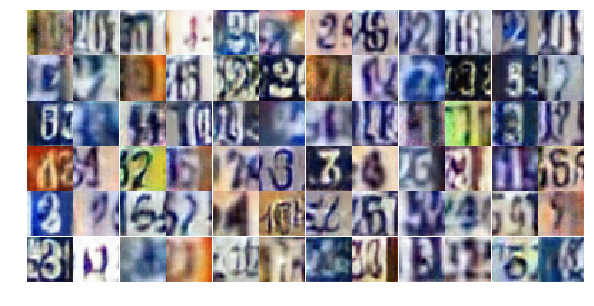

Epoch 12/25... Discriminator Loss: 0.4036... Generator Loss: 1.5086
Epoch 12/25... Discriminator Loss: 0.7684... Generator Loss: 0.9973
Epoch 12/25... Discriminator Loss: 0.8372... Generator Loss: 0.7601
Epoch 12/25... Discriminator Loss: 1.8979... Generator Loss: 0.2405
Epoch 12/25... Discriminator Loss: 0.4422... Generator Loss: 1.8156
Epoch 12/25... Discriminator Loss: 0.6336... Generator Loss: 1.1463
Epoch 12/25... Discriminator Loss: 1.0469... Generator Loss: 0.6102
Epoch 12/25... Discriminator Loss: 0.5545... Generator Loss: 1.4077
Epoch 12/25... Discriminator Loss: 0.4474... Generator Loss: 1.6003
Epoch 12/25... Discriminator Loss: 0.2879... Generator Loss: 2.5385


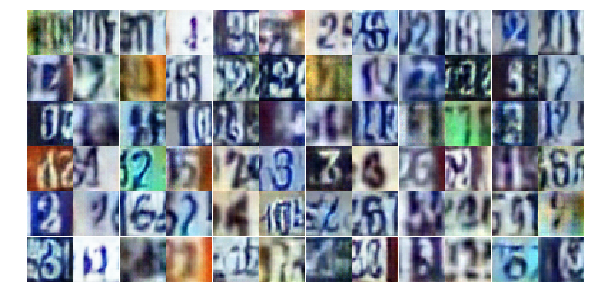

Epoch 12/25... Discriminator Loss: 0.5373... Generator Loss: 1.2145
Epoch 12/25... Discriminator Loss: 0.4053... Generator Loss: 1.7139
Epoch 12/25... Discriminator Loss: 0.4247... Generator Loss: 1.4386
Epoch 12/25... Discriminator Loss: 0.6463... Generator Loss: 1.0966
Epoch 12/25... Discriminator Loss: 0.6772... Generator Loss: 1.3558
Epoch 12/25... Discriminator Loss: 1.0348... Generator Loss: 1.5181
Epoch 12/25... Discriminator Loss: 0.6377... Generator Loss: 1.0312
Epoch 12/25... Discriminator Loss: 0.7072... Generator Loss: 0.9419
Epoch 12/25... Discriminator Loss: 0.3971... Generator Loss: 1.9448
Epoch 12/25... Discriminator Loss: 0.4484... Generator Loss: 1.8255


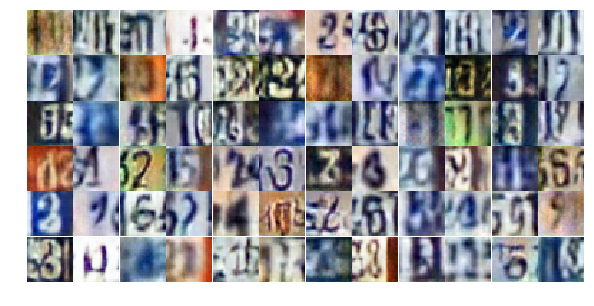

Epoch 12/25... Discriminator Loss: 0.9219... Generator Loss: 0.7426
Epoch 12/25... Discriminator Loss: 0.3694... Generator Loss: 1.8793
Epoch 12/25... Discriminator Loss: 0.6334... Generator Loss: 1.4185
Epoch 12/25... Discriminator Loss: 0.8801... Generator Loss: 0.7831
Epoch 12/25... Discriminator Loss: 0.4397... Generator Loss: 1.4954
Epoch 12/25... Discriminator Loss: 0.6721... Generator Loss: 2.4964
Epoch 12/25... Discriminator Loss: 0.9581... Generator Loss: 0.6958
Epoch 13/25... Discriminator Loss: 0.4817... Generator Loss: 1.3525
Epoch 13/25... Discriminator Loss: 0.4703... Generator Loss: 1.4020
Epoch 13/25... Discriminator Loss: 1.0566... Generator Loss: 0.5821


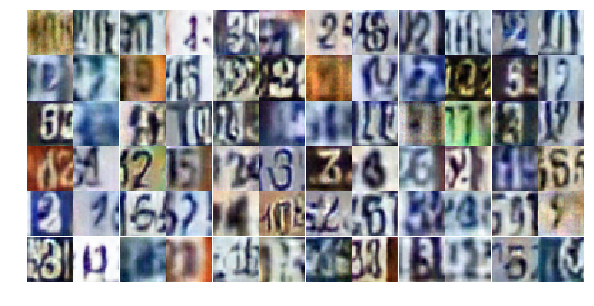

Epoch 13/25... Discriminator Loss: 0.7943... Generator Loss: 0.8364
Epoch 13/25... Discriminator Loss: 0.3383... Generator Loss: 2.1525
Epoch 13/25... Discriminator Loss: 0.6449... Generator Loss: 1.4756
Epoch 13/25... Discriminator Loss: 1.4267... Generator Loss: 0.5177
Epoch 13/25... Discriminator Loss: 1.5983... Generator Loss: 3.6176
Epoch 13/25... Discriminator Loss: 0.6443... Generator Loss: 1.1150
Epoch 13/25... Discriminator Loss: 0.5252... Generator Loss: 1.7436
Epoch 13/25... Discriminator Loss: 0.6056... Generator Loss: 1.0893
Epoch 13/25... Discriminator Loss: 0.6287... Generator Loss: 1.0784
Epoch 13/25... Discriminator Loss: 0.6863... Generator Loss: 1.0318


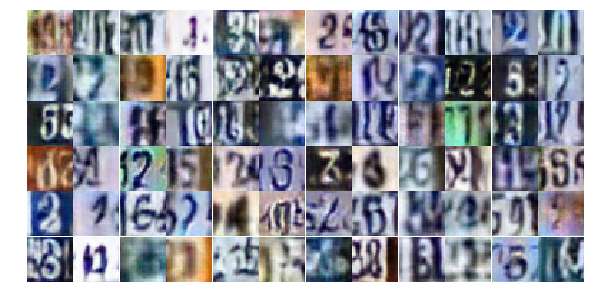

Epoch 13/25... Discriminator Loss: 0.5808... Generator Loss: 1.1274
Epoch 13/25... Discriminator Loss: 0.4434... Generator Loss: 1.5017
Epoch 13/25... Discriminator Loss: 1.4080... Generator Loss: 1.2729
Epoch 13/25... Discriminator Loss: 0.6789... Generator Loss: 1.3298
Epoch 13/25... Discriminator Loss: 0.5713... Generator Loss: 1.1657
Epoch 13/25... Discriminator Loss: 0.7780... Generator Loss: 0.9161
Epoch 13/25... Discriminator Loss: 0.6255... Generator Loss: 1.2791
Epoch 13/25... Discriminator Loss: 1.1232... Generator Loss: 0.5664
Epoch 13/25... Discriminator Loss: 0.5417... Generator Loss: 1.2364
Epoch 13/25... Discriminator Loss: 0.8857... Generator Loss: 0.7267


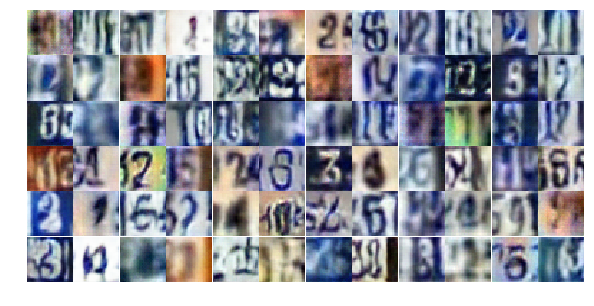

Epoch 13/25... Discriminator Loss: 0.6728... Generator Loss: 1.1246
Epoch 13/25... Discriminator Loss: 0.5515... Generator Loss: 1.3547
Epoch 13/25... Discriminator Loss: 0.6144... Generator Loss: 1.1769
Epoch 13/25... Discriminator Loss: 0.6676... Generator Loss: 0.9626
Epoch 13/25... Discriminator Loss: 0.8036... Generator Loss: 0.7819
Epoch 13/25... Discriminator Loss: 0.6539... Generator Loss: 1.0774
Epoch 13/25... Discriminator Loss: 0.6524... Generator Loss: 1.5362
Epoch 13/25... Discriminator Loss: 0.4804... Generator Loss: 1.4849
Epoch 13/25... Discriminator Loss: 0.5814... Generator Loss: 1.2289
Epoch 13/25... Discriminator Loss: 0.4865... Generator Loss: 1.3539


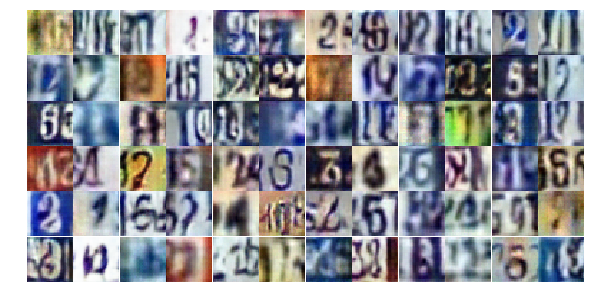

Epoch 13/25... Discriminator Loss: 0.9706... Generator Loss: 0.6757
Epoch 13/25... Discriminator Loss: 0.8734... Generator Loss: 1.1080
Epoch 13/25... Discriminator Loss: 1.2147... Generator Loss: 0.4793
Epoch 13/25... Discriminator Loss: 1.3752... Generator Loss: 0.4380
Epoch 13/25... Discriminator Loss: 0.5900... Generator Loss: 1.2762
Epoch 13/25... Discriminator Loss: 0.3970... Generator Loss: 1.8555
Epoch 13/25... Discriminator Loss: 0.4988... Generator Loss: 1.4102
Epoch 13/25... Discriminator Loss: 1.0132... Generator Loss: 0.6289
Epoch 13/25... Discriminator Loss: 0.6704... Generator Loss: 1.0375
Epoch 13/25... Discriminator Loss: 0.5955... Generator Loss: 1.3570


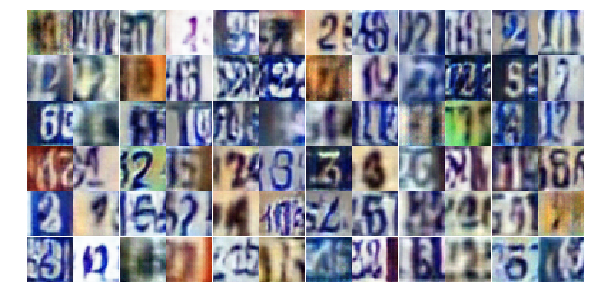

Epoch 13/25... Discriminator Loss: 0.5048... Generator Loss: 1.7962
Epoch 13/25... Discriminator Loss: 1.2517... Generator Loss: 0.6893
Epoch 13/25... Discriminator Loss: 0.6554... Generator Loss: 1.1399
Epoch 13/25... Discriminator Loss: 0.5947... Generator Loss: 1.2899
Epoch 13/25... Discriminator Loss: 1.0398... Generator Loss: 0.5928
Epoch 13/25... Discriminator Loss: 0.5322... Generator Loss: 1.7662
Epoch 13/25... Discriminator Loss: 0.5568... Generator Loss: 1.3505
Epoch 13/25... Discriminator Loss: 0.5373... Generator Loss: 1.5108
Epoch 13/25... Discriminator Loss: 1.4376... Generator Loss: 0.4151
Epoch 13/25... Discriminator Loss: 0.7932... Generator Loss: 0.8917


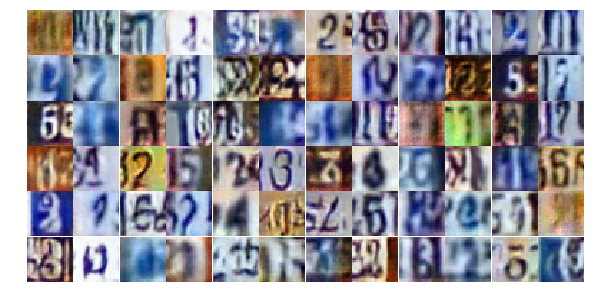

Epoch 13/25... Discriminator Loss: 0.2927... Generator Loss: 2.1479
Epoch 13/25... Discriminator Loss: 1.6238... Generator Loss: 0.3188
Epoch 13/25... Discriminator Loss: 0.7391... Generator Loss: 0.8579
Epoch 13/25... Discriminator Loss: 1.0502... Generator Loss: 0.5771
Epoch 14/25... Discriminator Loss: 0.8593... Generator Loss: 0.7538
Epoch 14/25... Discriminator Loss: 0.8166... Generator Loss: 0.9296
Epoch 14/25... Discriminator Loss: 1.3205... Generator Loss: 0.5118
Epoch 14/25... Discriminator Loss: 0.5635... Generator Loss: 1.6511
Epoch 14/25... Discriminator Loss: 0.6332... Generator Loss: 1.0533
Epoch 14/25... Discriminator Loss: 1.2980... Generator Loss: 0.4994


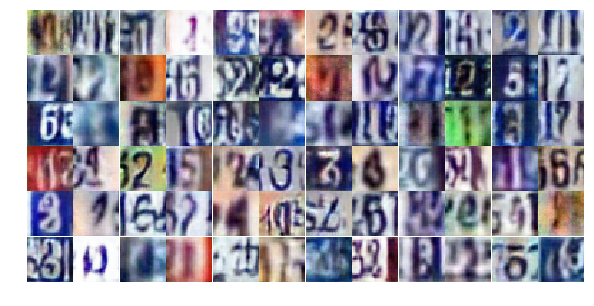

Epoch 14/25... Discriminator Loss: 1.4878... Generator Loss: 3.1040
Epoch 14/25... Discriminator Loss: 0.9441... Generator Loss: 0.7641
Epoch 14/25... Discriminator Loss: 0.6574... Generator Loss: 1.1122
Epoch 14/25... Discriminator Loss: 0.7184... Generator Loss: 0.9557
Epoch 14/25... Discriminator Loss: 1.2392... Generator Loss: 0.4974
Epoch 14/25... Discriminator Loss: 0.3972... Generator Loss: 1.3894
Epoch 14/25... Discriminator Loss: 0.2903... Generator Loss: 2.1698
Epoch 14/25... Discriminator Loss: 1.3615... Generator Loss: 0.4055
Epoch 14/25... Discriminator Loss: 2.2002... Generator Loss: 0.1764
Epoch 14/25... Discriminator Loss: 1.8658... Generator Loss: 0.3043


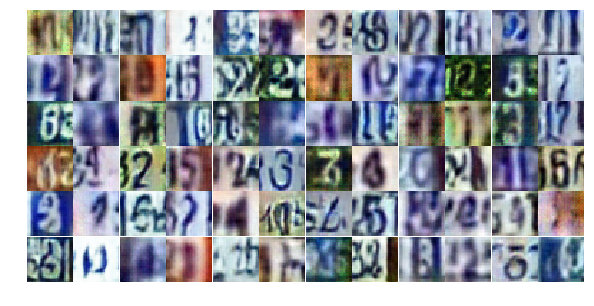

Epoch 14/25... Discriminator Loss: 0.6518... Generator Loss: 1.0522
Epoch 14/25... Discriminator Loss: 0.5432... Generator Loss: 1.3758
Epoch 14/25... Discriminator Loss: 0.9042... Generator Loss: 0.7559
Epoch 14/25... Discriminator Loss: 0.4579... Generator Loss: 1.5679
Epoch 14/25... Discriminator Loss: 0.8205... Generator Loss: 0.8862
Epoch 14/25... Discriminator Loss: 0.7149... Generator Loss: 1.0085
Epoch 14/25... Discriminator Loss: 0.5563... Generator Loss: 1.2672
Epoch 14/25... Discriminator Loss: 0.6464... Generator Loss: 1.0502
Epoch 14/25... Discriminator Loss: 0.4590... Generator Loss: 1.3125
Epoch 14/25... Discriminator Loss: 0.3958... Generator Loss: 1.9929


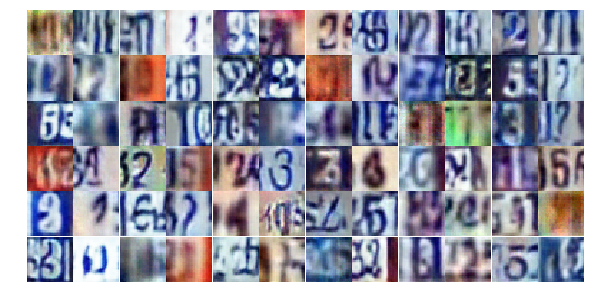

Epoch 14/25... Discriminator Loss: 0.9414... Generator Loss: 0.7596
Epoch 14/25... Discriminator Loss: 0.4468... Generator Loss: 1.4143
Epoch 14/25... Discriminator Loss: 0.5453... Generator Loss: 2.1910
Epoch 14/25... Discriminator Loss: 0.4755... Generator Loss: 1.6469
Epoch 14/25... Discriminator Loss: 0.7416... Generator Loss: 1.0415
Epoch 14/25... Discriminator Loss: 0.6427... Generator Loss: 1.1958
Epoch 14/25... Discriminator Loss: 0.6309... Generator Loss: 1.0896
Epoch 14/25... Discriminator Loss: 0.5020... Generator Loss: 1.5915
Epoch 14/25... Discriminator Loss: 0.3296... Generator Loss: 2.2461
Epoch 14/25... Discriminator Loss: 0.8334... Generator Loss: 0.8893


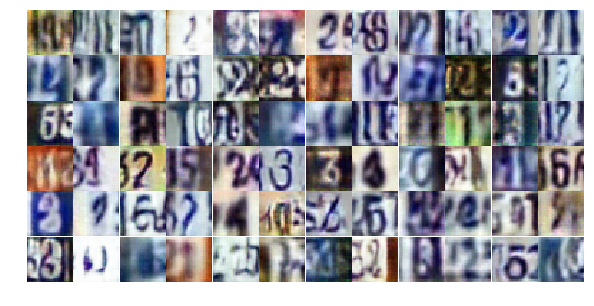

Epoch 14/25... Discriminator Loss: 0.9437... Generator Loss: 0.7557
Epoch 14/25... Discriminator Loss: 0.7790... Generator Loss: 1.6810
Epoch 14/25... Discriminator Loss: 1.1753... Generator Loss: 0.5134
Epoch 14/25... Discriminator Loss: 0.8895... Generator Loss: 0.7430
Epoch 14/25... Discriminator Loss: 0.9079... Generator Loss: 0.7720
Epoch 14/25... Discriminator Loss: 0.8627... Generator Loss: 0.8586
Epoch 14/25... Discriminator Loss: 0.8486... Generator Loss: 0.7799
Epoch 14/25... Discriminator Loss: 0.6683... Generator Loss: 0.9546
Epoch 14/25... Discriminator Loss: 1.6289... Generator Loss: 0.5777
Epoch 14/25... Discriminator Loss: 0.7132... Generator Loss: 1.3871


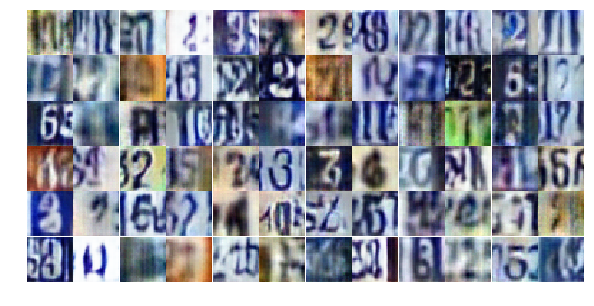

Epoch 14/25... Discriminator Loss: 0.8150... Generator Loss: 1.2569
Epoch 14/25... Discriminator Loss: 1.2386... Generator Loss: 0.4496
Epoch 14/25... Discriminator Loss: 0.5047... Generator Loss: 1.4778
Epoch 14/25... Discriminator Loss: 0.7613... Generator Loss: 0.9099
Epoch 14/25... Discriminator Loss: 0.5815... Generator Loss: 1.0874
Epoch 14/25... Discriminator Loss: 0.5623... Generator Loss: 1.2125
Epoch 14/25... Discriminator Loss: 0.7310... Generator Loss: 0.9587
Epoch 14/25... Discriminator Loss: 0.6489... Generator Loss: 1.1034
Epoch 14/25... Discriminator Loss: 0.9690... Generator Loss: 0.6994
Epoch 14/25... Discriminator Loss: 1.3500... Generator Loss: 0.4093


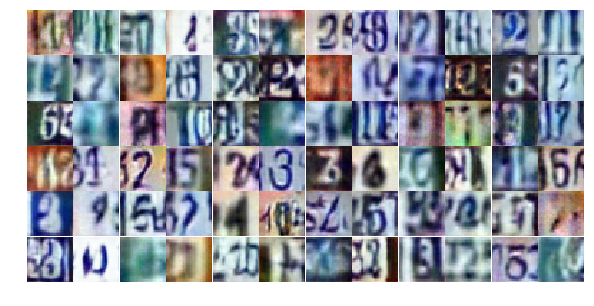

Epoch 14/25... Discriminator Loss: 0.7312... Generator Loss: 0.9937
Epoch 14/25... Discriminator Loss: 0.9332... Generator Loss: 0.9703
Epoch 15/25... Discriminator Loss: 0.8762... Generator Loss: 0.8163
Epoch 15/25... Discriminator Loss: 0.4938... Generator Loss: 1.4401
Epoch 15/25... Discriminator Loss: 0.5981... Generator Loss: 1.1399
Epoch 15/25... Discriminator Loss: 0.7675... Generator Loss: 0.8654
Epoch 15/25... Discriminator Loss: 0.7539... Generator Loss: 0.8859
Epoch 15/25... Discriminator Loss: 0.5054... Generator Loss: 1.6908
Epoch 15/25... Discriminator Loss: 1.4683... Generator Loss: 0.3893
Epoch 15/25... Discriminator Loss: 0.6382... Generator Loss: 1.1025


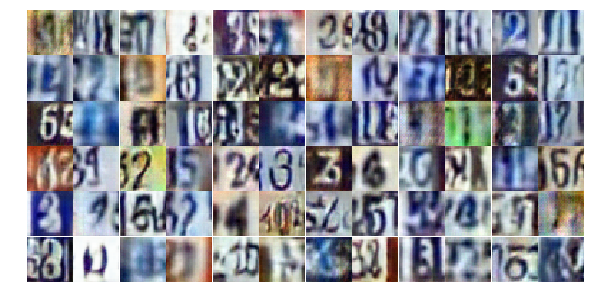

Epoch 15/25... Discriminator Loss: 0.5282... Generator Loss: 1.6594
Epoch 15/25... Discriminator Loss: 0.5700... Generator Loss: 1.4822
Epoch 15/25... Discriminator Loss: 0.8586... Generator Loss: 0.7816
Epoch 15/25... Discriminator Loss: 0.6241... Generator Loss: 1.1403
Epoch 15/25... Discriminator Loss: 0.7393... Generator Loss: 0.9859
Epoch 15/25... Discriminator Loss: 0.3524... Generator Loss: 1.8957
Epoch 15/25... Discriminator Loss: 1.1472... Generator Loss: 0.5693
Epoch 15/25... Discriminator Loss: 0.6690... Generator Loss: 1.4984
Epoch 15/25... Discriminator Loss: 0.4334... Generator Loss: 2.7325
Epoch 15/25... Discriminator Loss: 1.2506... Generator Loss: 0.5113


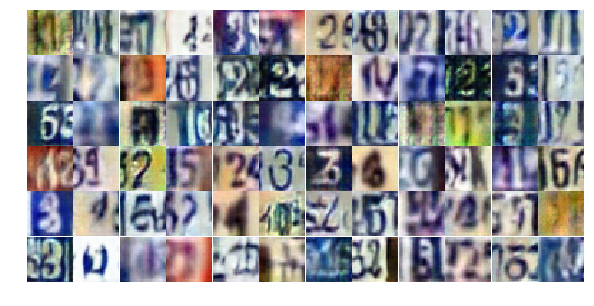

Epoch 15/25... Discriminator Loss: 1.2603... Generator Loss: 0.5660
Epoch 15/25... Discriminator Loss: 0.4885... Generator Loss: 1.5177
Epoch 15/25... Discriminator Loss: 0.5087... Generator Loss: 1.5705
Epoch 15/25... Discriminator Loss: 1.8311... Generator Loss: 0.2805
Epoch 15/25... Discriminator Loss: 1.4144... Generator Loss: 0.4823
Epoch 15/25... Discriminator Loss: 1.2459... Generator Loss: 0.5254
Epoch 15/25... Discriminator Loss: 0.7549... Generator Loss: 1.0324
Epoch 15/25... Discriminator Loss: 0.8295... Generator Loss: 0.8292
Epoch 15/25... Discriminator Loss: 0.5434... Generator Loss: 1.2486
Epoch 15/25... Discriminator Loss: 1.5410... Generator Loss: 0.3620


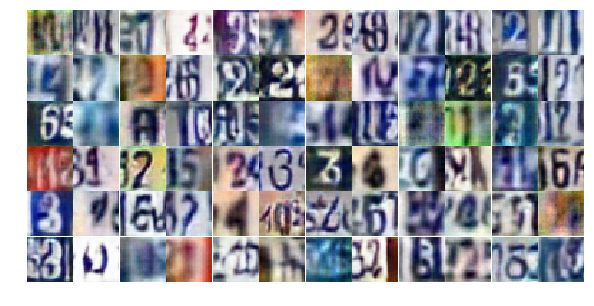

Epoch 15/25... Discriminator Loss: 0.8815... Generator Loss: 0.7504
Epoch 15/25... Discriminator Loss: 0.9016... Generator Loss: 0.7762
Epoch 15/25... Discriminator Loss: 0.4125... Generator Loss: 1.7176
Epoch 15/25... Discriminator Loss: 0.4747... Generator Loss: 1.4350
Epoch 15/25... Discriminator Loss: 0.5434... Generator Loss: 1.2328
Epoch 15/25... Discriminator Loss: 0.8933... Generator Loss: 1.9682
Epoch 15/25... Discriminator Loss: 0.5352... Generator Loss: 1.2968
Epoch 15/25... Discriminator Loss: 0.5238... Generator Loss: 1.2479
Epoch 15/25... Discriminator Loss: 0.5408... Generator Loss: 1.3099
Epoch 15/25... Discriminator Loss: 0.7750... Generator Loss: 0.8126


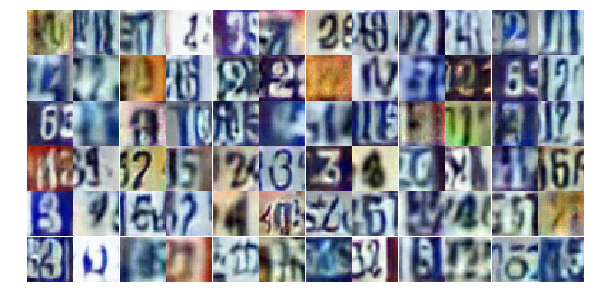

Epoch 15/25... Discriminator Loss: 0.7205... Generator Loss: 0.9436
Epoch 15/25... Discriminator Loss: 1.2182... Generator Loss: 0.5547
Epoch 15/25... Discriminator Loss: 0.8681... Generator Loss: 0.7595
Epoch 15/25... Discriminator Loss: 0.4080... Generator Loss: 1.7455
Epoch 15/25... Discriminator Loss: 1.0232... Generator Loss: 0.6471
Epoch 15/25... Discriminator Loss: 1.8795... Generator Loss: 0.2185
Epoch 15/25... Discriminator Loss: 0.3752... Generator Loss: 1.7443
Epoch 15/25... Discriminator Loss: 0.7609... Generator Loss: 1.4862
Epoch 15/25... Discriminator Loss: 0.7781... Generator Loss: 0.8511
Epoch 15/25... Discriminator Loss: 0.9258... Generator Loss: 0.7666


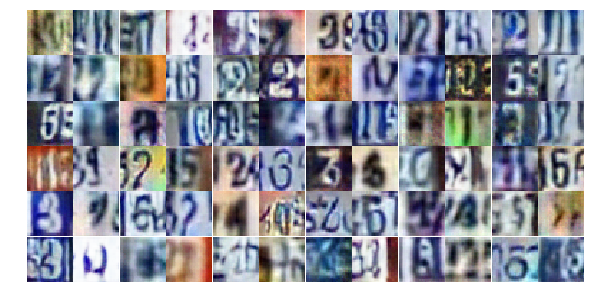

Epoch 15/25... Discriminator Loss: 0.8173... Generator Loss: 0.8430
Epoch 15/25... Discriminator Loss: 0.6941... Generator Loss: 1.2194
Epoch 15/25... Discriminator Loss: 0.4929... Generator Loss: 1.9993
Epoch 15/25... Discriminator Loss: 1.0372... Generator Loss: 0.6786
Epoch 15/25... Discriminator Loss: 0.7447... Generator Loss: 0.8691
Epoch 15/25... Discriminator Loss: 0.9341... Generator Loss: 2.4799
Epoch 15/25... Discriminator Loss: 1.3956... Generator Loss: 0.4287
Epoch 15/25... Discriminator Loss: 0.5081... Generator Loss: 1.6667
Epoch 15/25... Discriminator Loss: 1.3013... Generator Loss: 0.4481
Epoch 16/25... Discriminator Loss: 1.1199... Generator Loss: 0.5908


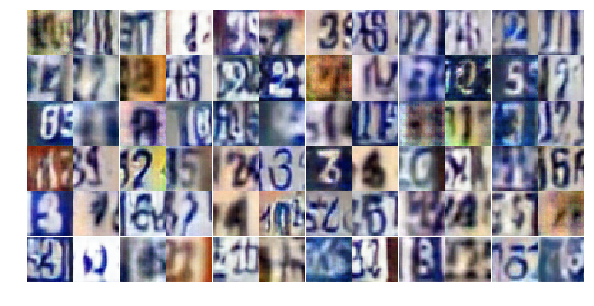

Epoch 16/25... Discriminator Loss: 0.5749... Generator Loss: 1.1628
Epoch 16/25... Discriminator Loss: 0.6848... Generator Loss: 1.0927
Epoch 16/25... Discriminator Loss: 0.7262... Generator Loss: 1.0131
Epoch 16/25... Discriminator Loss: 0.6620... Generator Loss: 1.0965
Epoch 16/25... Discriminator Loss: 0.5885... Generator Loss: 1.5983
Epoch 16/25... Discriminator Loss: 0.6961... Generator Loss: 1.2083
Epoch 16/25... Discriminator Loss: 1.3690... Generator Loss: 0.4481
Epoch 16/25... Discriminator Loss: 0.8497... Generator Loss: 0.8127
Epoch 16/25... Discriminator Loss: 0.5624... Generator Loss: 1.1968
Epoch 16/25... Discriminator Loss: 0.6985... Generator Loss: 0.9612


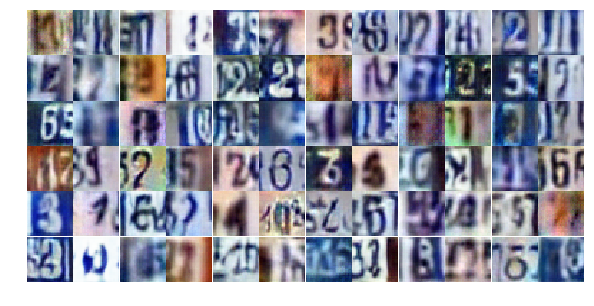

Epoch 16/25... Discriminator Loss: 1.1344... Generator Loss: 0.5295
Epoch 16/25... Discriminator Loss: 0.5799... Generator Loss: 1.1691
Epoch 16/25... Discriminator Loss: 0.6241... Generator Loss: 1.1361
Epoch 16/25... Discriminator Loss: 1.1195... Generator Loss: 0.5011
Epoch 16/25... Discriminator Loss: 1.3171... Generator Loss: 1.2090
Epoch 16/25... Discriminator Loss: 0.6980... Generator Loss: 0.9614
Epoch 16/25... Discriminator Loss: 1.5452... Generator Loss: 0.4414
Epoch 16/25... Discriminator Loss: 0.4271... Generator Loss: 1.8454
Epoch 16/25... Discriminator Loss: 0.5468... Generator Loss: 1.1871
Epoch 16/25... Discriminator Loss: 0.7120... Generator Loss: 1.2105


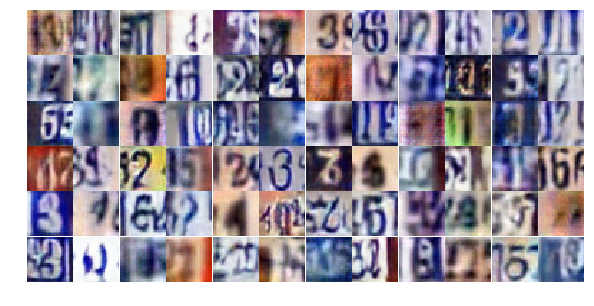

Epoch 16/25... Discriminator Loss: 0.6433... Generator Loss: 1.1711
Epoch 16/25... Discriminator Loss: 0.8464... Generator Loss: 0.8989
Epoch 16/25... Discriminator Loss: 0.9627... Generator Loss: 0.6752
Epoch 16/25... Discriminator Loss: 1.1258... Generator Loss: 0.5112
Epoch 16/25... Discriminator Loss: 0.5938... Generator Loss: 1.5594
Epoch 16/25... Discriminator Loss: 1.3658... Generator Loss: 0.4829
Epoch 16/25... Discriminator Loss: 0.8097... Generator Loss: 0.8470
Epoch 16/25... Discriminator Loss: 0.7572... Generator Loss: 1.0192
Epoch 16/25... Discriminator Loss: 0.9153... Generator Loss: 0.8529
Epoch 16/25... Discriminator Loss: 0.5663... Generator Loss: 1.2026


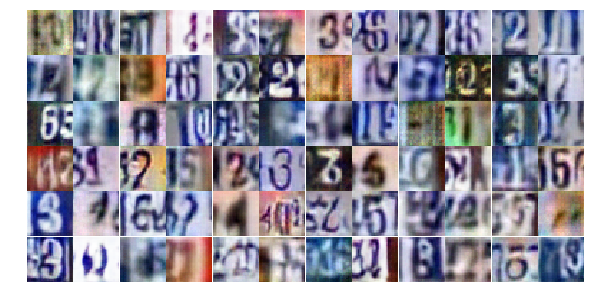

Epoch 16/25... Discriminator Loss: 0.5570... Generator Loss: 1.1570
Epoch 16/25... Discriminator Loss: 0.4999... Generator Loss: 1.4439
Epoch 16/25... Discriminator Loss: 0.7159... Generator Loss: 0.9634
Epoch 16/25... Discriminator Loss: 0.5047... Generator Loss: 1.4950
Epoch 16/25... Discriminator Loss: 0.7111... Generator Loss: 1.4357
Epoch 16/25... Discriminator Loss: 0.7605... Generator Loss: 2.5262
Epoch 16/25... Discriminator Loss: 0.8198... Generator Loss: 0.8400
Epoch 16/25... Discriminator Loss: 0.9652... Generator Loss: 0.6968
Epoch 16/25... Discriminator Loss: 0.6525... Generator Loss: 1.1076
Epoch 16/25... Discriminator Loss: 0.5235... Generator Loss: 1.4497


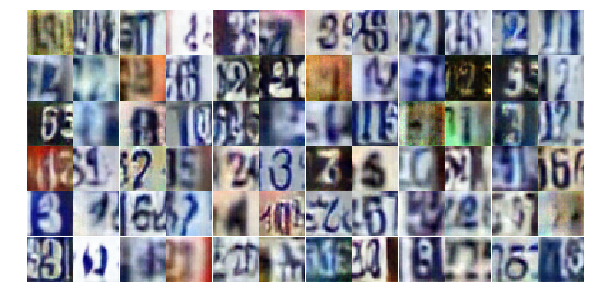

Epoch 16/25... Discriminator Loss: 0.5146... Generator Loss: 1.4447
Epoch 16/25... Discriminator Loss: 0.4699... Generator Loss: 1.6217
Epoch 16/25... Discriminator Loss: 1.2575... Generator Loss: 0.5539
Epoch 16/25... Discriminator Loss: 2.3593... Generator Loss: 4.7036
Epoch 16/25... Discriminator Loss: 2.0442... Generator Loss: 0.2227
Epoch 16/25... Discriminator Loss: 0.9137... Generator Loss: 0.7721
Epoch 16/25... Discriminator Loss: 0.4897... Generator Loss: 1.5877
Epoch 16/25... Discriminator Loss: 1.1242... Generator Loss: 0.6039
Epoch 16/25... Discriminator Loss: 0.5772... Generator Loss: 1.1127
Epoch 16/25... Discriminator Loss: 0.7162... Generator Loss: 0.9888


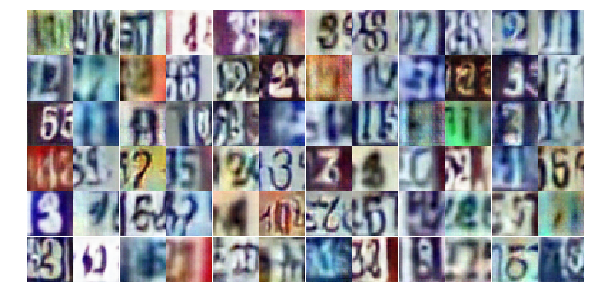

Epoch 16/25... Discriminator Loss: 1.0910... Generator Loss: 0.6513
Epoch 16/25... Discriminator Loss: 0.6050... Generator Loss: 1.1222
Epoch 16/25... Discriminator Loss: 0.7761... Generator Loss: 0.8974
Epoch 16/25... Discriminator Loss: 0.5500... Generator Loss: 1.1796
Epoch 16/25... Discriminator Loss: 0.6040... Generator Loss: 1.2460
Epoch 16/25... Discriminator Loss: 0.8693... Generator Loss: 0.7963
Epoch 17/25... Discriminator Loss: 0.6620... Generator Loss: 1.0471
Epoch 17/25... Discriminator Loss: 0.7800... Generator Loss: 0.9515
Epoch 17/25... Discriminator Loss: 0.7685... Generator Loss: 0.8874
Epoch 17/25... Discriminator Loss: 0.7915... Generator Loss: 0.9561


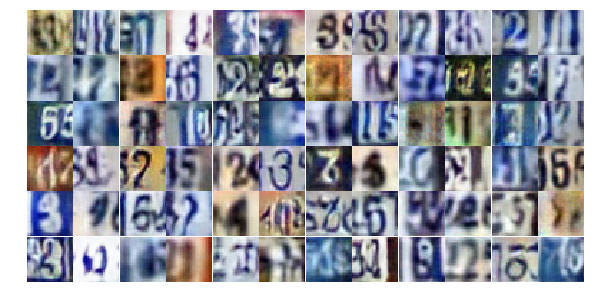

Epoch 17/25... Discriminator Loss: 0.4079... Generator Loss: 1.5598
Epoch 17/25... Discriminator Loss: 0.6339... Generator Loss: 1.0603
Epoch 17/25... Discriminator Loss: 0.8200... Generator Loss: 1.0020
Epoch 17/25... Discriminator Loss: 0.7024... Generator Loss: 1.0017
Epoch 17/25... Discriminator Loss: 0.8445... Generator Loss: 0.7865
Epoch 17/25... Discriminator Loss: 1.1482... Generator Loss: 0.5818
Epoch 17/25... Discriminator Loss: 0.9100... Generator Loss: 0.7335
Epoch 17/25... Discriminator Loss: 0.8060... Generator Loss: 0.8126
Epoch 17/25... Discriminator Loss: 0.6841... Generator Loss: 1.1044
Epoch 17/25... Discriminator Loss: 0.6027... Generator Loss: 1.6022


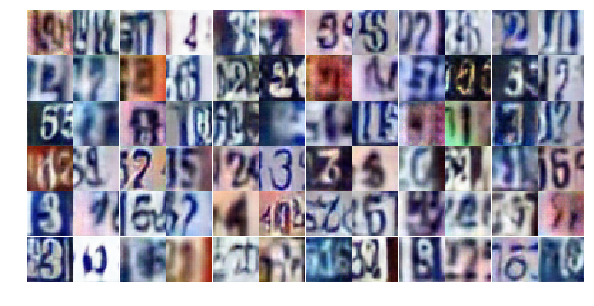

Epoch 17/25... Discriminator Loss: 1.3411... Generator Loss: 2.3838
Epoch 17/25... Discriminator Loss: 0.7122... Generator Loss: 1.9575
Epoch 17/25... Discriminator Loss: 0.6977... Generator Loss: 0.9593
Epoch 17/25... Discriminator Loss: 1.1555... Generator Loss: 0.6190
Epoch 17/25... Discriminator Loss: 0.5994... Generator Loss: 1.2145
Epoch 17/25... Discriminator Loss: 0.8002... Generator Loss: 0.8272
Epoch 17/25... Discriminator Loss: 0.4018... Generator Loss: 2.0475
Epoch 17/25... Discriminator Loss: 0.6566... Generator Loss: 0.9586
Epoch 17/25... Discriminator Loss: 0.6804... Generator Loss: 0.9831
Epoch 17/25... Discriminator Loss: 0.5049... Generator Loss: 1.2899


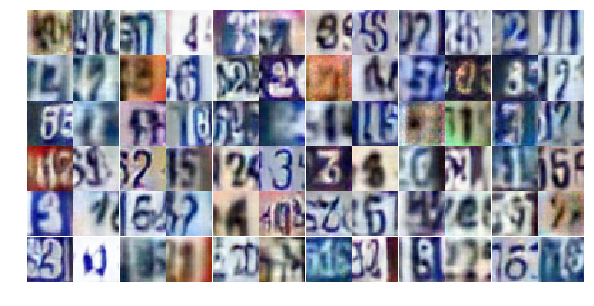

Epoch 17/25... Discriminator Loss: 1.7295... Generator Loss: 0.3100
Epoch 17/25... Discriminator Loss: 0.4059... Generator Loss: 1.7248
Epoch 17/25... Discriminator Loss: 0.6755... Generator Loss: 1.0533
Epoch 17/25... Discriminator Loss: 1.3228... Generator Loss: 0.4403
Epoch 17/25... Discriminator Loss: 1.2660... Generator Loss: 0.4967
Epoch 17/25... Discriminator Loss: 0.5336... Generator Loss: 1.2616
Epoch 17/25... Discriminator Loss: 0.6138... Generator Loss: 1.0358
Epoch 17/25... Discriminator Loss: 0.7672... Generator Loss: 0.9068
Epoch 17/25... Discriminator Loss: 1.1872... Generator Loss: 0.5140
Epoch 17/25... Discriminator Loss: 0.2838... Generator Loss: 2.2798


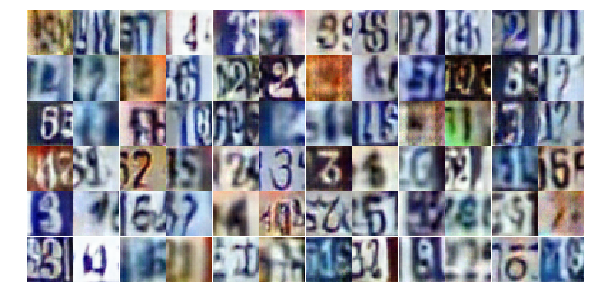

Epoch 17/25... Discriminator Loss: 0.4659... Generator Loss: 1.6302
Epoch 17/25... Discriminator Loss: 0.7915... Generator Loss: 1.3889
Epoch 17/25... Discriminator Loss: 0.8520... Generator Loss: 2.4157
Epoch 17/25... Discriminator Loss: 0.8215... Generator Loss: 0.8574
Epoch 17/25... Discriminator Loss: 1.0814... Generator Loss: 0.6083
Epoch 17/25... Discriminator Loss: 0.5936... Generator Loss: 1.8423
Epoch 17/25... Discriminator Loss: 0.8230... Generator Loss: 0.8607
Epoch 17/25... Discriminator Loss: 0.5039... Generator Loss: 1.3230
Epoch 17/25... Discriminator Loss: 0.3940... Generator Loss: 1.5321
Epoch 17/25... Discriminator Loss: 0.8582... Generator Loss: 0.7526


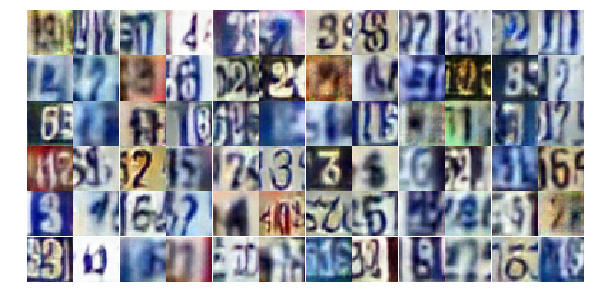

Epoch 17/25... Discriminator Loss: 0.9186... Generator Loss: 1.5483
Epoch 17/25... Discriminator Loss: 0.3235... Generator Loss: 1.9865
Epoch 17/25... Discriminator Loss: 0.9487... Generator Loss: 0.8573
Epoch 17/25... Discriminator Loss: 0.5442... Generator Loss: 1.1326
Epoch 17/25... Discriminator Loss: 0.5729... Generator Loss: 1.2223
Epoch 17/25... Discriminator Loss: 1.1216... Generator Loss: 0.5765
Epoch 17/25... Discriminator Loss: 0.7202... Generator Loss: 0.9270
Epoch 17/25... Discriminator Loss: 0.6582... Generator Loss: 1.0262
Epoch 17/25... Discriminator Loss: 0.6343... Generator Loss: 1.1458
Epoch 17/25... Discriminator Loss: 1.5872... Generator Loss: 0.3414


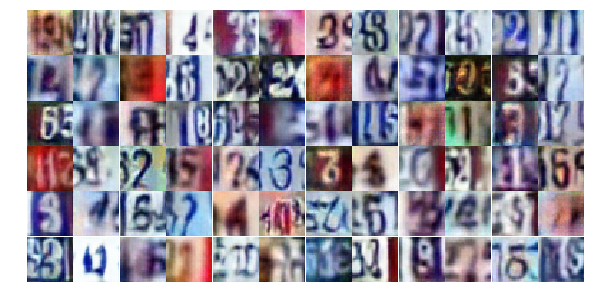

Epoch 17/25... Discriminator Loss: 1.3191... Generator Loss: 0.4854
Epoch 17/25... Discriminator Loss: 0.8728... Generator Loss: 0.9151
Epoch 17/25... Discriminator Loss: 0.5488... Generator Loss: 1.1601
Epoch 17/25... Discriminator Loss: 0.6308... Generator Loss: 1.1877
Epoch 18/25... Discriminator Loss: 1.4280... Generator Loss: 0.4536
Epoch 18/25... Discriminator Loss: 0.9993... Generator Loss: 0.6682
Epoch 18/25... Discriminator Loss: 0.5708... Generator Loss: 1.2384
Epoch 18/25... Discriminator Loss: 0.4629... Generator Loss: 1.3399
Epoch 18/25... Discriminator Loss: 0.7533... Generator Loss: 1.1894
Epoch 18/25... Discriminator Loss: 0.9076... Generator Loss: 0.8097


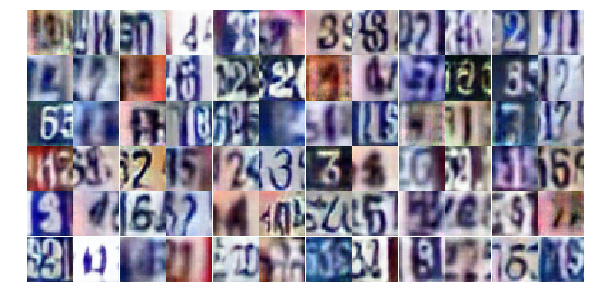

Epoch 18/25... Discriminator Loss: 1.0675... Generator Loss: 1.0181
Epoch 18/25... Discriminator Loss: 1.5387... Generator Loss: 0.4418
Epoch 18/25... Discriminator Loss: 1.1437... Generator Loss: 0.6679
Epoch 18/25... Discriminator Loss: 0.5924... Generator Loss: 1.4606
Epoch 18/25... Discriminator Loss: 0.8935... Generator Loss: 0.8289
Epoch 18/25... Discriminator Loss: 0.9827... Generator Loss: 0.7588
Epoch 18/25... Discriminator Loss: 0.6156... Generator Loss: 1.0723
Epoch 18/25... Discriminator Loss: 0.6987... Generator Loss: 1.0551
Epoch 18/25... Discriminator Loss: 0.5903... Generator Loss: 1.1993
Epoch 18/25... Discriminator Loss: 0.3437... Generator Loss: 1.7699


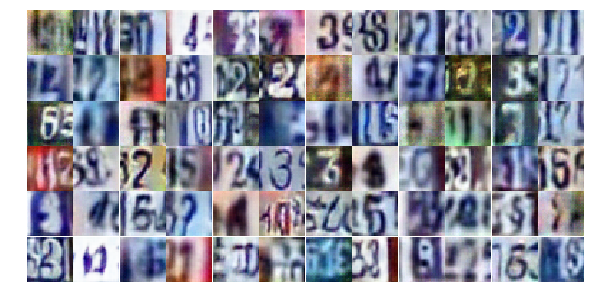

Epoch 18/25... Discriminator Loss: 0.6325... Generator Loss: 1.2522
Epoch 18/25... Discriminator Loss: 0.7385... Generator Loss: 0.9107
Epoch 18/25... Discriminator Loss: 1.1150... Generator Loss: 0.5811
Epoch 18/25... Discriminator Loss: 0.4332... Generator Loss: 1.4646
Epoch 18/25... Discriminator Loss: 0.7522... Generator Loss: 0.8887
Epoch 18/25... Discriminator Loss: 1.1349... Generator Loss: 0.6380
Epoch 18/25... Discriminator Loss: 0.7406... Generator Loss: 1.1017
Epoch 18/25... Discriminator Loss: 0.8473... Generator Loss: 0.7761
Epoch 18/25... Discriminator Loss: 0.8259... Generator Loss: 0.8106
Epoch 18/25... Discriminator Loss: 0.5233... Generator Loss: 1.1877


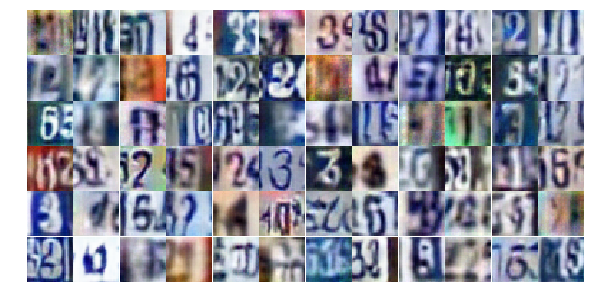

Epoch 18/25... Discriminator Loss: 0.4337... Generator Loss: 1.6080
Epoch 18/25... Discriminator Loss: 0.7566... Generator Loss: 0.9270
Epoch 18/25... Discriminator Loss: 0.7337... Generator Loss: 0.8571
Epoch 18/25... Discriminator Loss: 0.6577... Generator Loss: 1.1110
Epoch 18/25... Discriminator Loss: 0.7059... Generator Loss: 0.9513
Epoch 18/25... Discriminator Loss: 0.4541... Generator Loss: 1.4353
Epoch 18/25... Discriminator Loss: 1.0489... Generator Loss: 0.5937
Epoch 18/25... Discriminator Loss: 0.4114... Generator Loss: 1.8273
Epoch 18/25... Discriminator Loss: 0.8323... Generator Loss: 0.7612
Epoch 18/25... Discriminator Loss: 0.6083... Generator Loss: 1.2638


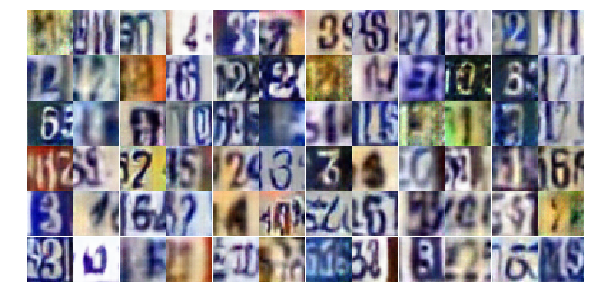

Epoch 18/25... Discriminator Loss: 0.5699... Generator Loss: 1.4366
Epoch 18/25... Discriminator Loss: 0.7140... Generator Loss: 1.0966
Epoch 18/25... Discriminator Loss: 0.6815... Generator Loss: 0.9270
Epoch 18/25... Discriminator Loss: 0.6137... Generator Loss: 1.0572
Epoch 18/25... Discriminator Loss: 1.2565... Generator Loss: 0.4738
Epoch 18/25... Discriminator Loss: 0.4365... Generator Loss: 1.5011
Epoch 18/25... Discriminator Loss: 0.6933... Generator Loss: 1.0780
Epoch 18/25... Discriminator Loss: 1.5745... Generator Loss: 2.9807
Epoch 18/25... Discriminator Loss: 1.1087... Generator Loss: 0.5994
Epoch 18/25... Discriminator Loss: 0.2970... Generator Loss: 1.9688


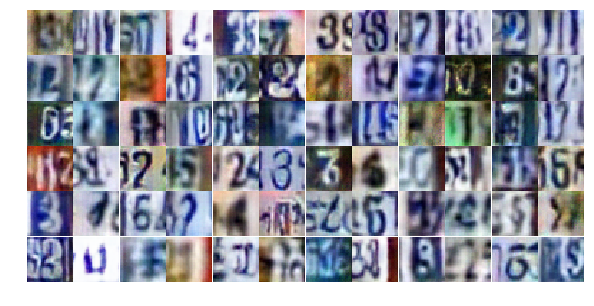

Epoch 18/25... Discriminator Loss: 0.6466... Generator Loss: 1.0466
Epoch 18/25... Discriminator Loss: 0.6119... Generator Loss: 1.2198
Epoch 18/25... Discriminator Loss: 0.7820... Generator Loss: 0.9047
Epoch 18/25... Discriminator Loss: 0.8964... Generator Loss: 0.6874
Epoch 18/25... Discriminator Loss: 0.7852... Generator Loss: 0.8652
Epoch 18/25... Discriminator Loss: 0.7766... Generator Loss: 0.9794
Epoch 18/25... Discriminator Loss: 0.5138... Generator Loss: 1.2641
Epoch 18/25... Discriminator Loss: 0.4019... Generator Loss: 2.0096
Epoch 18/25... Discriminator Loss: 1.0176... Generator Loss: 0.9797
Epoch 18/25... Discriminator Loss: 0.9105... Generator Loss: 0.7569


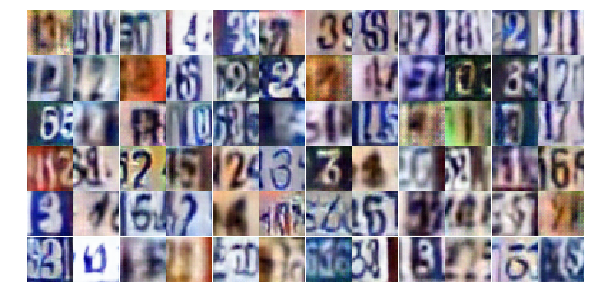

Epoch 18/25... Discriminator Loss: 0.7418... Generator Loss: 1.0015
Epoch 19/25... Discriminator Loss: 0.9106... Generator Loss: 0.7584
Epoch 19/25... Discriminator Loss: 1.1696... Generator Loss: 0.5373
Epoch 19/25... Discriminator Loss: 0.7567... Generator Loss: 1.0143
Epoch 19/25... Discriminator Loss: 0.5364... Generator Loss: 1.1651
Epoch 19/25... Discriminator Loss: 1.0177... Generator Loss: 0.7017
Epoch 19/25... Discriminator Loss: 1.2808... Generator Loss: 0.5363
Epoch 19/25... Discriminator Loss: 1.3269... Generator Loss: 0.5554
Epoch 19/25... Discriminator Loss: 0.6704... Generator Loss: 1.2836
Epoch 19/25... Discriminator Loss: 0.9753... Generator Loss: 0.7564


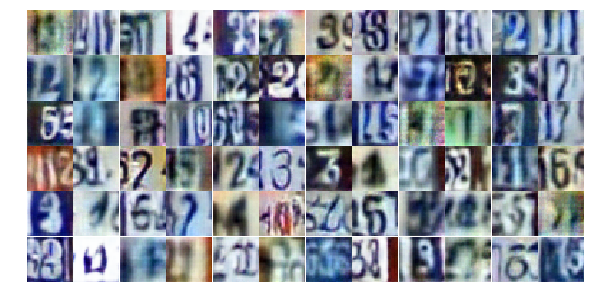

Epoch 19/25... Discriminator Loss: 0.7243... Generator Loss: 0.9390
Epoch 19/25... Discriminator Loss: 0.7102... Generator Loss: 1.0961
Epoch 19/25... Discriminator Loss: 0.9497... Generator Loss: 0.7268
Epoch 19/25... Discriminator Loss: 0.8093... Generator Loss: 0.8760
Epoch 19/25... Discriminator Loss: 0.8079... Generator Loss: 0.8484
Epoch 19/25... Discriminator Loss: 0.9235... Generator Loss: 0.7472
Epoch 19/25... Discriminator Loss: 0.8327... Generator Loss: 0.8374
Epoch 19/25... Discriminator Loss: 0.6722... Generator Loss: 0.9800
Epoch 19/25... Discriminator Loss: 0.5780... Generator Loss: 2.1013
Epoch 19/25... Discriminator Loss: 1.1298... Generator Loss: 0.7280


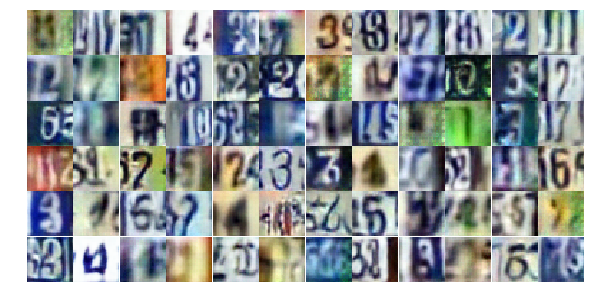

Epoch 19/25... Discriminator Loss: 1.0401... Generator Loss: 0.6232
Epoch 19/25... Discriminator Loss: 0.9084... Generator Loss: 0.8356
Epoch 19/25... Discriminator Loss: 1.1913... Generator Loss: 0.5124
Epoch 19/25... Discriminator Loss: 0.9159... Generator Loss: 0.8236
Epoch 19/25... Discriminator Loss: 1.1462... Generator Loss: 0.5859
Epoch 19/25... Discriminator Loss: 0.9098... Generator Loss: 0.7103
Epoch 19/25... Discriminator Loss: 0.8513... Generator Loss: 0.7405
Epoch 19/25... Discriminator Loss: 0.5938... Generator Loss: 1.0375
Epoch 19/25... Discriminator Loss: 0.5135... Generator Loss: 1.3814
Epoch 19/25... Discriminator Loss: 0.9537... Generator Loss: 0.8178


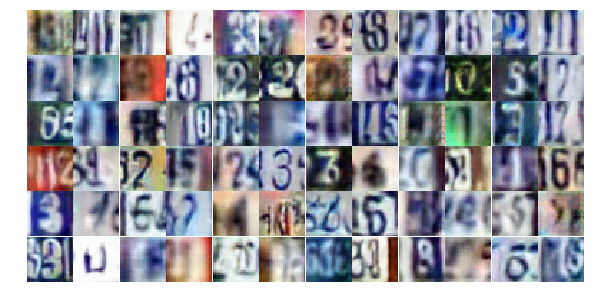

Epoch 19/25... Discriminator Loss: 0.9112... Generator Loss: 1.7215
Epoch 19/25... Discriminator Loss: 0.8693... Generator Loss: 0.7725
Epoch 19/25... Discriminator Loss: 0.7951... Generator Loss: 0.9492
Epoch 19/25... Discriminator Loss: 0.6541... Generator Loss: 1.0784
Epoch 19/25... Discriminator Loss: 0.7621... Generator Loss: 1.6519
Epoch 19/25... Discriminator Loss: 1.4243... Generator Loss: 0.4363
Epoch 19/25... Discriminator Loss: 0.5360... Generator Loss: 1.6972
Epoch 19/25... Discriminator Loss: 0.6750... Generator Loss: 1.2107
Epoch 19/25... Discriminator Loss: 0.6593... Generator Loss: 1.4349
Epoch 19/25... Discriminator Loss: 0.6409... Generator Loss: 1.1239


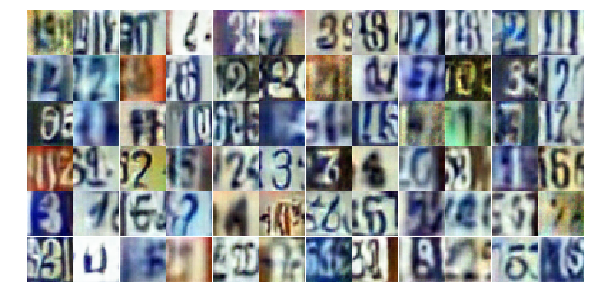

Epoch 19/25... Discriminator Loss: 0.5642... Generator Loss: 1.2476
Epoch 19/25... Discriminator Loss: 1.0966... Generator Loss: 0.6397
Epoch 19/25... Discriminator Loss: 0.9650... Generator Loss: 0.6634
Epoch 19/25... Discriminator Loss: 0.6872... Generator Loss: 1.0194
Epoch 19/25... Discriminator Loss: 0.7230... Generator Loss: 0.9715
Epoch 19/25... Discriminator Loss: 0.8221... Generator Loss: 2.7842
Epoch 19/25... Discriminator Loss: 0.5020... Generator Loss: 1.4590
Epoch 19/25... Discriminator Loss: 0.6541... Generator Loss: 1.1490
Epoch 19/25... Discriminator Loss: 0.6629... Generator Loss: 1.2407
Epoch 19/25... Discriminator Loss: 1.1749... Generator Loss: 0.5732


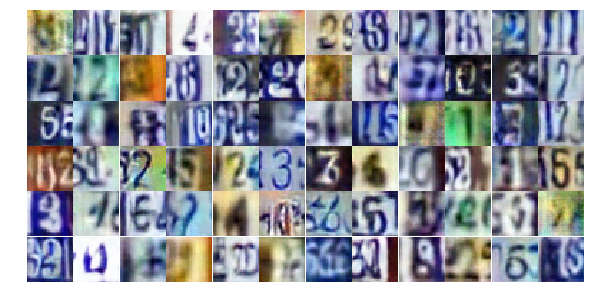

Epoch 19/25... Discriminator Loss: 0.7151... Generator Loss: 0.9675
Epoch 19/25... Discriminator Loss: 0.9360... Generator Loss: 0.8796
Epoch 19/25... Discriminator Loss: 0.6570... Generator Loss: 1.1535
Epoch 19/25... Discriminator Loss: 1.1680... Generator Loss: 0.5621
Epoch 19/25... Discriminator Loss: 0.7590... Generator Loss: 0.9752
Epoch 19/25... Discriminator Loss: 0.7462... Generator Loss: 1.0715
Epoch 19/25... Discriminator Loss: 1.2548... Generator Loss: 0.4903
Epoch 19/25... Discriminator Loss: 0.4322... Generator Loss: 1.5568
Epoch 20/25... Discriminator Loss: 0.6347... Generator Loss: 1.0305
Epoch 20/25... Discriminator Loss: 0.7459... Generator Loss: 0.9324


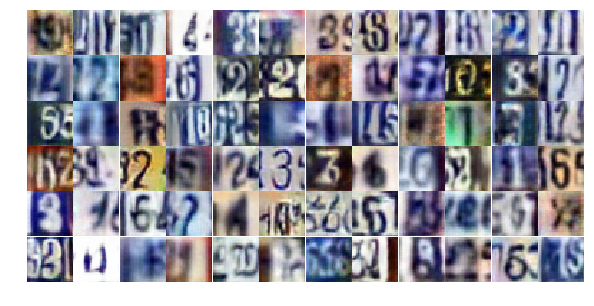

Epoch 20/25... Discriminator Loss: 0.8841... Generator Loss: 0.8182
Epoch 20/25... Discriminator Loss: 0.9045... Generator Loss: 0.7412
Epoch 20/25... Discriminator Loss: 1.1168... Generator Loss: 0.5673
Epoch 20/25... Discriminator Loss: 0.8617... Generator Loss: 0.7894
Epoch 20/25... Discriminator Loss: 0.4587... Generator Loss: 1.8850
Epoch 20/25... Discriminator Loss: 0.5190... Generator Loss: 1.5066
Epoch 20/25... Discriminator Loss: 0.6644... Generator Loss: 1.2855
Epoch 20/25... Discriminator Loss: 0.7824... Generator Loss: 0.9286
Epoch 20/25... Discriminator Loss: 0.6606... Generator Loss: 1.0714
Epoch 20/25... Discriminator Loss: 0.6258... Generator Loss: 1.0615


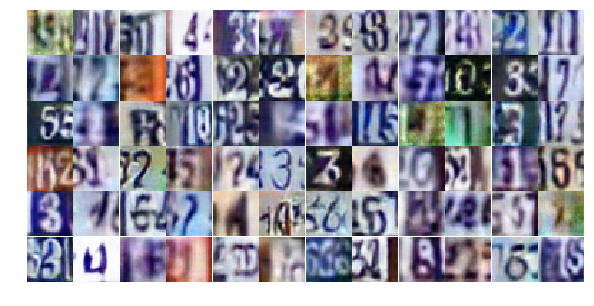

Epoch 20/25... Discriminator Loss: 1.1519... Generator Loss: 0.6874
Epoch 20/25... Discriminator Loss: 1.4247... Generator Loss: 0.4848
Epoch 20/25... Discriminator Loss: 1.3373... Generator Loss: 0.4816
Epoch 20/25... Discriminator Loss: 1.2229... Generator Loss: 0.6424
Epoch 20/25... Discriminator Loss: 1.4233... Generator Loss: 0.4092
Epoch 20/25... Discriminator Loss: 1.1984... Generator Loss: 0.5624
Epoch 20/25... Discriminator Loss: 0.6639... Generator Loss: 1.0351
Epoch 20/25... Discriminator Loss: 0.6879... Generator Loss: 1.0402
Epoch 20/25... Discriminator Loss: 0.7034... Generator Loss: 0.9309
Epoch 20/25... Discriminator Loss: 1.2541... Generator Loss: 0.4910


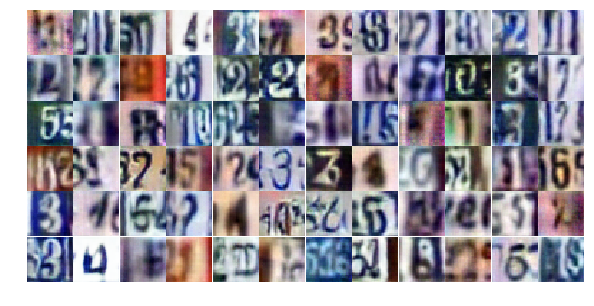

Epoch 20/25... Discriminator Loss: 0.4766... Generator Loss: 1.6290
Epoch 20/25... Discriminator Loss: 0.9761... Generator Loss: 0.7259
Epoch 20/25... Discriminator Loss: 0.3340... Generator Loss: 1.9651
Epoch 20/25... Discriminator Loss: 1.5669... Generator Loss: 0.3821
Epoch 20/25... Discriminator Loss: 0.6645... Generator Loss: 1.1515
Epoch 20/25... Discriminator Loss: 0.5476... Generator Loss: 1.3116
Epoch 20/25... Discriminator Loss: 1.0136... Generator Loss: 0.6544
Epoch 20/25... Discriminator Loss: 1.0329... Generator Loss: 0.7426
Epoch 20/25... Discriminator Loss: 1.2144... Generator Loss: 0.5090
Epoch 20/25... Discriminator Loss: 0.3682... Generator Loss: 1.6563


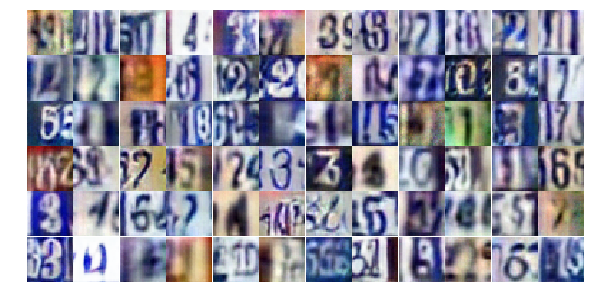

Epoch 20/25... Discriminator Loss: 0.6899... Generator Loss: 1.2061
Epoch 20/25... Discriminator Loss: 0.6169... Generator Loss: 1.0240
Epoch 20/25... Discriminator Loss: 1.4918... Generator Loss: 0.3878
Epoch 20/25... Discriminator Loss: 2.1048... Generator Loss: 1.5032
Epoch 20/25... Discriminator Loss: 1.9900... Generator Loss: 0.3623
Epoch 20/25... Discriminator Loss: 0.7083... Generator Loss: 1.3615
Epoch 20/25... Discriminator Loss: 0.9569... Generator Loss: 0.7949
Epoch 20/25... Discriminator Loss: 0.9006... Generator Loss: 0.8214
Epoch 20/25... Discriminator Loss: 0.5994... Generator Loss: 1.2160
Epoch 20/25... Discriminator Loss: 0.9952... Generator Loss: 0.7341


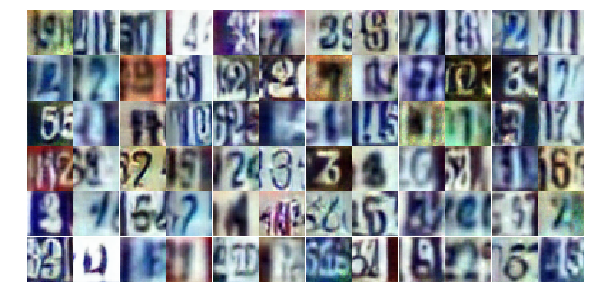

Epoch 20/25... Discriminator Loss: 0.8723... Generator Loss: 0.8322
Epoch 20/25... Discriminator Loss: 1.0364... Generator Loss: 0.7220
Epoch 20/25... Discriminator Loss: 0.4399... Generator Loss: 2.2512
Epoch 20/25... Discriminator Loss: 0.6152... Generator Loss: 1.1535
Epoch 20/25... Discriminator Loss: 0.6140... Generator Loss: 1.2966
Epoch 20/25... Discriminator Loss: 0.9847... Generator Loss: 0.6752
Epoch 20/25... Discriminator Loss: 1.0210... Generator Loss: 0.6784
Epoch 20/25... Discriminator Loss: 0.5764... Generator Loss: 1.0654
Epoch 20/25... Discriminator Loss: 0.7782... Generator Loss: 0.8278
Epoch 20/25... Discriminator Loss: 0.5576... Generator Loss: 1.2567


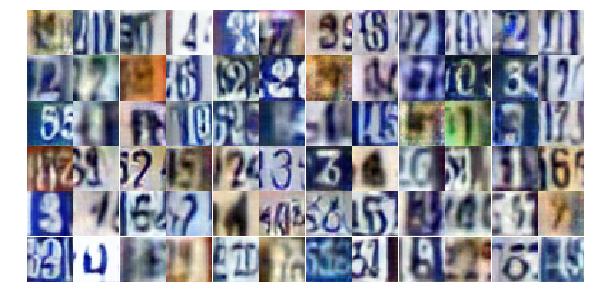

Epoch 20/25... Discriminator Loss: 0.7445... Generator Loss: 0.9114
Epoch 20/25... Discriminator Loss: 0.8605... Generator Loss: 2.6009
Epoch 20/25... Discriminator Loss: 0.4393... Generator Loss: 1.7550
Epoch 20/25... Discriminator Loss: 0.7545... Generator Loss: 1.1230
Epoch 20/25... Discriminator Loss: 0.6720... Generator Loss: 0.9967
Epoch 20/25... Discriminator Loss: 0.6755... Generator Loss: 0.9454
Epoch 21/25... Discriminator Loss: 1.0452... Generator Loss: 0.6460
Epoch 21/25... Discriminator Loss: 1.1853... Generator Loss: 0.4984
Epoch 21/25... Discriminator Loss: 1.2453... Generator Loss: 0.5223
Epoch 21/25... Discriminator Loss: 1.0265... Generator Loss: 0.6257


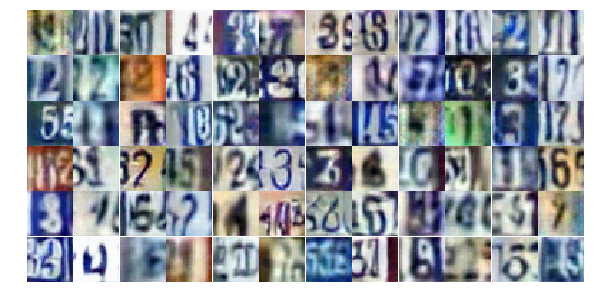

Epoch 21/25... Discriminator Loss: 0.6506... Generator Loss: 1.0812
Epoch 21/25... Discriminator Loss: 1.7627... Generator Loss: 0.2747
Epoch 21/25... Discriminator Loss: 0.6971... Generator Loss: 0.9553
Epoch 21/25... Discriminator Loss: 0.4604... Generator Loss: 1.5393
Epoch 21/25... Discriminator Loss: 0.6050... Generator Loss: 1.1826
Epoch 21/25... Discriminator Loss: 0.5593... Generator Loss: 1.2116
Epoch 21/25... Discriminator Loss: 0.7855... Generator Loss: 0.9068
Epoch 21/25... Discriminator Loss: 0.9112... Generator Loss: 0.7419
Epoch 21/25... Discriminator Loss: 0.4577... Generator Loss: 1.3704
Epoch 21/25... Discriminator Loss: 1.0343... Generator Loss: 0.6920


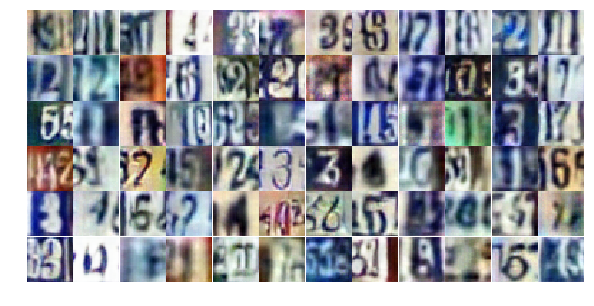

Epoch 21/25... Discriminator Loss: 0.4596... Generator Loss: 1.4551
Epoch 21/25... Discriminator Loss: 0.5536... Generator Loss: 1.2895
Epoch 21/25... Discriminator Loss: 1.6723... Generator Loss: 0.3070
Epoch 21/25... Discriminator Loss: 1.2610... Generator Loss: 0.5501
Epoch 21/25... Discriminator Loss: 0.4995... Generator Loss: 1.4592
Epoch 21/25... Discriminator Loss: 1.1193... Generator Loss: 0.6744
Epoch 21/25... Discriminator Loss: 0.8167... Generator Loss: 0.8567
Epoch 21/25... Discriminator Loss: 0.3680... Generator Loss: 1.7597
Epoch 21/25... Discriminator Loss: 0.6231... Generator Loss: 1.1109
Epoch 21/25... Discriminator Loss: 0.6993... Generator Loss: 0.9792


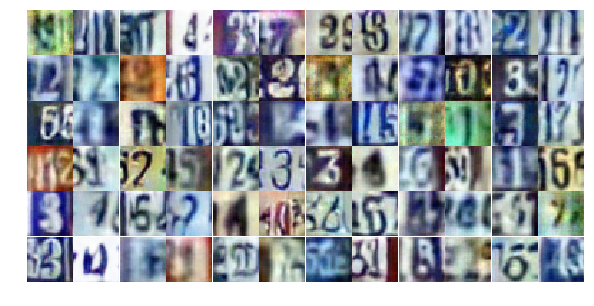

Epoch 21/25... Discriminator Loss: 1.5423... Generator Loss: 0.3515
Epoch 21/25... Discriminator Loss: 0.3770... Generator Loss: 1.6968
Epoch 21/25... Discriminator Loss: 1.9641... Generator Loss: 0.2914
Epoch 21/25... Discriminator Loss: 0.6975... Generator Loss: 1.1102
Epoch 21/25... Discriminator Loss: 0.6716... Generator Loss: 1.2984
Epoch 21/25... Discriminator Loss: 0.8717... Generator Loss: 0.8591
Epoch 21/25... Discriminator Loss: 0.7305... Generator Loss: 0.9957
Epoch 21/25... Discriminator Loss: 0.9244... Generator Loss: 0.7911
Epoch 21/25... Discriminator Loss: 1.1689... Generator Loss: 0.5531
Epoch 21/25... Discriminator Loss: 0.9798... Generator Loss: 0.7240


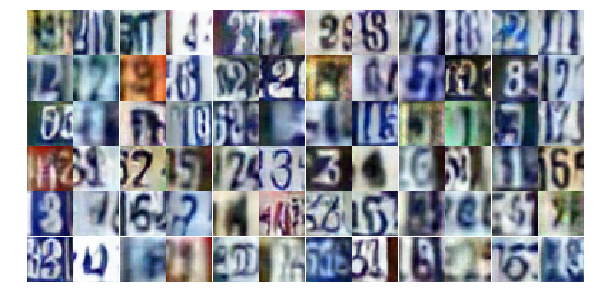

Epoch 21/25... Discriminator Loss: 1.1171... Generator Loss: 0.5994
Epoch 21/25... Discriminator Loss: 0.6937... Generator Loss: 1.0581
Epoch 21/25... Discriminator Loss: 0.8663... Generator Loss: 0.8414
Epoch 21/25... Discriminator Loss: 0.5187... Generator Loss: 1.2961
Epoch 21/25... Discriminator Loss: 0.3708... Generator Loss: 1.6692
Epoch 21/25... Discriminator Loss: 0.7475... Generator Loss: 0.8847
Epoch 21/25... Discriminator Loss: 1.0612... Generator Loss: 0.5982
Epoch 21/25... Discriminator Loss: 1.4678... Generator Loss: 0.4261
Epoch 21/25... Discriminator Loss: 0.9496... Generator Loss: 0.8009
Epoch 21/25... Discriminator Loss: 0.3165... Generator Loss: 2.0186


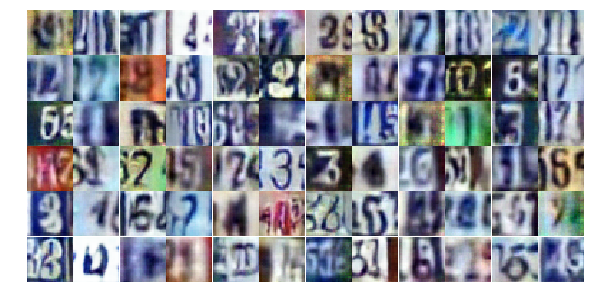

Epoch 21/25... Discriminator Loss: 1.1297... Generator Loss: 0.5564
Epoch 21/25... Discriminator Loss: 1.7865... Generator Loss: 0.3011
Epoch 21/25... Discriminator Loss: 0.8143... Generator Loss: 0.9284
Epoch 21/25... Discriminator Loss: 0.8312... Generator Loss: 0.8432
Epoch 21/25... Discriminator Loss: 0.3291... Generator Loss: 1.9801
Epoch 21/25... Discriminator Loss: 0.7071... Generator Loss: 0.9866
Epoch 21/25... Discriminator Loss: 0.8652... Generator Loss: 0.7981
Epoch 21/25... Discriminator Loss: 1.2544... Generator Loss: 0.6580
Epoch 21/25... Discriminator Loss: 0.9914... Generator Loss: 0.7228
Epoch 21/25... Discriminator Loss: 0.5079... Generator Loss: 1.3015


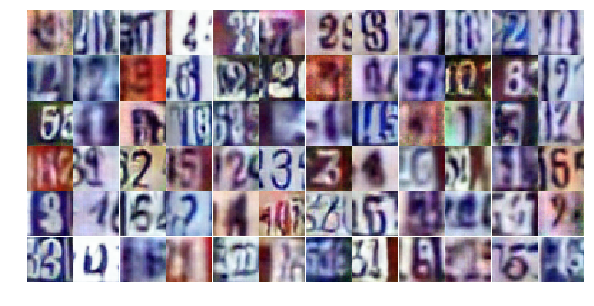

Epoch 21/25... Discriminator Loss: 0.5231... Generator Loss: 1.4299
Epoch 21/25... Discriminator Loss: 1.0677... Generator Loss: 0.6066
Epoch 21/25... Discriminator Loss: 0.7298... Generator Loss: 0.9925
Epoch 22/25... Discriminator Loss: 0.6947... Generator Loss: 1.2645
Epoch 22/25... Discriminator Loss: 0.7562... Generator Loss: 1.1150
Epoch 22/25... Discriminator Loss: 1.4649... Generator Loss: 0.3753
Epoch 22/25... Discriminator Loss: 0.5721... Generator Loss: 1.1412
Epoch 22/25... Discriminator Loss: 0.4298... Generator Loss: 1.4370
Epoch 22/25... Discriminator Loss: 1.3008... Generator Loss: 0.4837
Epoch 22/25... Discriminator Loss: 1.3817... Generator Loss: 0.4242


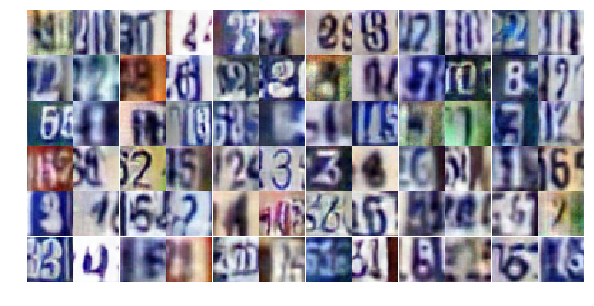

Epoch 22/25... Discriminator Loss: 0.5740... Generator Loss: 1.2855
Epoch 22/25... Discriminator Loss: 0.9389... Generator Loss: 0.8637
Epoch 22/25... Discriminator Loss: 1.5962... Generator Loss: 0.4476
Epoch 22/25... Discriminator Loss: 0.8000... Generator Loss: 0.8092
Epoch 22/25... Discriminator Loss: 0.6666... Generator Loss: 1.1296
Epoch 22/25... Discriminator Loss: 0.5890... Generator Loss: 1.2930
Epoch 22/25... Discriminator Loss: 1.7292... Generator Loss: 0.3475
Epoch 22/25... Discriminator Loss: 0.5596... Generator Loss: 1.6294
Epoch 22/25... Discriminator Loss: 1.1549... Generator Loss: 0.6221
Epoch 22/25... Discriminator Loss: 1.6517... Generator Loss: 0.3127


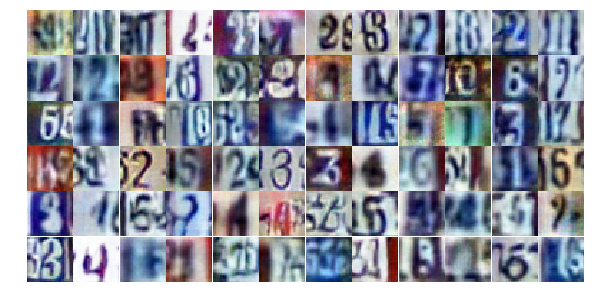

Epoch 22/25... Discriminator Loss: 0.5039... Generator Loss: 1.7657
Epoch 22/25... Discriminator Loss: 0.5701... Generator Loss: 1.2748
Epoch 22/25... Discriminator Loss: 1.0529... Generator Loss: 0.6432
Epoch 22/25... Discriminator Loss: 0.4588... Generator Loss: 1.5472
Epoch 22/25... Discriminator Loss: 0.4638... Generator Loss: 1.6346
Epoch 22/25... Discriminator Loss: 0.6705... Generator Loss: 1.0203
Epoch 22/25... Discriminator Loss: 0.3558... Generator Loss: 1.7440
Epoch 22/25... Discriminator Loss: 0.4448... Generator Loss: 1.7355
Epoch 22/25... Discriminator Loss: 0.5147... Generator Loss: 1.2248
Epoch 22/25... Discriminator Loss: 0.9170... Generator Loss: 0.7255


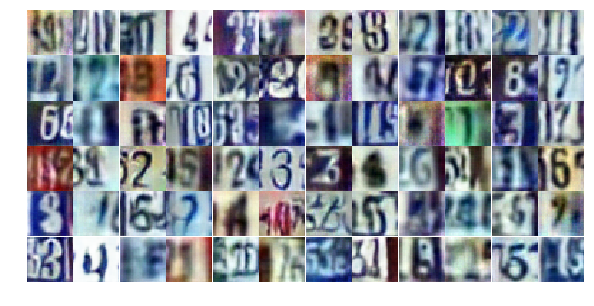

Epoch 22/25... Discriminator Loss: 0.4662... Generator Loss: 1.3013
Epoch 22/25... Discriminator Loss: 0.7631... Generator Loss: 0.9175
Epoch 22/25... Discriminator Loss: 1.0659... Generator Loss: 0.6898
Epoch 22/25... Discriminator Loss: 0.7919... Generator Loss: 0.8447
Epoch 22/25... Discriminator Loss: 0.8929... Generator Loss: 0.8462
Epoch 22/25... Discriminator Loss: 0.9075... Generator Loss: 0.7092
Epoch 22/25... Discriminator Loss: 1.5845... Generator Loss: 0.3872
Epoch 22/25... Discriminator Loss: 1.0255... Generator Loss: 0.6666
Epoch 22/25... Discriminator Loss: 0.8754... Generator Loss: 1.3923
Epoch 22/25... Discriminator Loss: 0.7633... Generator Loss: 1.1213


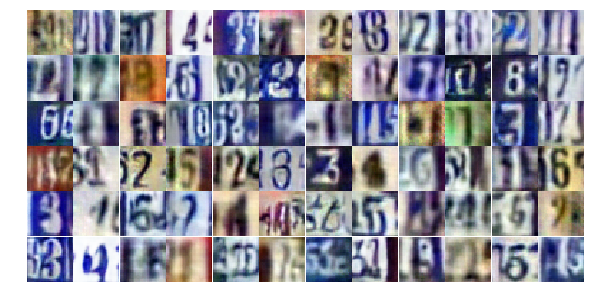

Epoch 22/25... Discriminator Loss: 1.1218... Generator Loss: 0.6225
Epoch 22/25... Discriminator Loss: 0.5232... Generator Loss: 1.5723
Epoch 22/25... Discriminator Loss: 0.3642... Generator Loss: 1.8105
Epoch 22/25... Discriminator Loss: 1.0957... Generator Loss: 0.6882
Epoch 22/25... Discriminator Loss: 0.8135... Generator Loss: 0.8538
Epoch 22/25... Discriminator Loss: 0.5607... Generator Loss: 1.1221
Epoch 22/25... Discriminator Loss: 0.6121... Generator Loss: 1.3319
Epoch 22/25... Discriminator Loss: 0.8300... Generator Loss: 0.8771
Epoch 22/25... Discriminator Loss: 1.3843... Generator Loss: 0.6136
Epoch 22/25... Discriminator Loss: 1.0766... Generator Loss: 0.5913


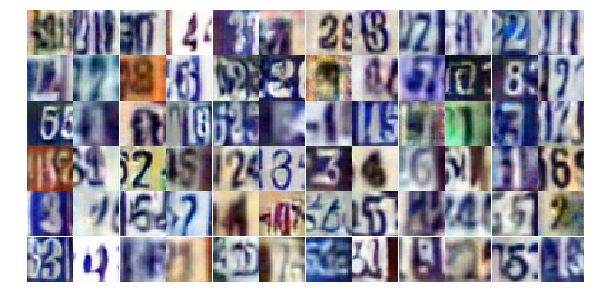

Epoch 22/25... Discriminator Loss: 1.0872... Generator Loss: 0.6143
Epoch 22/25... Discriminator Loss: 0.5996... Generator Loss: 1.5550
Epoch 22/25... Discriminator Loss: 0.7104... Generator Loss: 1.2275
Epoch 22/25... Discriminator Loss: 0.7742... Generator Loss: 1.1145
Epoch 22/25... Discriminator Loss: 0.9623... Generator Loss: 0.7436
Epoch 22/25... Discriminator Loss: 0.8144... Generator Loss: 2.2240
Epoch 22/25... Discriminator Loss: 1.4894... Generator Loss: 0.4330
Epoch 22/25... Discriminator Loss: 0.6991... Generator Loss: 1.0581
Epoch 22/25... Discriminator Loss: 1.0648... Generator Loss: 1.4346
Epoch 22/25... Discriminator Loss: 0.6814... Generator Loss: 1.0155


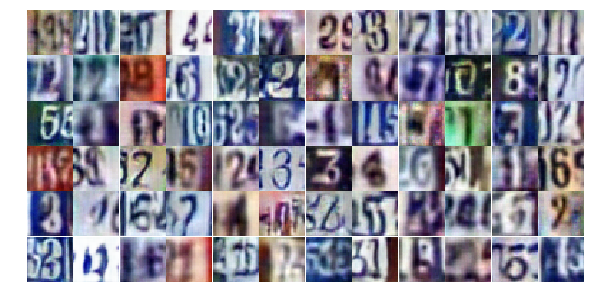

Epoch 23/25... Discriminator Loss: 0.6907... Generator Loss: 1.0028
Epoch 23/25... Discriminator Loss: 0.6005... Generator Loss: 1.0622
Epoch 23/25... Discriminator Loss: 0.8505... Generator Loss: 0.8155
Epoch 23/25... Discriminator Loss: 0.5886... Generator Loss: 1.1203
Epoch 23/25... Discriminator Loss: 0.8880... Generator Loss: 0.7363
Epoch 23/25... Discriminator Loss: 0.8622... Generator Loss: 2.0176
Epoch 23/25... Discriminator Loss: 1.1496... Generator Loss: 0.5654
Epoch 23/25... Discriminator Loss: 0.6348... Generator Loss: 1.0586
Epoch 23/25... Discriminator Loss: 0.7695... Generator Loss: 1.0235
Epoch 23/25... Discriminator Loss: 0.5674... Generator Loss: 1.1613


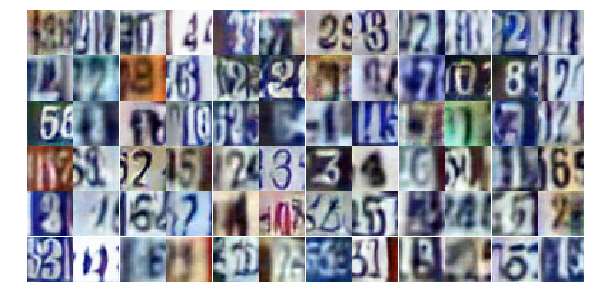

Epoch 23/25... Discriminator Loss: 0.7185... Generator Loss: 0.9544
Epoch 23/25... Discriminator Loss: 0.7854... Generator Loss: 0.8131
Epoch 23/25... Discriminator Loss: 0.6768... Generator Loss: 1.0114
Epoch 23/25... Discriminator Loss: 0.8430... Generator Loss: 0.7945
Epoch 23/25... Discriminator Loss: 0.4744... Generator Loss: 1.4335
Epoch 23/25... Discriminator Loss: 1.1020... Generator Loss: 0.6339
Epoch 23/25... Discriminator Loss: 0.6639... Generator Loss: 1.0688
Epoch 23/25... Discriminator Loss: 1.0852... Generator Loss: 0.8890
Epoch 23/25... Discriminator Loss: 1.8348... Generator Loss: 0.2714
Epoch 23/25... Discriminator Loss: 1.2192... Generator Loss: 0.5839


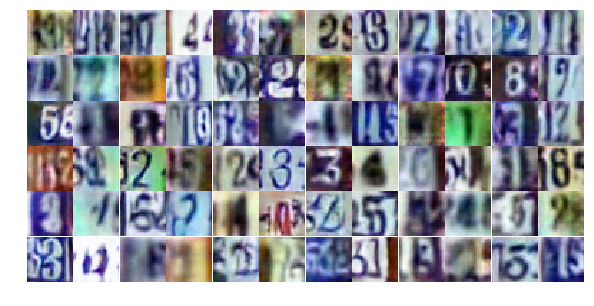

Epoch 23/25... Discriminator Loss: 1.4107... Generator Loss: 0.4281
Epoch 23/25... Discriminator Loss: 0.5137... Generator Loss: 1.4673
Epoch 23/25... Discriminator Loss: 1.5920... Generator Loss: 0.3973
Epoch 23/25... Discriminator Loss: 0.9924... Generator Loss: 0.9305
Epoch 23/25... Discriminator Loss: 0.6882... Generator Loss: 1.0434
Epoch 23/25... Discriminator Loss: 0.8898... Generator Loss: 0.7329
Epoch 23/25... Discriminator Loss: 0.7279... Generator Loss: 0.9084
Epoch 23/25... Discriminator Loss: 0.7491... Generator Loss: 0.9270
Epoch 23/25... Discriminator Loss: 0.5021... Generator Loss: 1.3652
Epoch 23/25... Discriminator Loss: 1.0164... Generator Loss: 0.8323


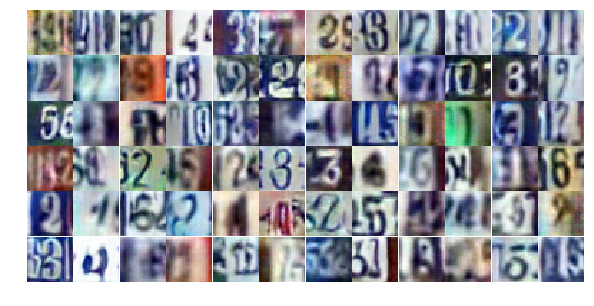

Epoch 23/25... Discriminator Loss: 0.6251... Generator Loss: 1.0445
Epoch 23/25... Discriminator Loss: 0.7120... Generator Loss: 0.9515
Epoch 23/25... Discriminator Loss: 0.5255... Generator Loss: 1.3103
Epoch 23/25... Discriminator Loss: 1.4045... Generator Loss: 0.4294
Epoch 23/25... Discriminator Loss: 2.2716... Generator Loss: 4.2952
Epoch 23/25... Discriminator Loss: 7.4203... Generator Loss: 0.0575
Epoch 23/25... Discriminator Loss: 2.7372... Generator Loss: 0.1729
Epoch 23/25... Discriminator Loss: 0.9736... Generator Loss: 3.4009
Epoch 23/25... Discriminator Loss: 0.6565... Generator Loss: 1.5663
Epoch 23/25... Discriminator Loss: 0.5918... Generator Loss: 1.1952


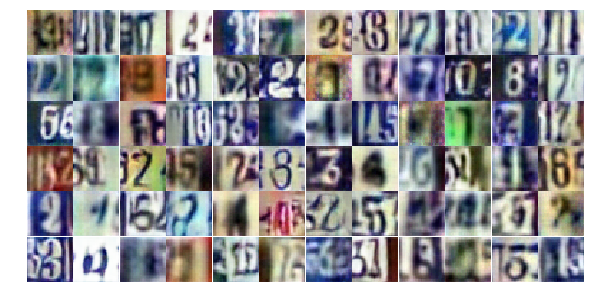

Epoch 23/25... Discriminator Loss: 0.8267... Generator Loss: 1.0815
Epoch 23/25... Discriminator Loss: 0.8504... Generator Loss: 0.9536
Epoch 23/25... Discriminator Loss: 1.6539... Generator Loss: 0.3750
Epoch 23/25... Discriminator Loss: 0.8593... Generator Loss: 0.8880
Epoch 23/25... Discriminator Loss: 0.8757... Generator Loss: 0.9953
Epoch 23/25... Discriminator Loss: 0.8220... Generator Loss: 0.9666
Epoch 23/25... Discriminator Loss: 0.7910... Generator Loss: 0.9665
Epoch 23/25... Discriminator Loss: 1.2418... Generator Loss: 0.6011
Epoch 23/25... Discriminator Loss: 0.6502... Generator Loss: 1.1392
Epoch 23/25... Discriminator Loss: 0.7494... Generator Loss: 0.9663


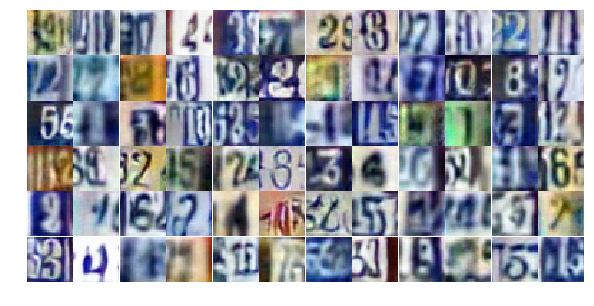

Epoch 23/25... Discriminator Loss: 0.8078... Generator Loss: 0.9361
Epoch 23/25... Discriminator Loss: 0.8764... Generator Loss: 0.7971
Epoch 23/25... Discriminator Loss: 0.9553... Generator Loss: 0.7038
Epoch 23/25... Discriminator Loss: 0.3457... Generator Loss: 1.8424
Epoch 23/25... Discriminator Loss: 1.1927... Generator Loss: 0.5893
Epoch 23/25... Discriminator Loss: 0.7342... Generator Loss: 1.1436
Epoch 23/25... Discriminator Loss: 0.8271... Generator Loss: 0.8046
Epoch 24/25... Discriminator Loss: 0.8428... Generator Loss: 0.8933
Epoch 24/25... Discriminator Loss: 0.8158... Generator Loss: 0.8815
Epoch 24/25... Discriminator Loss: 1.1499... Generator Loss: 0.6169


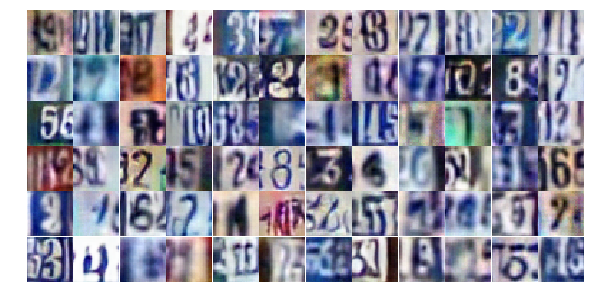

Epoch 24/25... Discriminator Loss: 0.5673... Generator Loss: 1.3122
Epoch 24/25... Discriminator Loss: 0.6678... Generator Loss: 1.0136
Epoch 24/25... Discriminator Loss: 0.6725... Generator Loss: 1.0389
Epoch 24/25... Discriminator Loss: 0.9688... Generator Loss: 0.8830
Epoch 24/25... Discriminator Loss: 0.6588... Generator Loss: 1.0673
Epoch 24/25... Discriminator Loss: 0.4824... Generator Loss: 1.5607
Epoch 24/25... Discriminator Loss: 0.7673... Generator Loss: 0.9910
Epoch 24/25... Discriminator Loss: 1.0691... Generator Loss: 0.6622
Epoch 24/25... Discriminator Loss: 0.4691... Generator Loss: 1.3850
Epoch 24/25... Discriminator Loss: 0.5571... Generator Loss: 1.1749


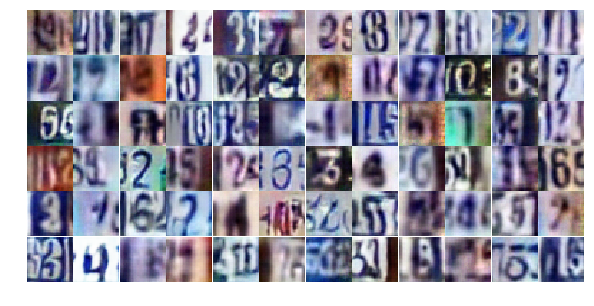

Epoch 24/25... Discriminator Loss: 1.4910... Generator Loss: 0.3681
Epoch 24/25... Discriminator Loss: 1.1407... Generator Loss: 0.5468
Epoch 24/25... Discriminator Loss: 1.2698... Generator Loss: 0.5205
Epoch 24/25... Discriminator Loss: 1.0671... Generator Loss: 0.5817
Epoch 24/25... Discriminator Loss: 0.6225... Generator Loss: 2.0765
Epoch 24/25... Discriminator Loss: 1.1487... Generator Loss: 0.5425
Epoch 24/25... Discriminator Loss: 0.3440... Generator Loss: 2.0025
Epoch 24/25... Discriminator Loss: 1.0473... Generator Loss: 0.6400
Epoch 24/25... Discriminator Loss: 1.1863... Generator Loss: 0.5923
Epoch 24/25... Discriminator Loss: 1.3506... Generator Loss: 0.5177


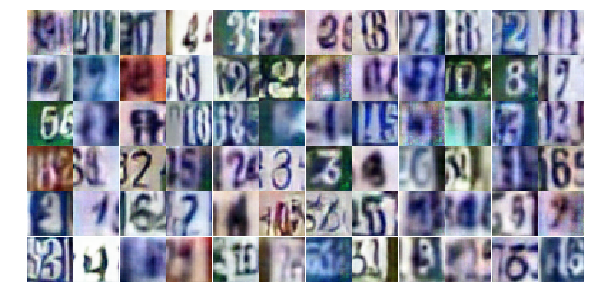

Epoch 24/25... Discriminator Loss: 0.8385... Generator Loss: 0.8839
Epoch 24/25... Discriminator Loss: 0.7240... Generator Loss: 0.9776
Epoch 24/25... Discriminator Loss: 0.4315... Generator Loss: 1.7824
Epoch 24/25... Discriminator Loss: 1.4530... Generator Loss: 0.4547
Epoch 24/25... Discriminator Loss: 0.9878... Generator Loss: 0.7468
Epoch 24/25... Discriminator Loss: 0.5169... Generator Loss: 2.1852
Epoch 24/25... Discriminator Loss: 0.9089... Generator Loss: 0.8066
Epoch 24/25... Discriminator Loss: 0.7124... Generator Loss: 1.1311
Epoch 24/25... Discriminator Loss: 0.6721... Generator Loss: 1.0822
Epoch 24/25... Discriminator Loss: 1.1946... Generator Loss: 0.5593


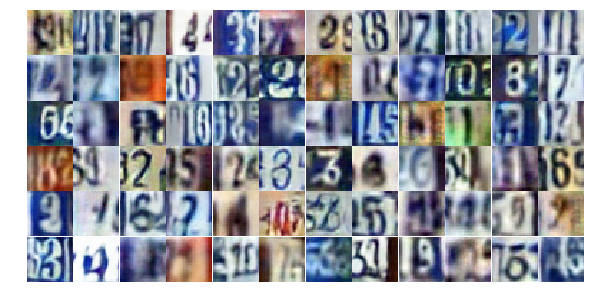

Epoch 24/25... Discriminator Loss: 0.5122... Generator Loss: 1.5168
Epoch 24/25... Discriminator Loss: 0.8639... Generator Loss: 0.7634
Epoch 24/25... Discriminator Loss: 0.9394... Generator Loss: 0.8109
Epoch 24/25... Discriminator Loss: 1.8899... Generator Loss: 0.2400
Epoch 24/25... Discriminator Loss: 0.9617... Generator Loss: 0.7189
Epoch 24/25... Discriminator Loss: 0.9424... Generator Loss: 0.7029
Epoch 24/25... Discriminator Loss: 0.9161... Generator Loss: 0.8029
Epoch 24/25... Discriminator Loss: 1.2752... Generator Loss: 0.4681
Epoch 24/25... Discriminator Loss: 1.0861... Generator Loss: 0.6082
Epoch 24/25... Discriminator Loss: 0.6066... Generator Loss: 1.5196


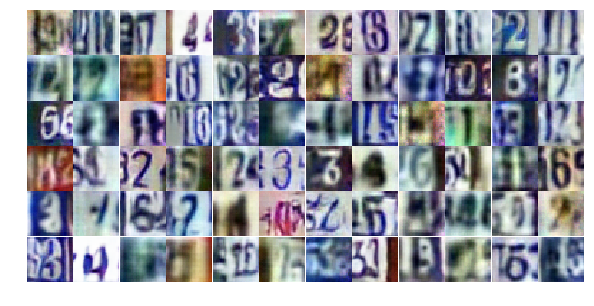

Epoch 24/25... Discriminator Loss: 0.8393... Generator Loss: 0.7628
Epoch 24/25... Discriminator Loss: 0.7114... Generator Loss: 1.2117
Epoch 24/25... Discriminator Loss: 0.7926... Generator Loss: 1.6797
Epoch 24/25... Discriminator Loss: 1.0940... Generator Loss: 0.8048
Epoch 24/25... Discriminator Loss: 1.3194... Generator Loss: 0.4838
Epoch 24/25... Discriminator Loss: 0.7091... Generator Loss: 1.1154
Epoch 24/25... Discriminator Loss: 0.7751... Generator Loss: 0.9475
Epoch 24/25... Discriminator Loss: 0.8803... Generator Loss: 0.7627
Epoch 24/25... Discriminator Loss: 0.7855... Generator Loss: 1.6771
Epoch 24/25... Discriminator Loss: 0.9270... Generator Loss: 0.7616


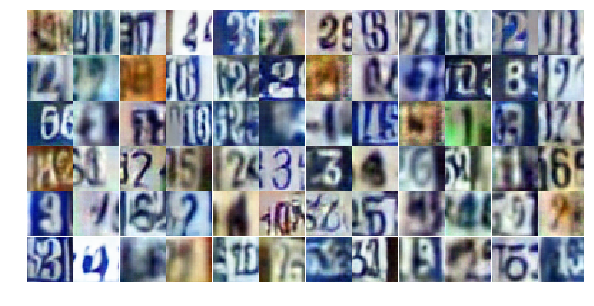

Epoch 24/25... Discriminator Loss: 0.7803... Generator Loss: 0.9399
Epoch 24/25... Discriminator Loss: 1.3086... Generator Loss: 0.4757
Epoch 24/25... Discriminator Loss: 1.7385... Generator Loss: 0.3344
Epoch 24/25... Discriminator Loss: 0.7316... Generator Loss: 1.8702
Epoch 24/25... Discriminator Loss: 0.8599... Generator Loss: 0.9226
Epoch 25/25... Discriminator Loss: 0.8750... Generator Loss: 0.9799
Epoch 25/25... Discriminator Loss: 0.4800... Generator Loss: 2.2463
Epoch 25/25... Discriminator Loss: 0.8805... Generator Loss: 0.7774
Epoch 25/25... Discriminator Loss: 0.9817... Generator Loss: 0.6477
Epoch 25/25... Discriminator Loss: 1.0250... Generator Loss: 0.7311


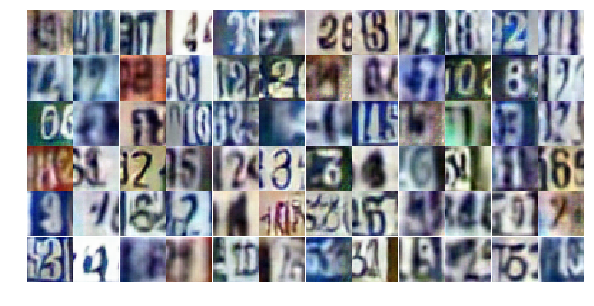

Epoch 25/25... Discriminator Loss: 1.1998... Generator Loss: 0.5822
Epoch 25/25... Discriminator Loss: 0.9618... Generator Loss: 0.8137
Epoch 25/25... Discriminator Loss: 0.5578... Generator Loss: 1.2703
Epoch 25/25... Discriminator Loss: 0.7800... Generator Loss: 0.9537
Epoch 25/25... Discriminator Loss: 0.6848... Generator Loss: 1.5578
Epoch 25/25... Discriminator Loss: 0.7503... Generator Loss: 0.9967
Epoch 25/25... Discriminator Loss: 0.8866... Generator Loss: 0.8952
Epoch 25/25... Discriminator Loss: 1.3832... Generator Loss: 0.3928
Epoch 25/25... Discriminator Loss: 0.4062... Generator Loss: 1.5976
Epoch 25/25... Discriminator Loss: 1.8722... Generator Loss: 0.2612


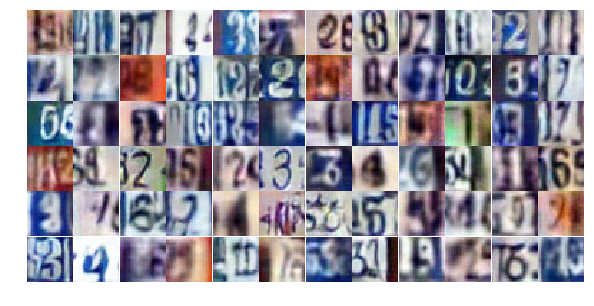

Epoch 25/25... Discriminator Loss: 1.4672... Generator Loss: 2.3825
Epoch 25/25... Discriminator Loss: 0.5012... Generator Loss: 2.7336
Epoch 25/25... Discriminator Loss: 0.8133... Generator Loss: 0.9644
Epoch 25/25... Discriminator Loss: 1.0988... Generator Loss: 0.6321
Epoch 25/25... Discriminator Loss: 0.8796... Generator Loss: 0.8121
Epoch 25/25... Discriminator Loss: 0.5181... Generator Loss: 1.3670
Epoch 25/25... Discriminator Loss: 0.7430... Generator Loss: 1.0074
Epoch 25/25... Discriminator Loss: 1.3485... Generator Loss: 0.4968
Epoch 25/25... Discriminator Loss: 0.6363... Generator Loss: 1.1256
Epoch 25/25... Discriminator Loss: 0.7493... Generator Loss: 0.9414


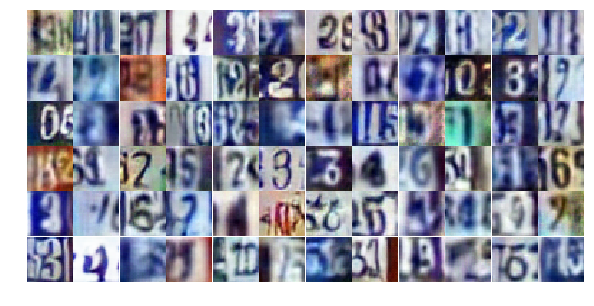

Epoch 25/25... Discriminator Loss: 1.1922... Generator Loss: 0.5758
Epoch 25/25... Discriminator Loss: 0.6381... Generator Loss: 1.0716
Epoch 25/25... Discriminator Loss: 1.6785... Generator Loss: 0.3996
Epoch 25/25... Discriminator Loss: 0.9668... Generator Loss: 0.8156
Epoch 25/25... Discriminator Loss: 0.8720... Generator Loss: 0.8682
Epoch 25/25... Discriminator Loss: 0.8079... Generator Loss: 0.7885
Epoch 25/25... Discriminator Loss: 0.7461... Generator Loss: 0.9583
Epoch 25/25... Discriminator Loss: 1.0758... Generator Loss: 0.6368
Epoch 25/25... Discriminator Loss: 0.7526... Generator Loss: 1.1540
Epoch 25/25... Discriminator Loss: 0.8168... Generator Loss: 1.1631


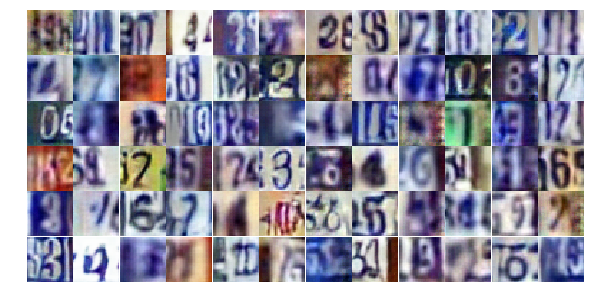

Epoch 25/25... Discriminator Loss: 0.9400... Generator Loss: 0.9170
Epoch 25/25... Discriminator Loss: 0.6482... Generator Loss: 1.1654
Epoch 25/25... Discriminator Loss: 1.1353... Generator Loss: 0.5525
Epoch 25/25... Discriminator Loss: 0.7304... Generator Loss: 0.9457
Epoch 25/25... Discriminator Loss: 1.0141... Generator Loss: 0.6062
Epoch 25/25... Discriminator Loss: 0.8840... Generator Loss: 0.7805
Epoch 25/25... Discriminator Loss: 0.7038... Generator Loss: 0.9603
Epoch 25/25... Discriminator Loss: 0.5764... Generator Loss: 1.1800
Epoch 25/25... Discriminator Loss: 1.8748... Generator Loss: 0.3168
Epoch 25/25... Discriminator Loss: 0.6348... Generator Loss: 1.1918


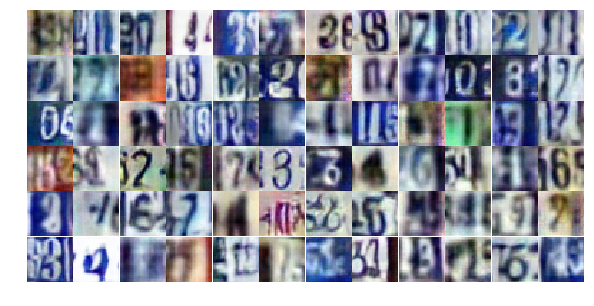

Epoch 25/25... Discriminator Loss: 0.8131... Generator Loss: 0.9453
Epoch 25/25... Discriminator Loss: 0.5716... Generator Loss: 1.1970
Epoch 25/25... Discriminator Loss: 0.6713... Generator Loss: 1.4317
Epoch 25/25... Discriminator Loss: 1.2071... Generator Loss: 0.5309
Epoch 25/25... Discriminator Loss: 0.8664... Generator Loss: 0.8714
Epoch 25/25... Discriminator Loss: 0.5906... Generator Loss: 1.3414
Epoch 25/25... Discriminator Loss: 1.3752... Generator Loss: 0.5516
Epoch 25/25... Discriminator Loss: 0.4741... Generator Loss: 1.4108
Epoch 25/25... Discriminator Loss: 0.6457... Generator Loss: 1.0805
Epoch 25/25... Discriminator Loss: 0.7732... Generator Loss: 1.0825


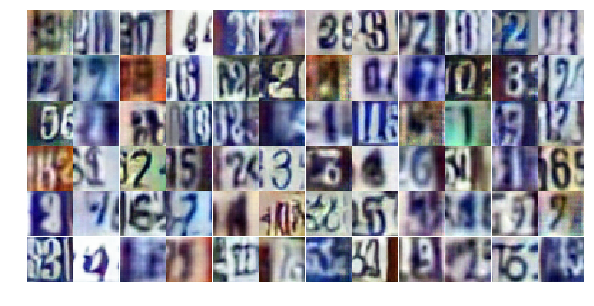

Epoch 25/25... Discriminator Loss: 0.3633... Generator Loss: 1.6429
Epoch 25/25... Discriminator Loss: 1.3431... Generator Loss: 0.4147


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

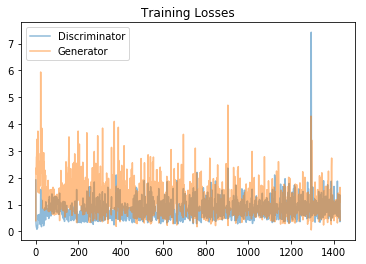

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/home/hasush/pythonEnvs/tensorflow/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


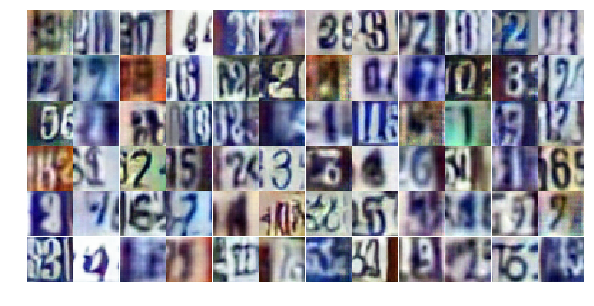

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))